In [2]:
# Import packages to use
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import os,sys
import re
import pickle
from scipy.stats import circstd
from scipy.stats import circmean
from scipy.stats import chisquare
mpl.rcParams['mathtext.fontset'] = 'stix'
mpl.rcParams['font.family'] = 'STIXGeneral'
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from scipy.stats import chisquare
from scipy.stats import chi2
import statsmodels.api as sm

In [3]:
import os
print(os.getcwd())

/Volumes/FNAL-Recycler/11042022_hvpings_space 3/horizontal


In [4]:
def chisquare_var(yobs, yfit, syvar, fitted_params = 0):
    """
    Function that returns the chi-squared statistics for goodness of fit for observed data against data from a model/fit
    yobs: Array with observed/experimental data points
    yfit: Aray with fitted/modelled points
    sysigma: Array or float with standard deviation uncertainty for observed/experimental values
    fitted_params: Number of free parameters used to fit function/model
    """
    part1 = np.square(yobs-yfit)
    chi2 = np.sum(np.divide(part1, np.square(syvar)))
    
    nu = len(yobs)-fitted_params-1
    
    return chi2, chi2/nu, nu

In [5]:
# Load the entire sextupole kicks dataframe
df3all = pd.read_csv("h3000all.csv")
df3all = df3all.dropna()
h3000total = pd.read_csv("h3000totalkick.csv")
h3000bare = pd.read_csv("h3000baremachine.csv")
hsext = pd.read_csv("h3000sextkick.csv")

In [6]:
# Define BPMs to analyze for sextupole kick vs current relation
bpmstoanalyze = np.unique(hsext['bpm'])

# Create folders and currents to cycle through
folders = ['sc220', 'sc222', 'sc319', 'sc321']
currents = np.unique(df3all['sext-current'])

In [8]:
# Original linear fit with R^2 linear score and chi2 score
worthy = []

for bpmi in bpmstoanalyze:
    
    i=0
    
    for sc in folders:
        
        dfplot = hsext[(hsext['sext'] == sc) & (hsext['bpm'] == bpmi)]
        currents = np.unique(dfplot['sext-current'])
        currentsfull = np.unique(dfplot['sext-current'])
        
        currlimlow = -7
        currlimhigh = 7
        currents = currentsfull[[i<currlimhigh for i in currentsfull]]
        currents = currents[[i>currlimlow for i in currents]]
        
        maski = [(i<currlimhigh)*(i>currlimlow) for i in currentsfull]
        
        # Start of plots
        # -----------------------------------------------------------------------------
        # -----------------------------------------------------------------------------
        
        fig,(ax1,ax2) = plt.subplots(1,2, figsize=(16,7), sharey = True)

        # Plot for real part of sextupole kick
        ax1.errorbar(currentsfull, dfplot['real'], yerr = np.divide(dfplot['real-std'],np.sqrt(dfplot['vectors'])), 
                     fmt = 'o', color = 'green', label = 'Data')
        
        # Calculate R2 of regression
        xdata1 = np.array(currents).reshape(-1,1)
        ydata1 = dfplot[maski]['real']
        reg1 = LinearRegression().fit(xdata1,ydata1)
        xplot1 = np.linspace(min(currents)-1,max(currents)+1).reshape(-1,1) 
        r2score1 = reg1.score(xdata1, ydata1)
        
        # Calculate Chi2 of linear regression
        chi2_1, redchi2_1, nu1 = chisquare_var(yobs = ydata1, yfit = reg1.predict(xdata1), 
                                        syvar = np.divide(dfplot['real-std'],np.sqrt(dfplot['vectors'])), 
                                        fitted_params = 2)
        
        alpha = 0.15
        
        redchi2alpha1 = chi2.ppf(1-alpha,nu1)/nu1
        #print(chi2.ppf(1-alpha,nu1)/nu1)
        #print(chi2_1, redchi2_1, nu1)
        
        # Plot data and linear regression
        ax1.plot(xplot1, reg1.predict(xplot1), color = 'red', linestyle = 'dashed', 
                 label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
        
        ax1.tick_params(axis='x', labelsize = 22)
        ax1.tick_params(axis='y', labelsize = 22)
        ax1.set_title('Sextupole kick for %s'%bpmi, fontsize = 26)
        ax1.set_ylabel(r'$|h^{(sext)}_{3000}| \; \cos \; \psi^{(sext)}_{3000} $ [m$^{-1/2}$]', fontsize = 30)
        ax1.set_xlabel('%s Current [A]'%sc, fontsize = 26)
        ax1.legend(fontsize = 20)
        
        # -----------------------------------------------------------------------------
        
        # Plot for imaginary part of sextupole kick
        ax2.errorbar(currentsfull, dfplot['imag'], yerr =  np.divide(dfplot['imag-std'],np.sqrt(dfplot['vectors'])), 
                     fmt = 'o', color = 'blue', label = 'Data')
        
        xdata2 = np.array(currents).reshape(-1,1)
        ydata2 = dfplot[maski]['imag']
        reg2 = LinearRegression().fit(xdata2,ydata2)
        xplot2 = np.linspace(min(currents)-1,max(currents)+1).reshape(-1,1)
        r2score2 = reg2.score(xdata2, ydata2)
        
        # Calculate Chi2 of linear regression
        chi2_2, redchi2_2, nu2 = chisquare_var(yobs = ydata2, yfit = reg2.predict(xdata2), 
                                        syvar = np.divide(dfplot['imag-std'],np.sqrt(dfplot['vectors'])), 
                                        fitted_params = 2)
        
        redchi2alpha2 = chi2.ppf(1-alpha,nu2)/nu2
        #print(chi2.ppf(1-alpha,nu2)/nu2)
        #print(chi2_2, redchi2_2, nu2)
        
        ax2.plot(xplot2, reg2.predict(xplot2), color = 'red', linestyle = 'dashed', 
                 label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
        
        ax2.tick_params(axis='x', labelsize = 22)
        ax2.tick_params(axis='y', labelsize = 22)
        ax2.set_title('Sextupole kick for %s'%bpmi, fontsize = 26)
        ax2.set_ylabel(r'$|h^{(sext)}_{3000}| \; \sin \; \psi^{(sext)}_{3000} $ [m$^{-1/2}$]', fontsize = 30)
        ax2.set_xlabel('%s Current [A]'%sc, fontsize = 26)
        ax2.legend(fontsize = 20)
        
        try:
            os.makedirs(sc+'/hsext-vs-I')
        except:
            #print('Directory already exists')
            pass
        
        fig.patch.set_facecolor('white')
        plt.tight_layout()
        
        if (redchi2_1<redchi2alpha1) and (redchi2_2<redchi2alpha2):
            if (r2score1>0.5) and (r2score2>0.5):
                    #print(chi2.ppf(1-alpha,nu1)/nu1)
                    #print(chi2_1, redchi2_1, nu1)
                    
                    #print(chi2.ppf(1-alpha,nu2)/nu2)
                    #print(chi2_2, redchi2_2, nu2)
                    
                    i = i+1
                    
                    #plt.show()
        
        #plt.show()
        #if bpmi=='R:HP622':
            #plt.show()
            #plt.savefig(sc+'/hsext-vs-I/hsext-vs-I-%s-%s'%(sc,bpmi[-5:]))
            
        #plt.savefig(sc+'/hsext-vs-I/hsext-vs-I-%s-%s'%(sc,bpmi[-5:]))
        plt.close()
        
        #break
    if i > 2:
        worthy.append(bpmi)
        print(bpmi)

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP106
R:HP108


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP110


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP114


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP116


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP126
R:HP128


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP130


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP204
R:HP206


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP216
R:HP218


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP226


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP232


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP304


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP308
R:HP310


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP312


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP318
R:HP320


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP330
R:HP332


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP406
R:HP408


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP410


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP424
R:HP426


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP512


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP610
R:HP612


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP614
R:HP616


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP618
R:HP620


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP624


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP628
R:HP630


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP632


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

R:HP640


/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg1.coef_,reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:82: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(reg2.coef_,reg2.intercept_, r2score2, redchi2_2))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/3176240242.py:51: DeprecationWarning: Conversion of an array with ndim > 0 to 

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


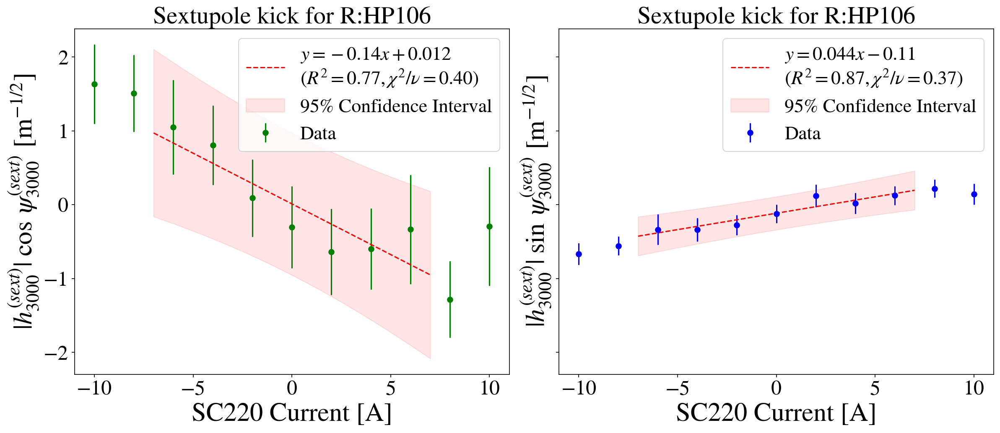

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.8735094306202132 0.2183773576550533 4
2.3719322591952885
0.6156721340877467 0.15391803352193667 4


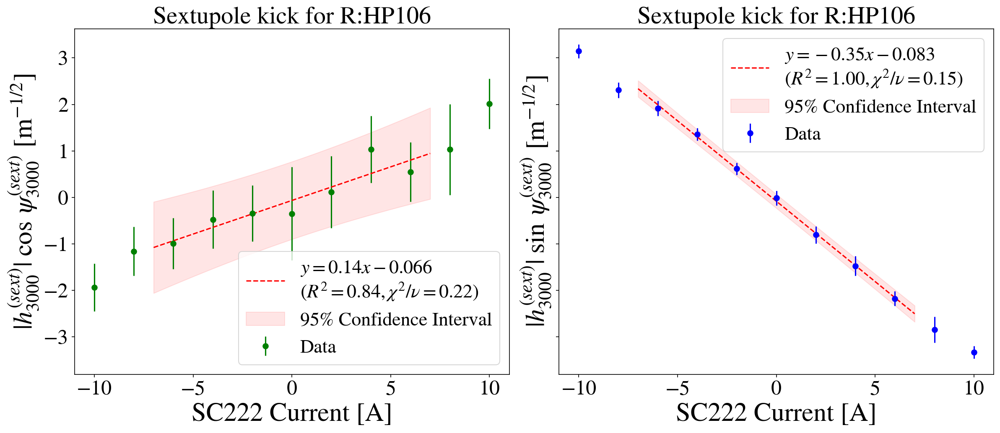

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.9908821925327282 0.24772054813318206 4
2.3719322591952885
4.372789356003295 1.0931973390008238 4


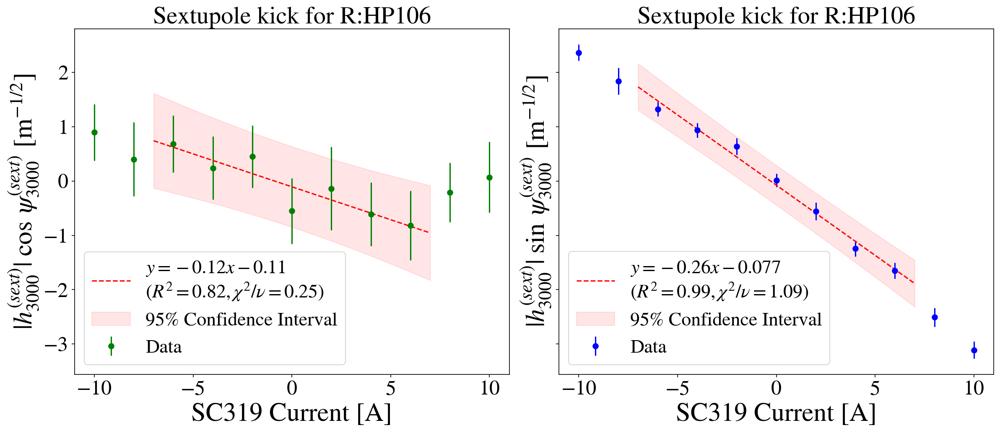

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


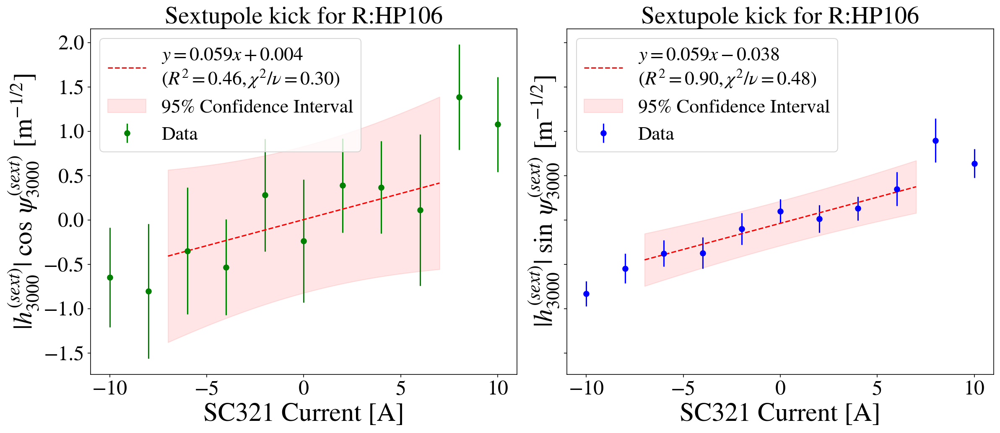

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


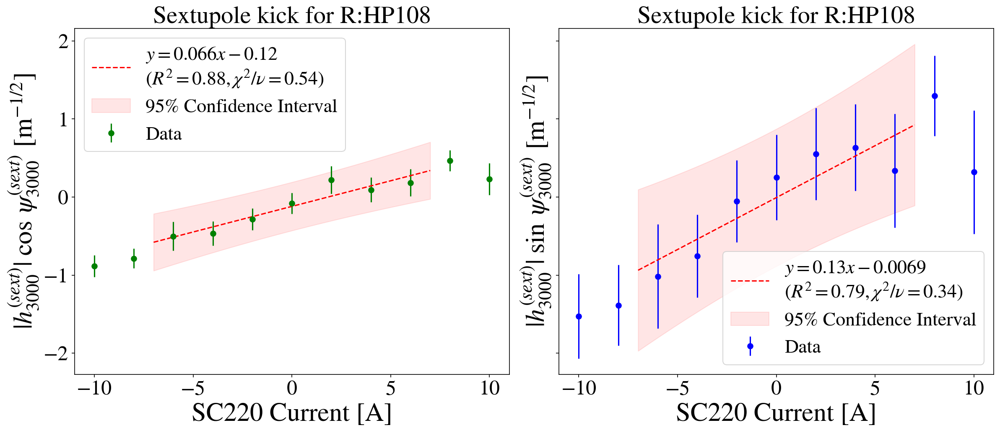

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


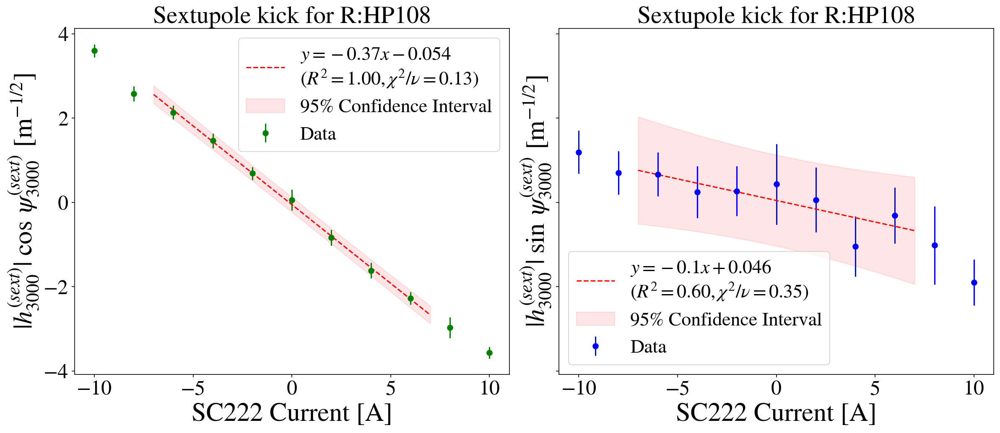

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
3.6977711701495553 0.9244427925373888 4
2.3719322591952885
0.8373378621075039 0.20933446552687598 4


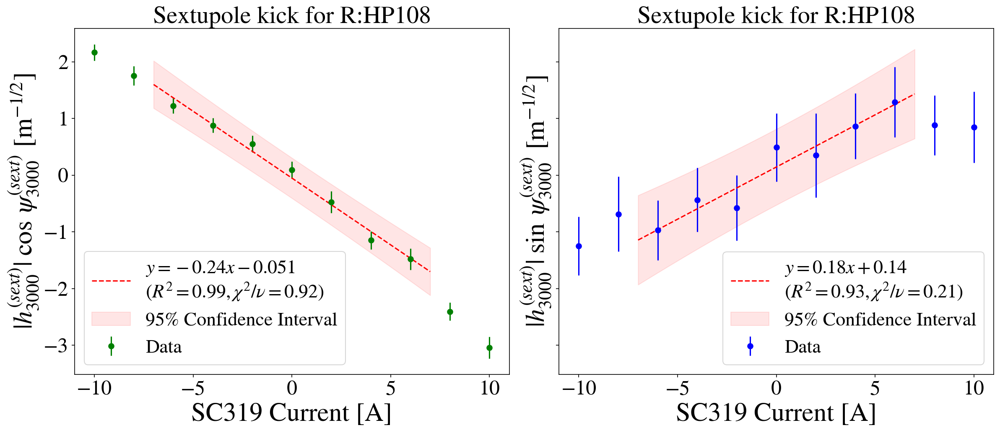

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


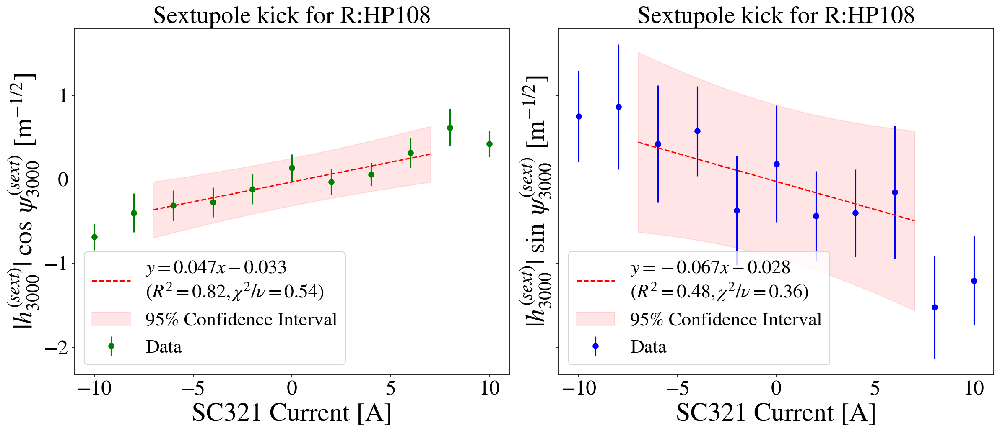

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


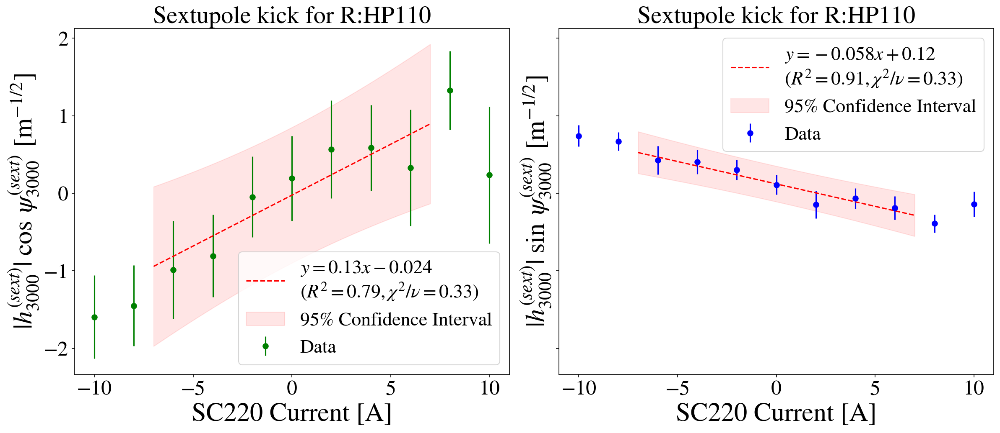

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


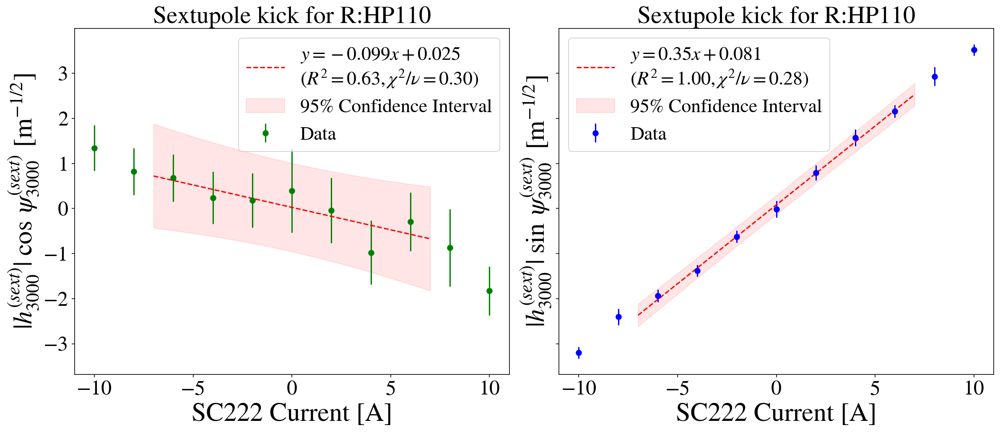

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.0454177320070122 0.26135443300175304 4
2.3719322591952885
4.1113413819166755 1.0278353454791689 4


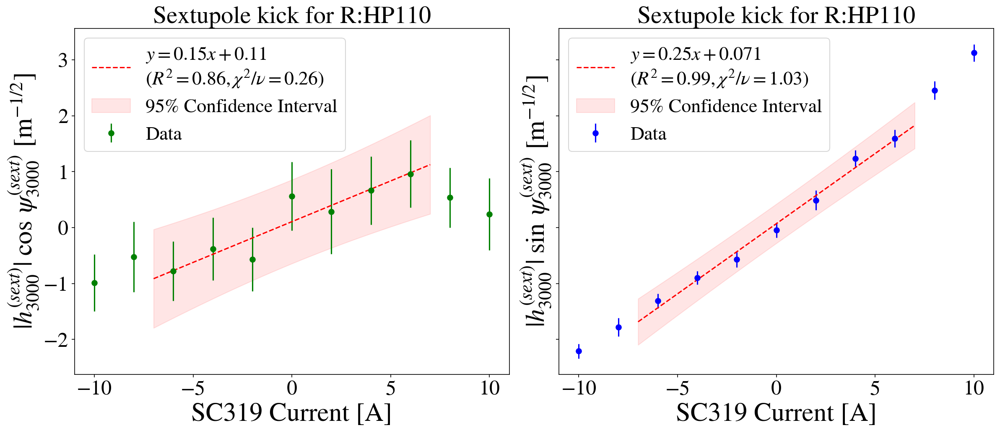

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


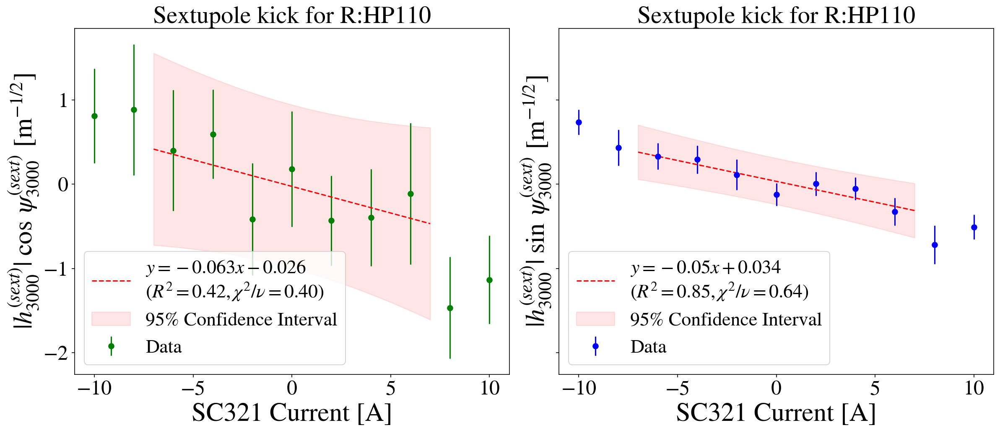

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


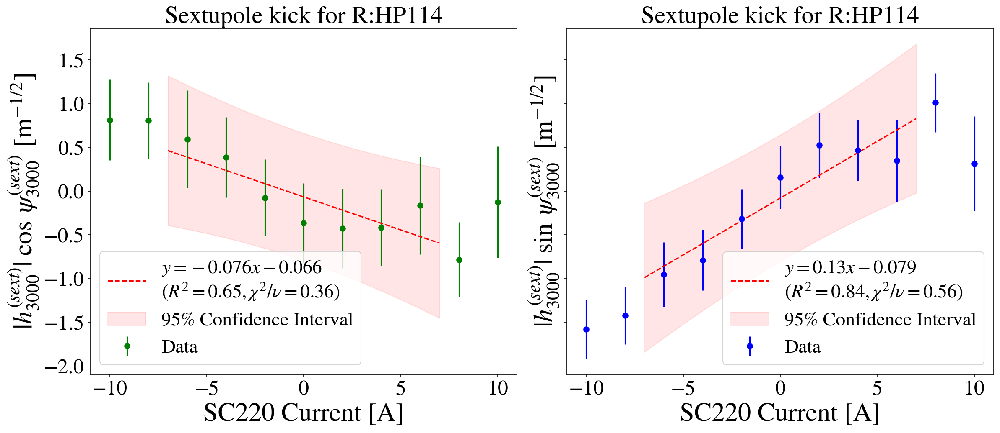

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.5991091974880216 0.1497772993720054 4
2.3719322591952885
0.847497479497634 0.2118743698744085 4


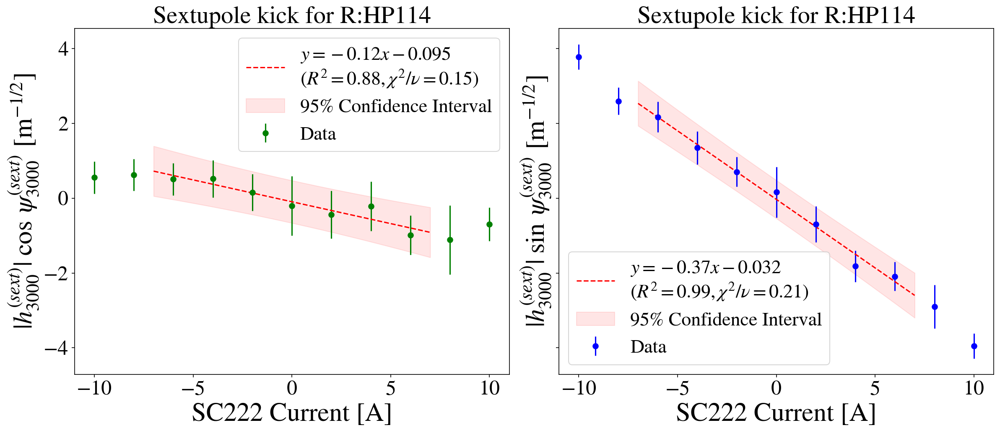

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.3026646457241222 0.32566616143103055 4
2.3719322591952885
1.536142207310624 0.384035551827656 4


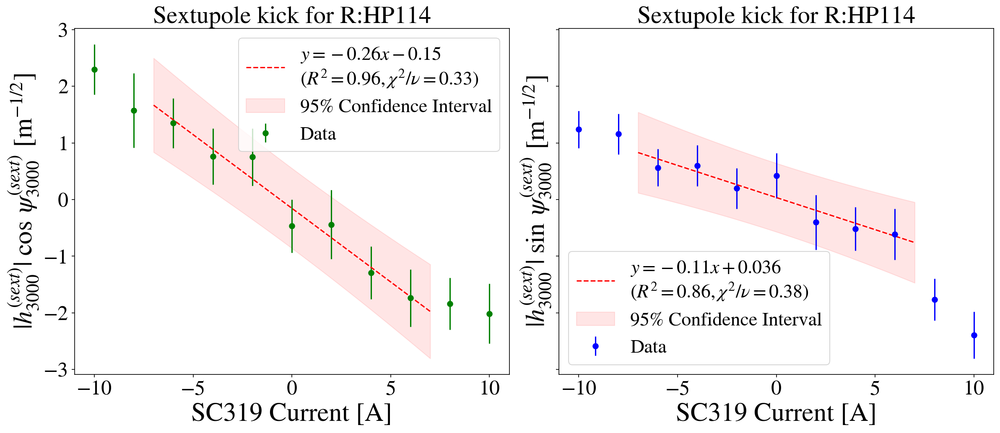

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


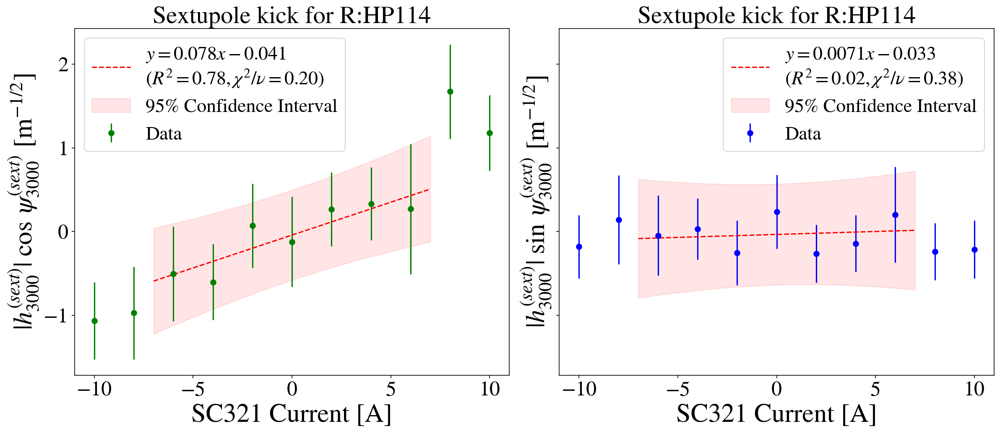

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


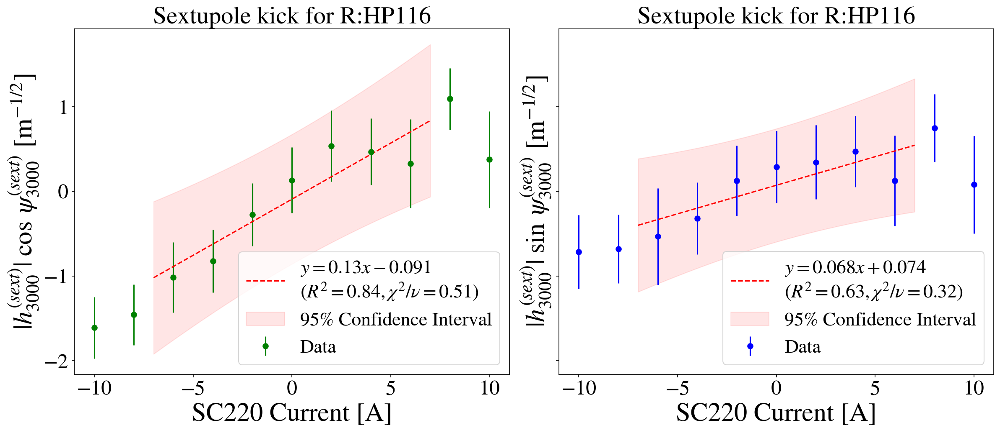

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.3907553115263949 0.3476888278815987 4
2.3719322591952885
1.2582610391765303 0.3145652597941326 4


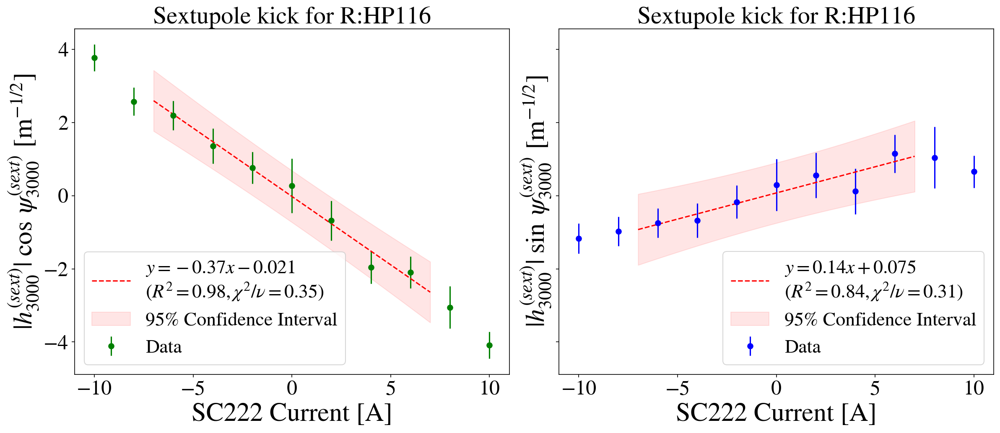

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.9404671824201862 0.23511679560504656 4
2.3719322591952885
1.162040948847394 0.2905102372118485 4


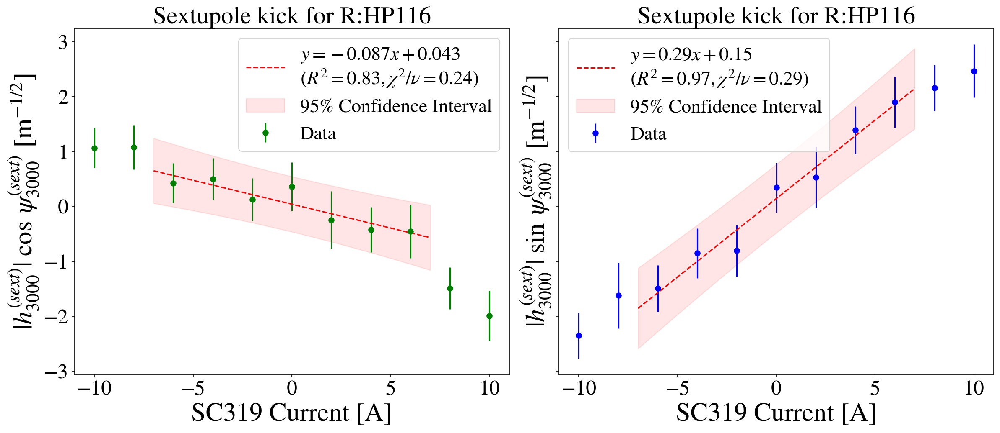

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


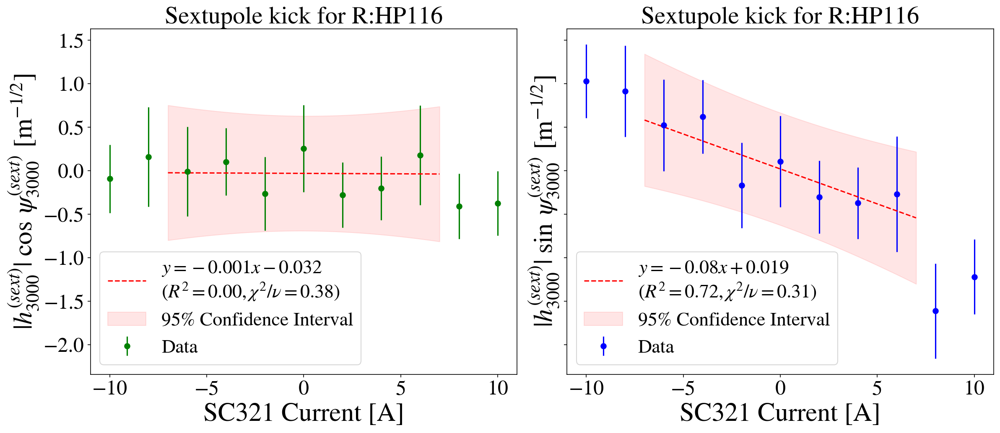

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.5112956669400404 0.3778239167350101 4
2.3719322591952885
1.3220002417659789 0.3305000604414947 4


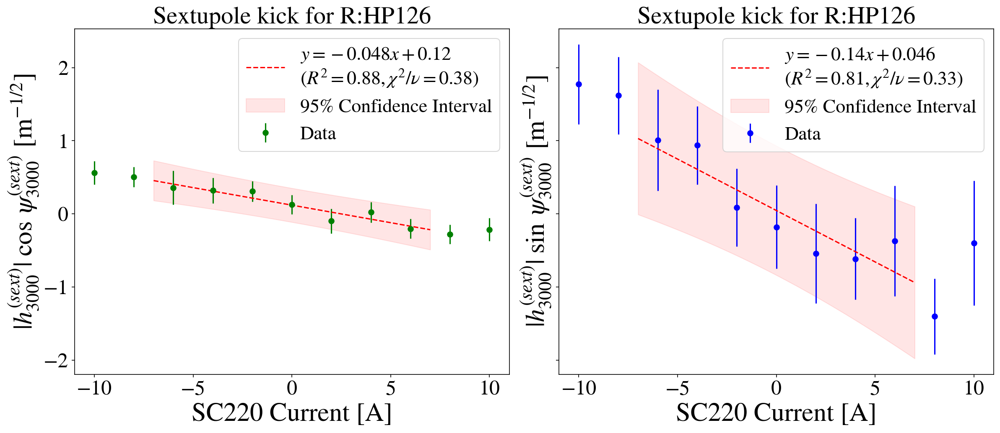

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.3321900127691972 0.3330475031922993 4
2.3719322591952885
1.0881834098368774 0.27204585245921936 4


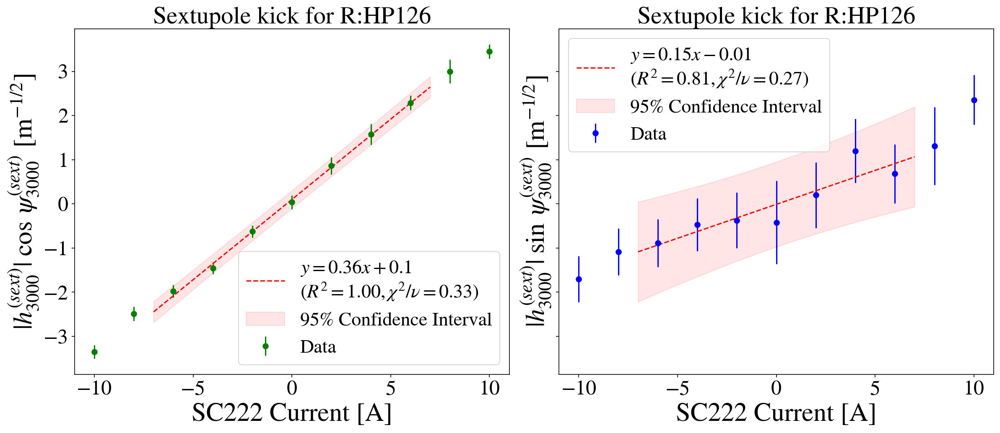

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
3.600623071249091 0.9001557678122728 4
2.3719322591952885
0.6910720553685408 0.1727680138421352 4


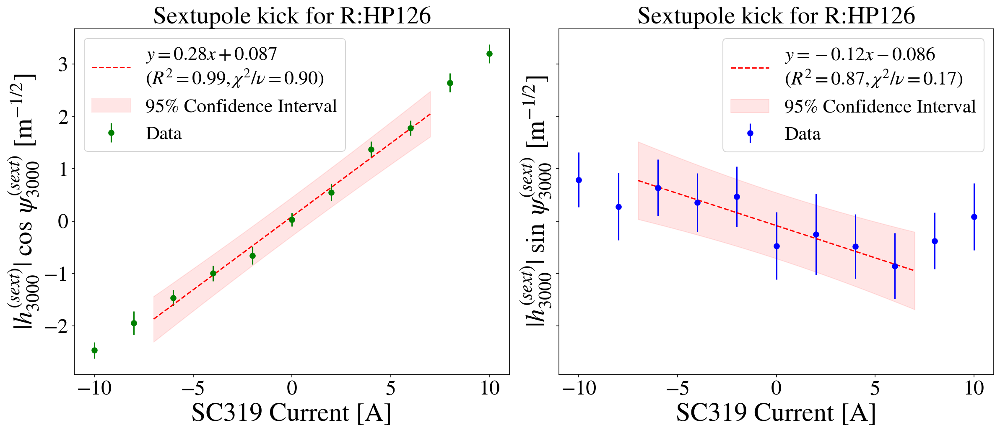

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


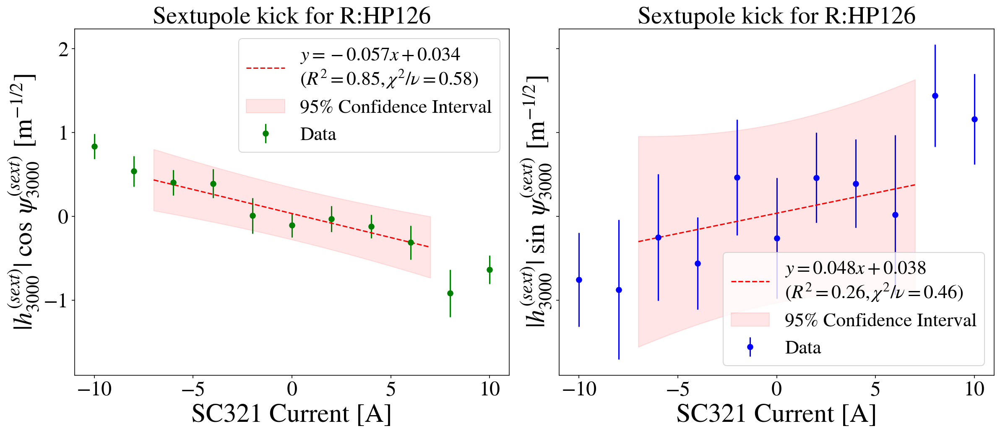

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.2445235118853375 0.3111308779713344 4
2.3719322591952885
0.985223480345492 0.246305870086373 4


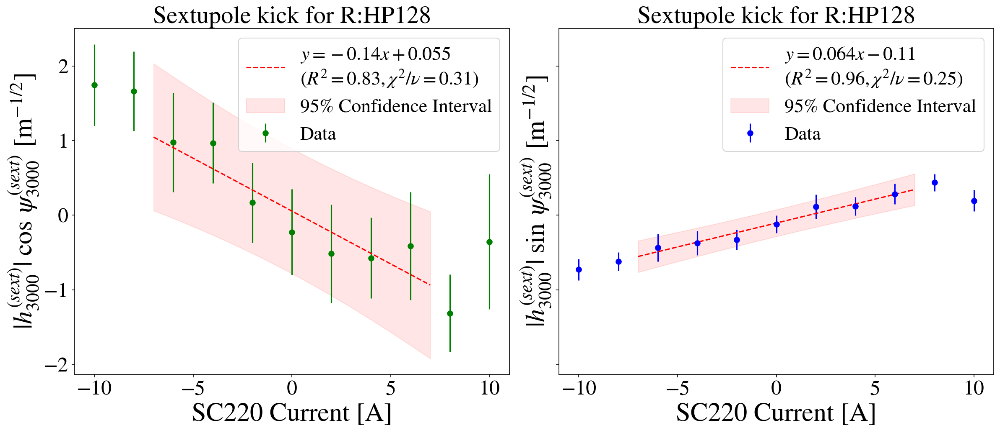

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


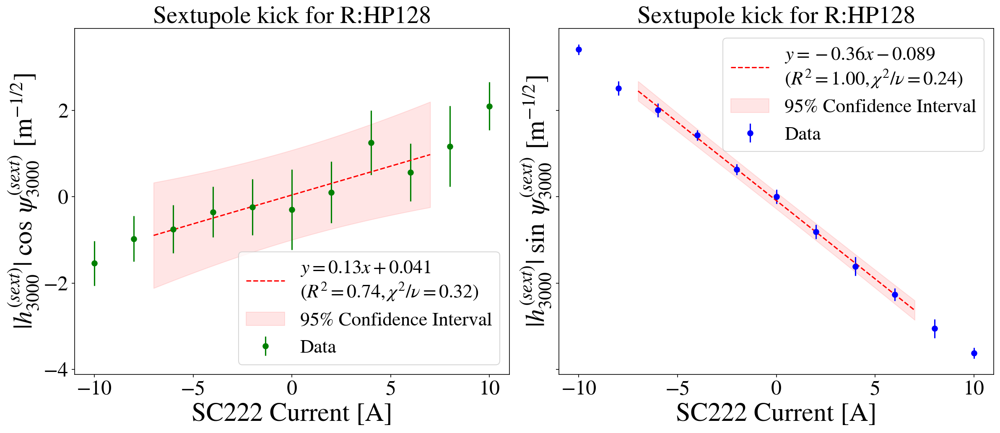

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.9666214675588897 0.24165536688972242 4
2.3719322591952885
2.960875314706939 0.7402188286767347 4


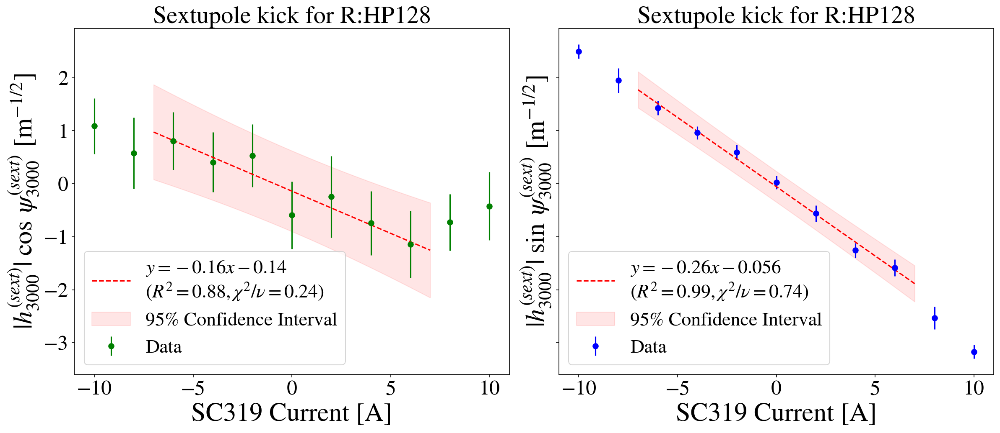

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


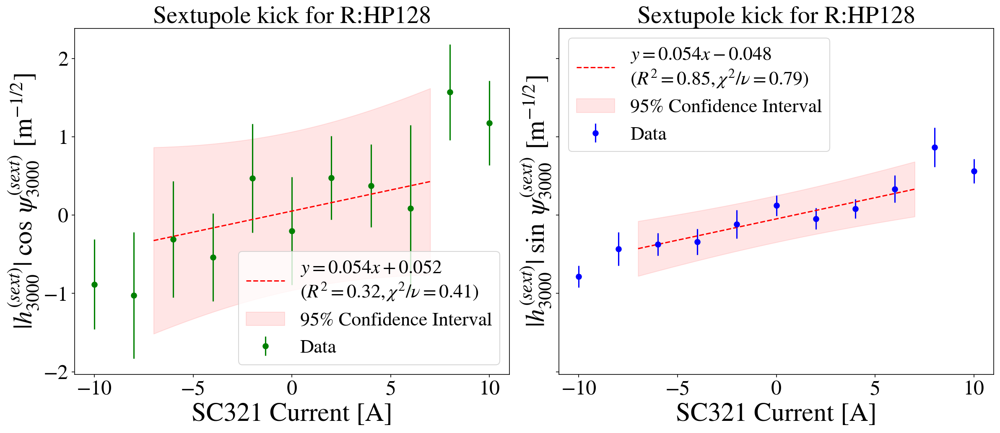

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


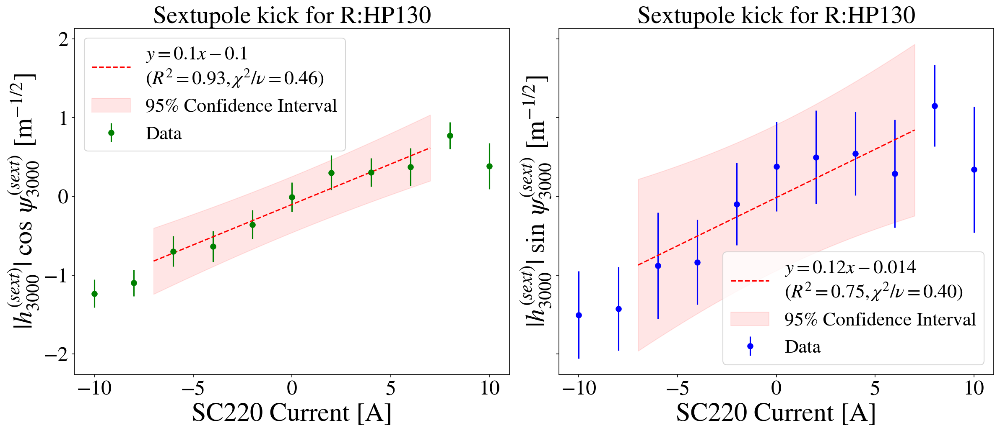

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


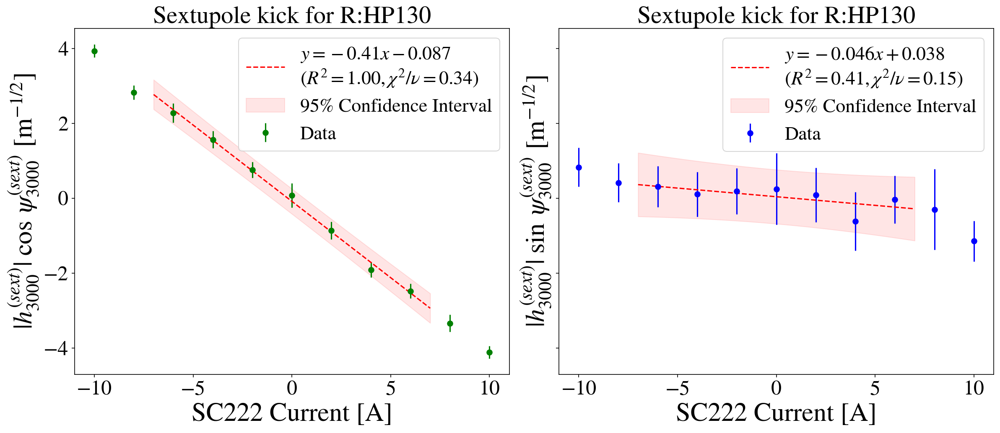

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.487267919435198 0.6218169798587995 4
2.3719322591952885
0.887647571517104 0.221911892879276 4


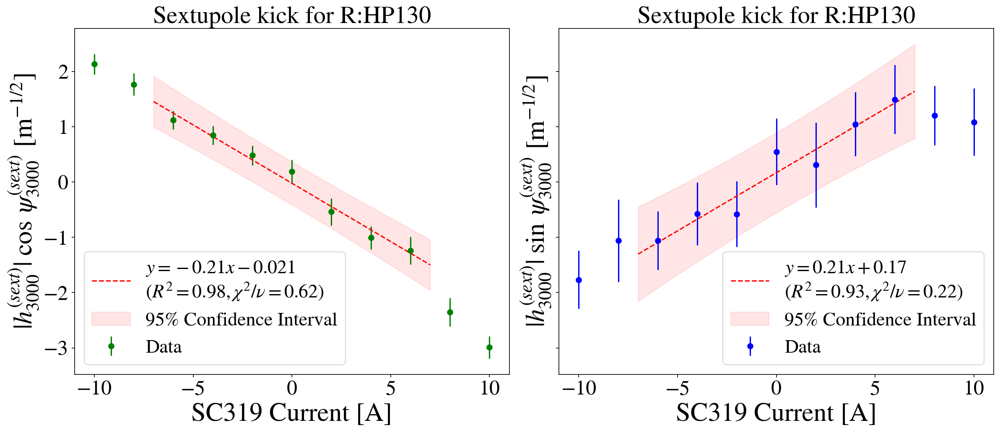

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


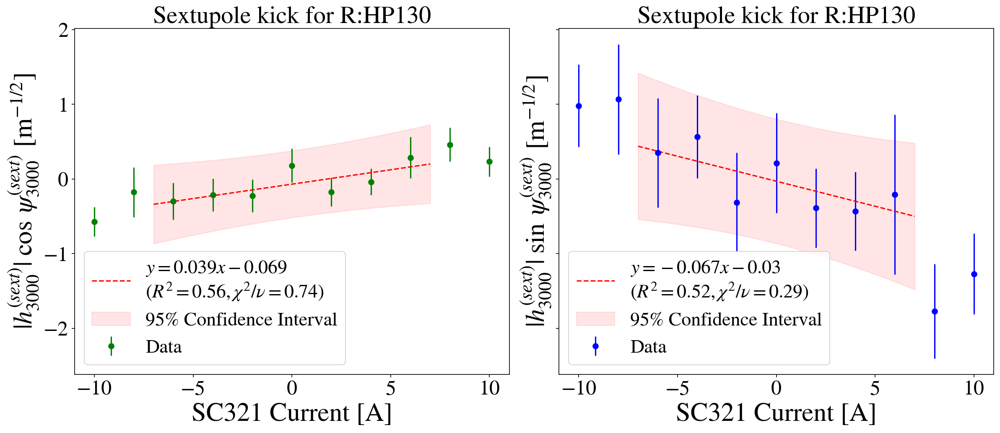

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


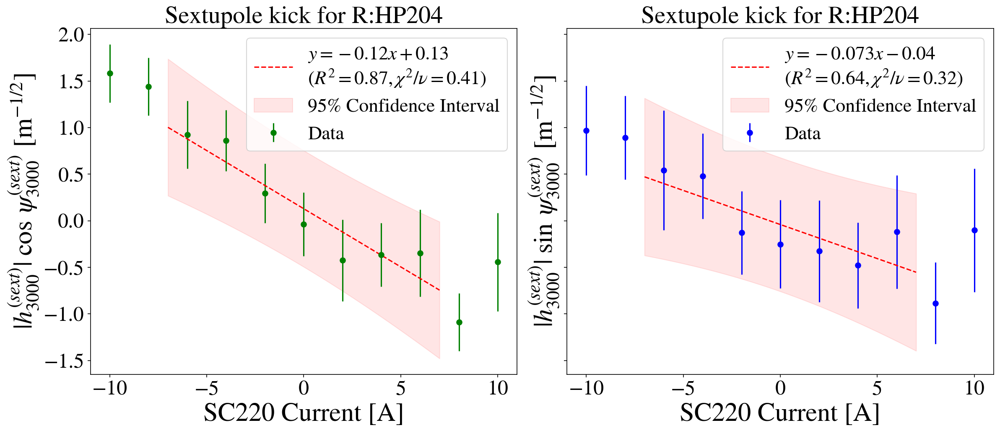

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.7628261313252171 0.4407065328313043 4
2.3719322591952885
0.8961656709861827 0.22404141774654568 4


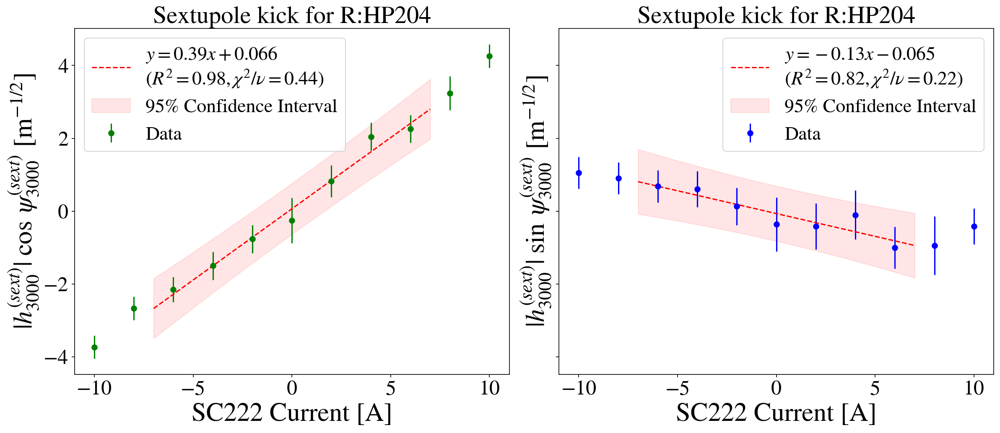

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.7113331784862629 0.17783329462156572 4
2.3719322591952885
0.7082154441403099 0.17705386103507748 4


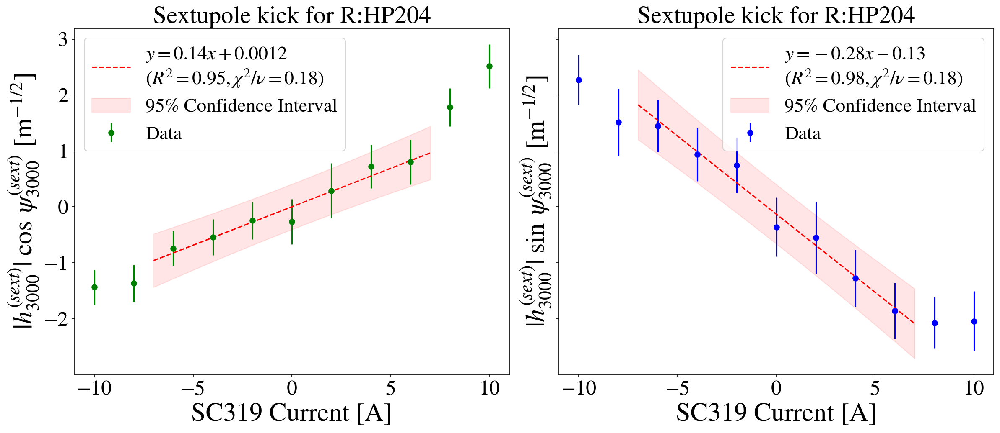

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


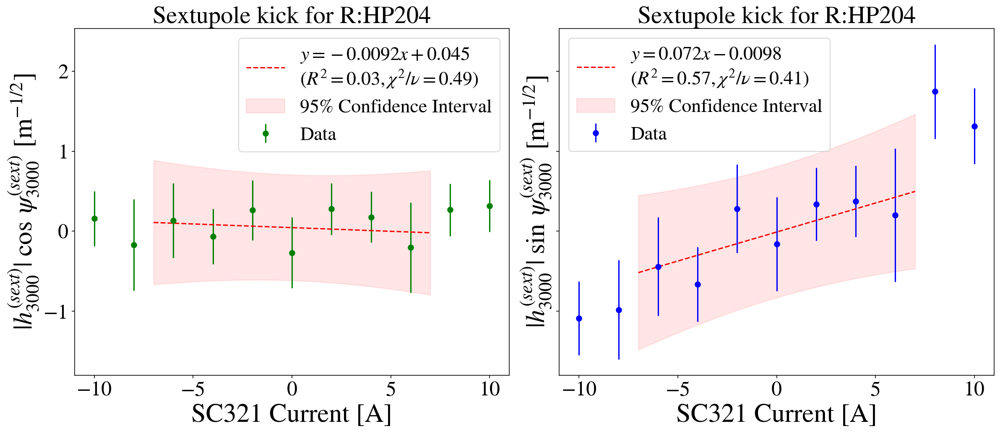

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


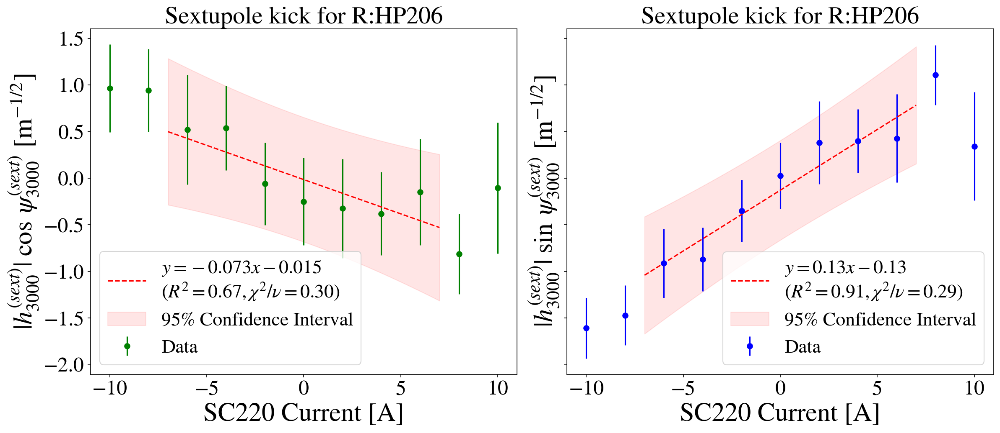

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


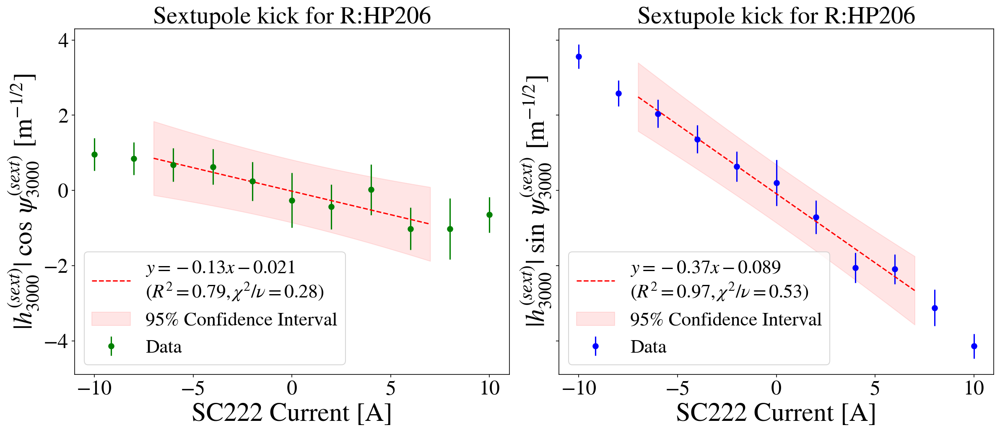

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.9843077421276806 0.24607693553192014 4
2.3719322591952885
0.9271381535879947 0.23178453839699867 4


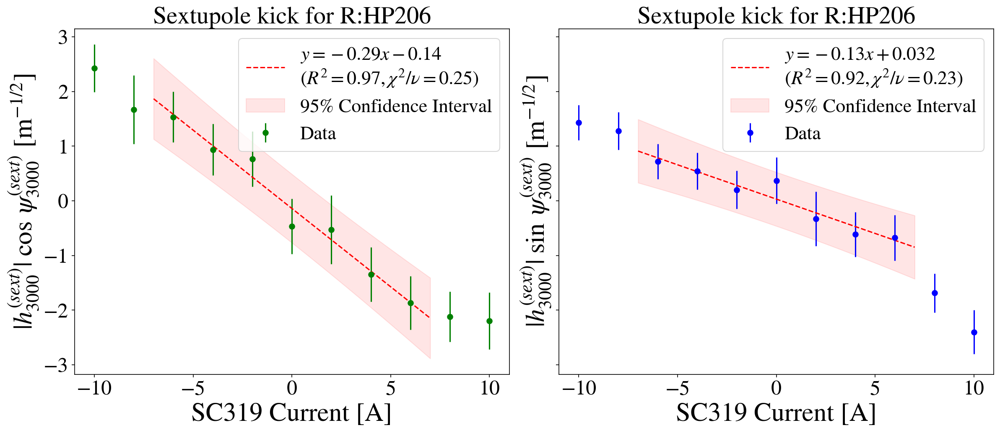

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


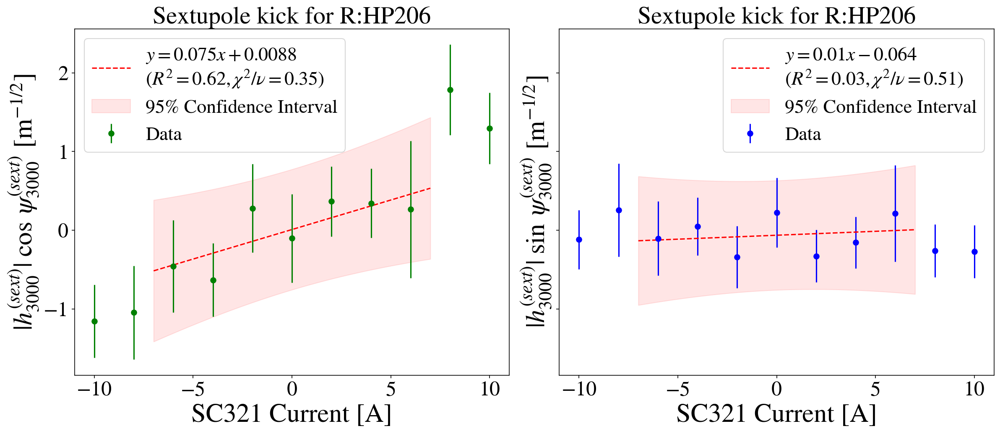

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.2274648342485706 0.30686620856214264 4
2.3719322591952885
1.1097078017119482 0.27742695042798704 4


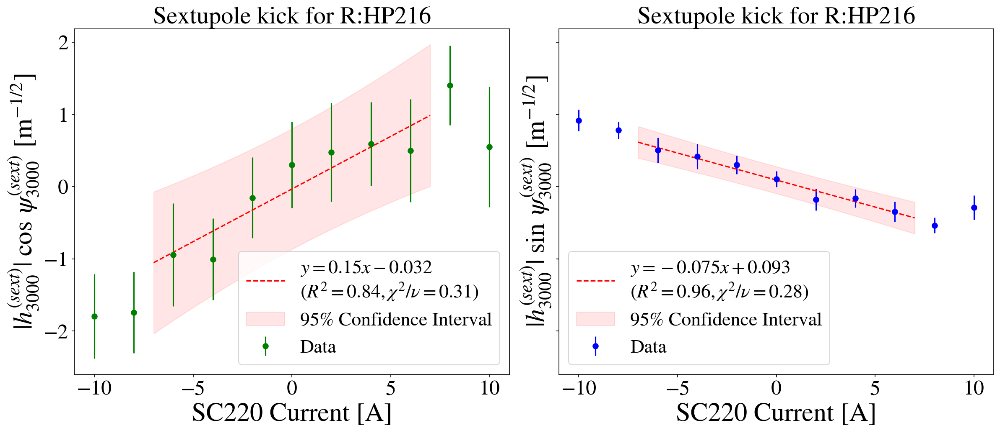

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


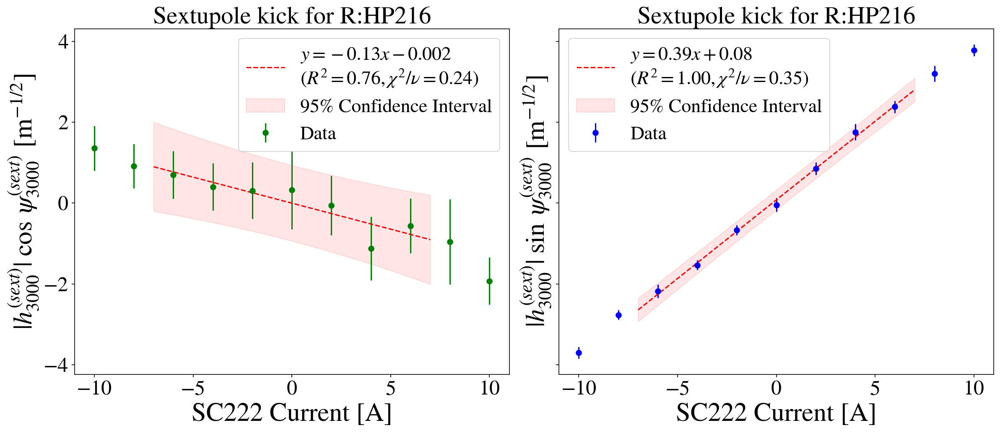

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.8985772144482401 0.22464430361206003 4
2.3719322591952885
3.7953441143446 0.94883602858615 4


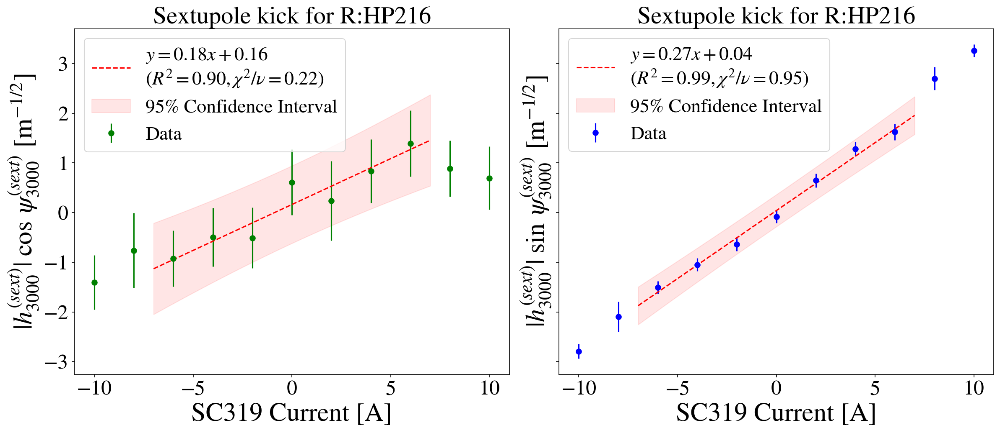

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


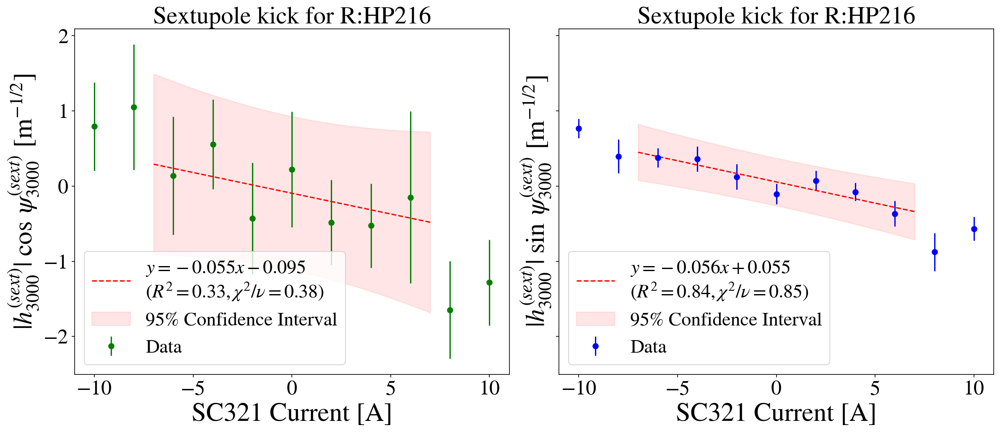

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


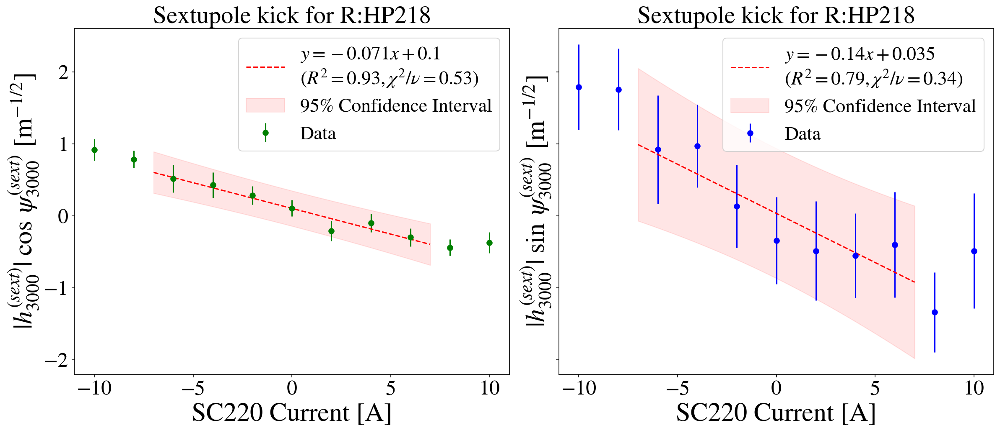

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


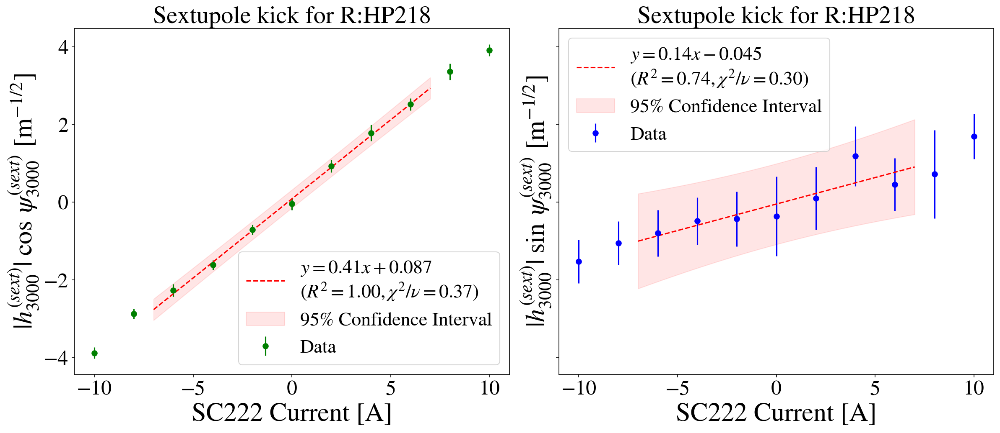

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
3.682400188170458 0.9206000470426146 4
2.3719322591952885
0.5931163991511261 0.14827909978778153 4


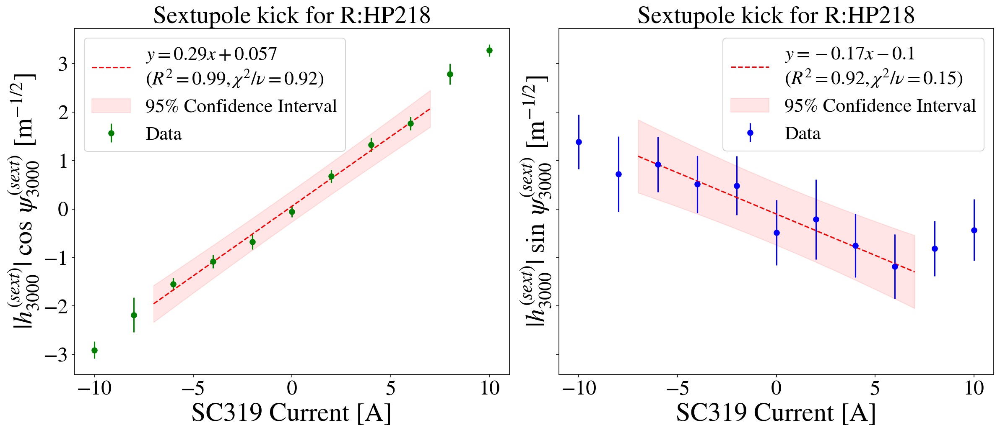

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


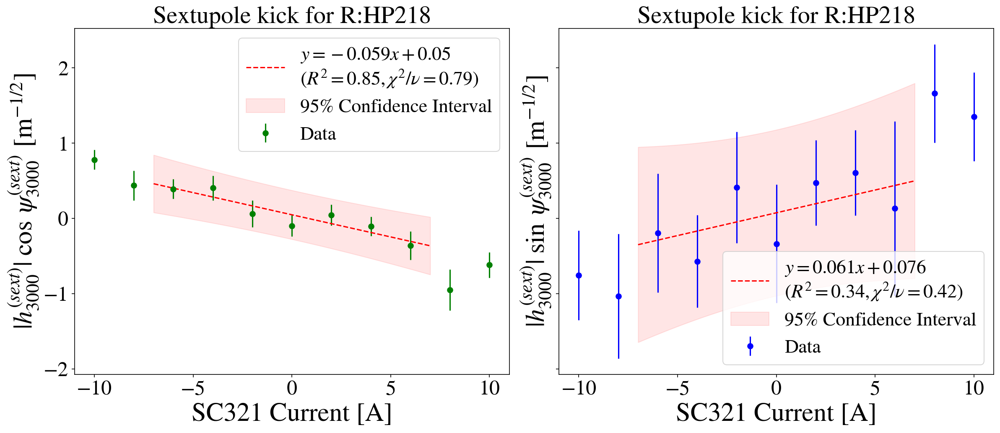

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


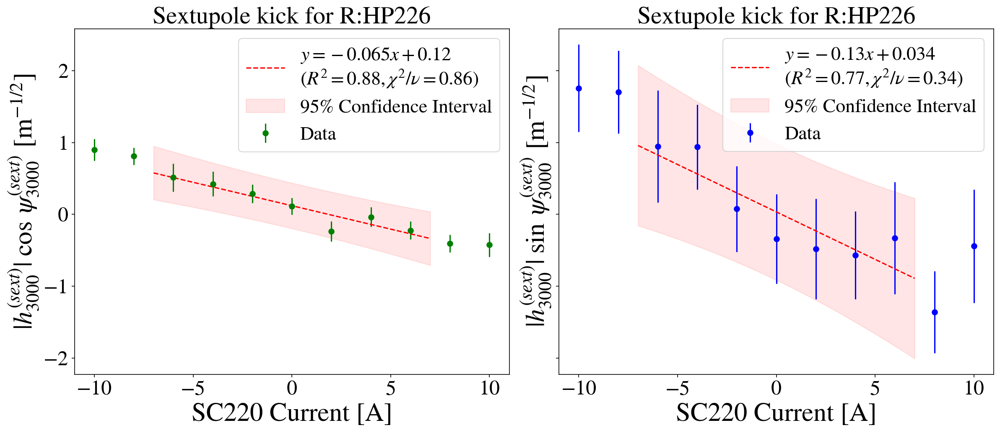

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


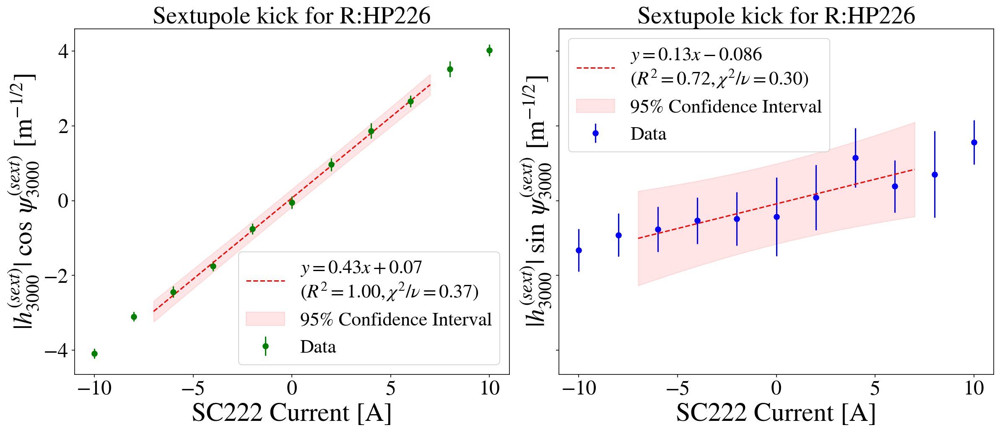

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.9387095627035875 0.7346773906758969 4
2.3719322591952885
0.5607660472748079 0.14019151181870199 4


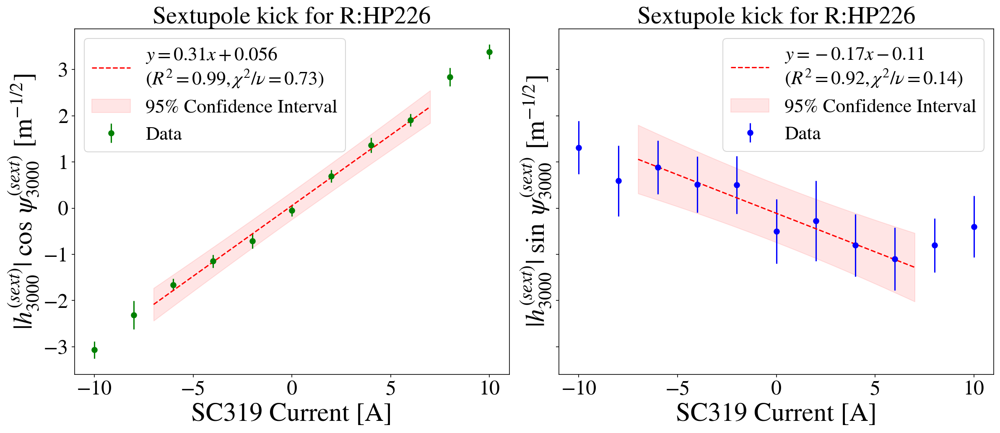

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


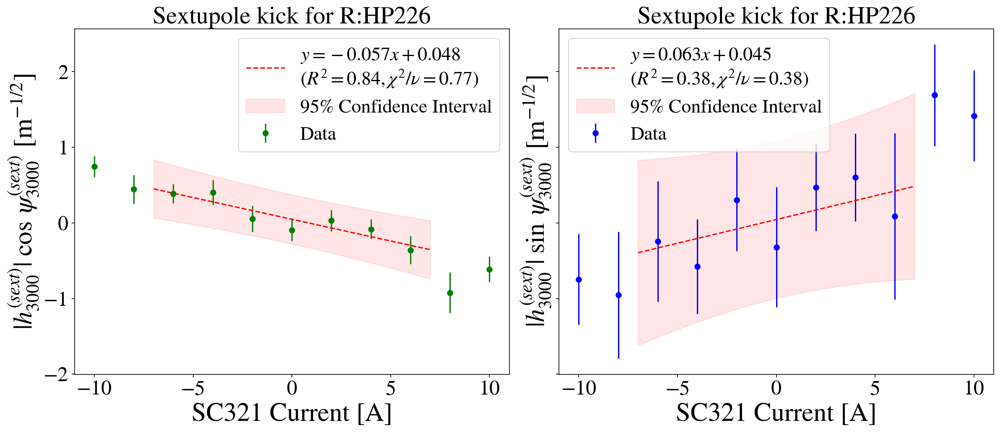

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


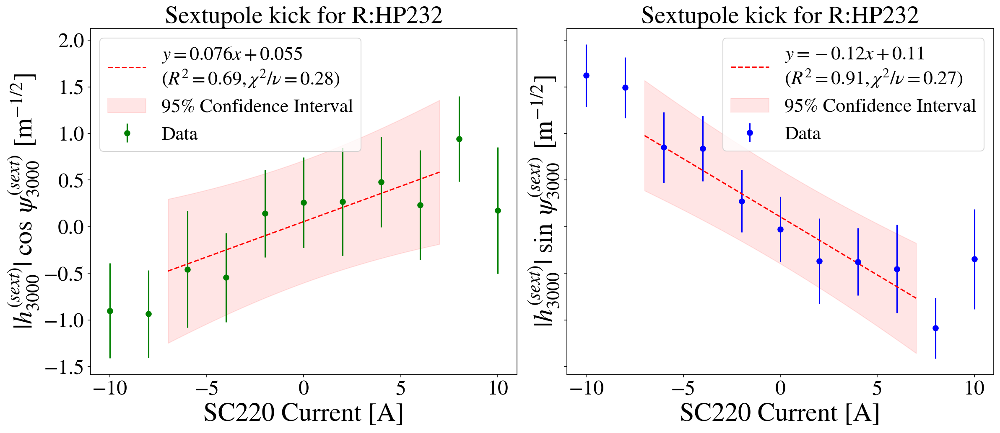

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.7889970906373934 0.19724927265934836 4
2.3719322591952885
1.9641419886661946 0.49103549716654865 4


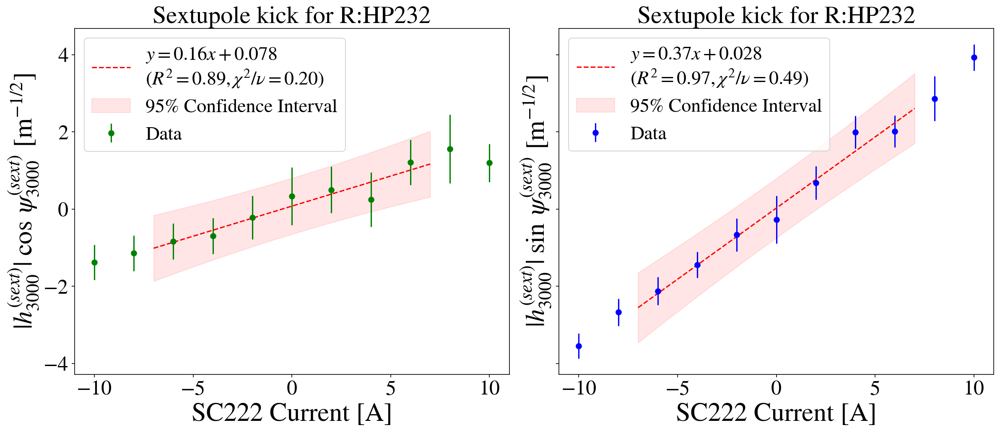

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.8970509342638989 0.22426273356597473 4
2.3719322591952885
1.1858355320536047 0.2964588830134012 4


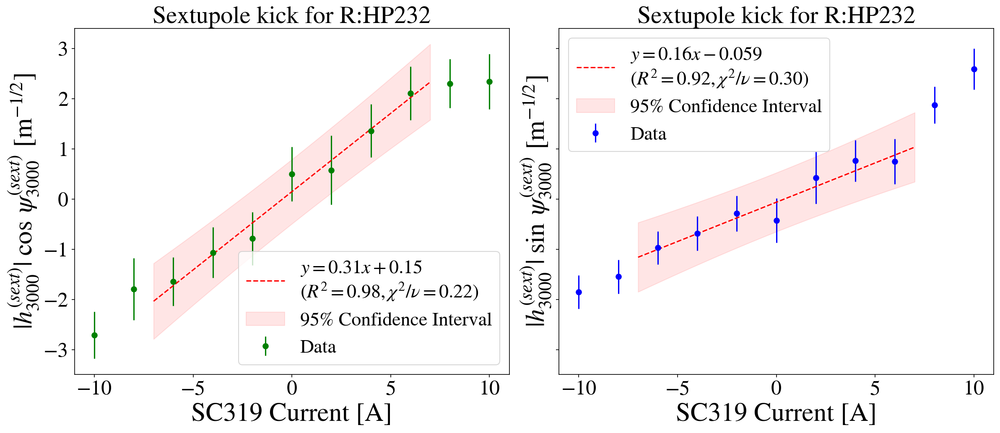

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


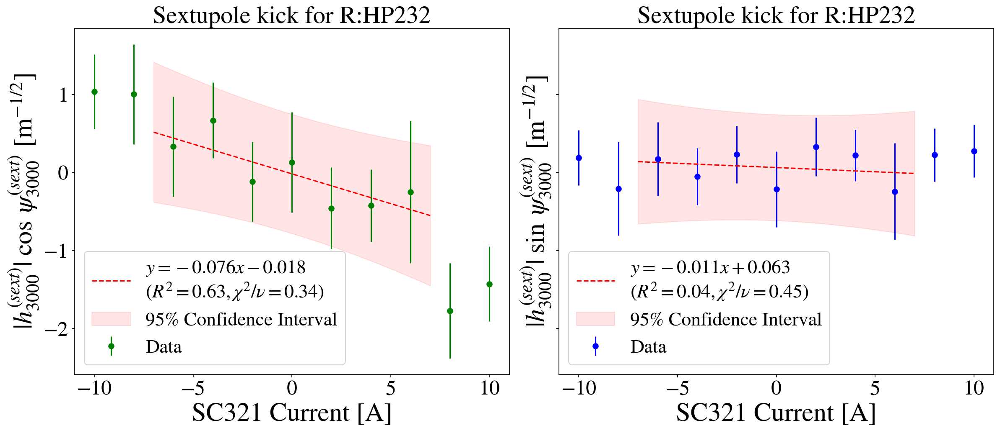

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


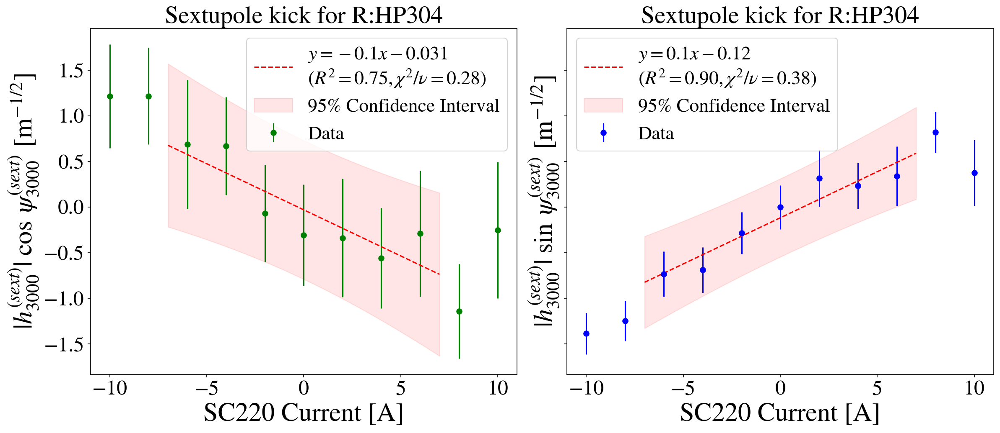

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


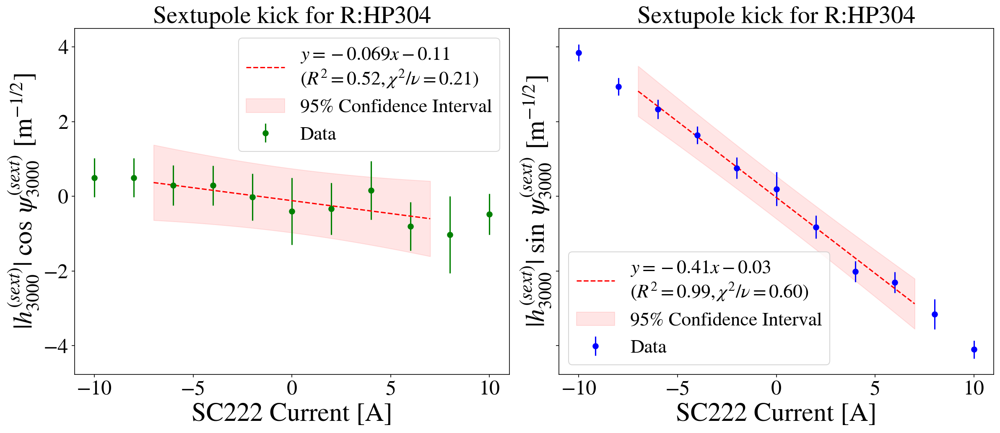

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.8017070307259263 0.20042675768148158 4
2.3719322591952885
1.2248522535320503 0.3062130633830126 4


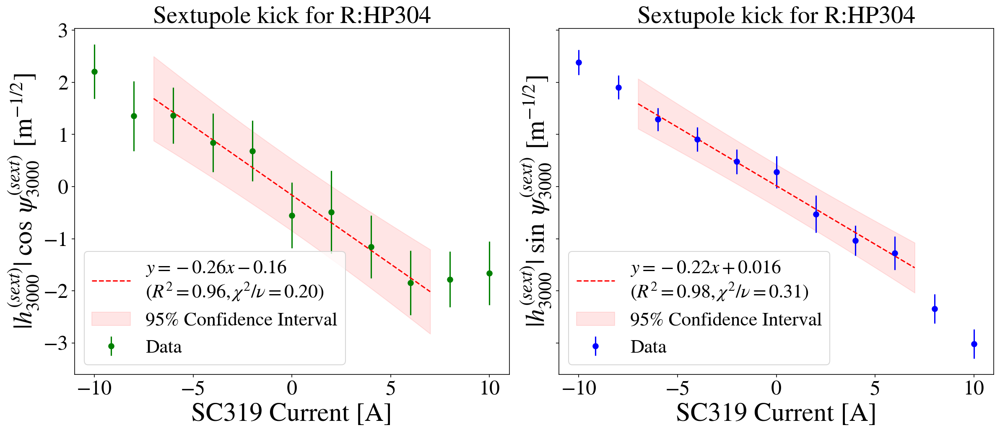

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


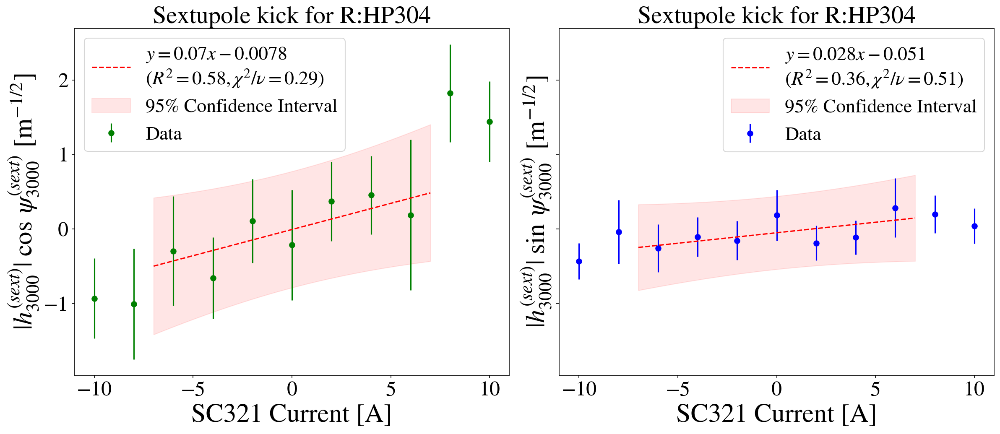

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


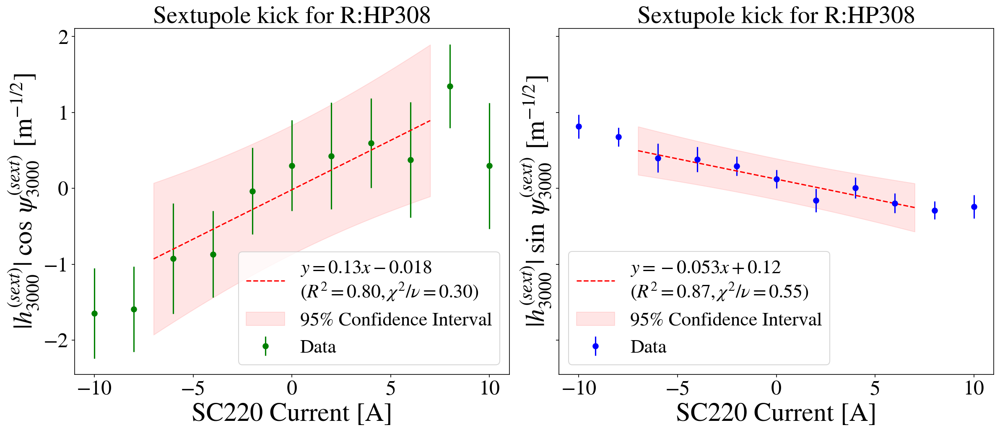

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


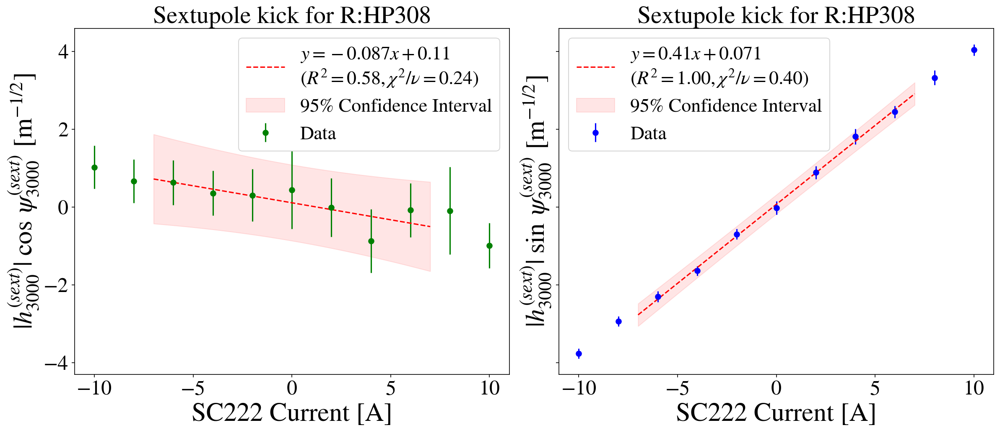

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.8670162709381248 0.2167540677345312 4
2.3719322591952885
2.4755225429719165 0.6188806357429791 4


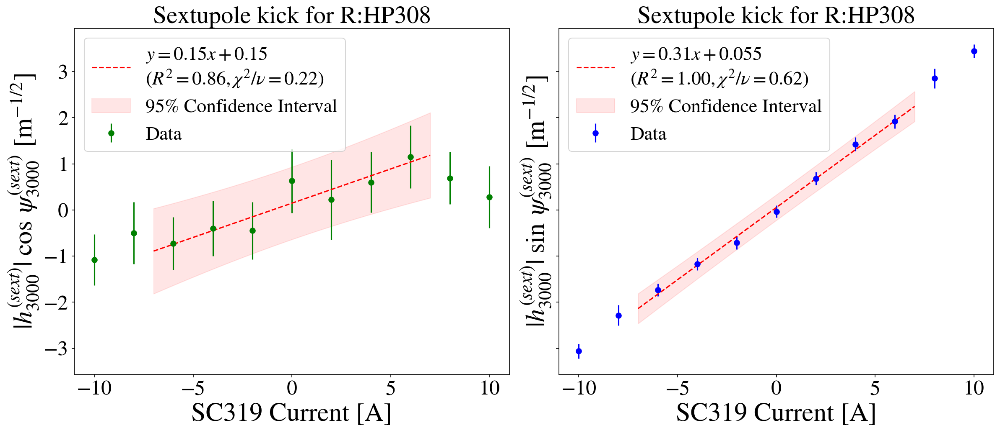

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


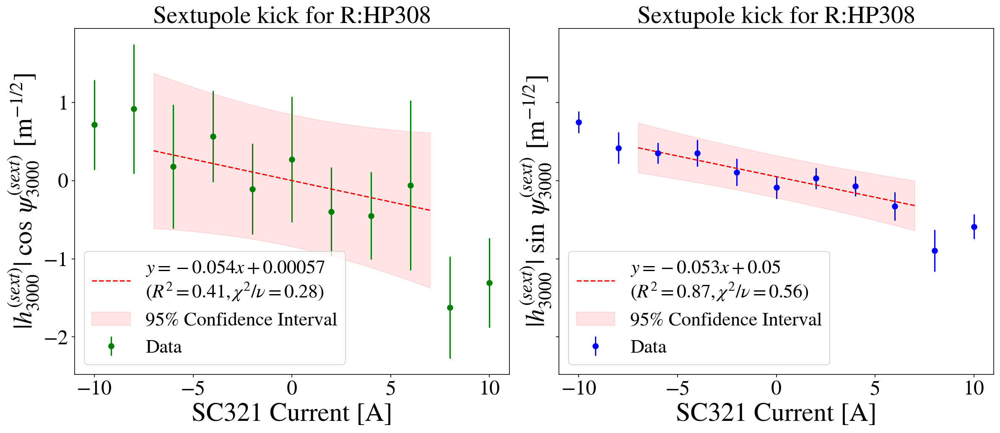

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


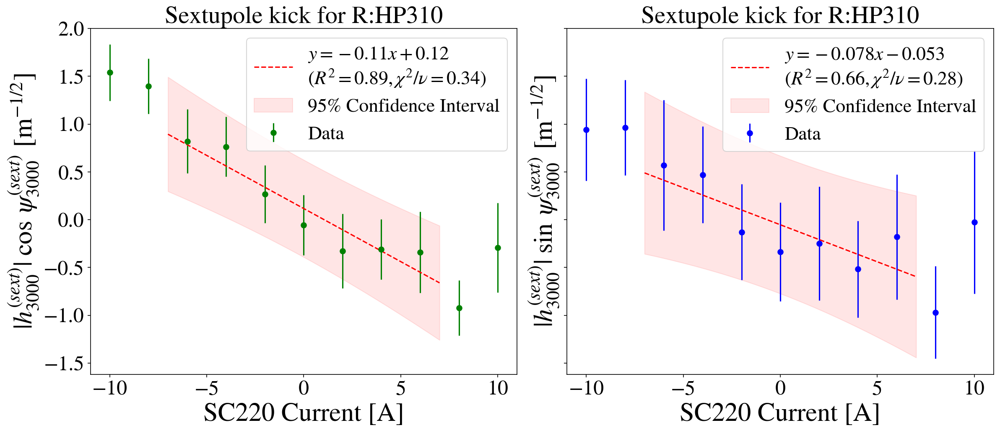

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


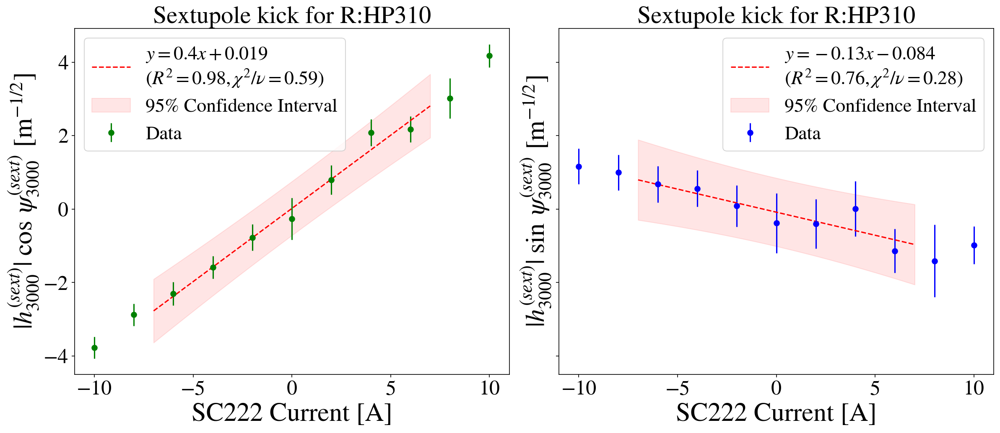

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.046053068838149 0.26151326720953727 4
2.3719322591952885
0.7997494388469798 0.19993735971174495 4


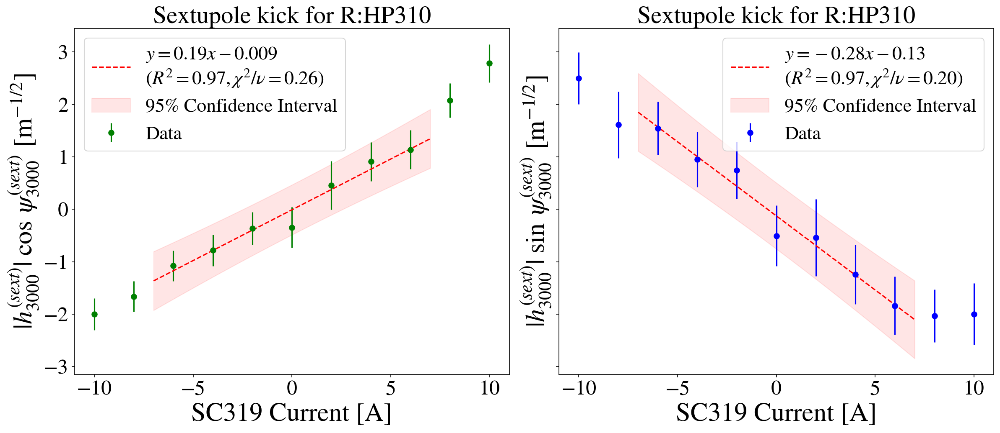

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


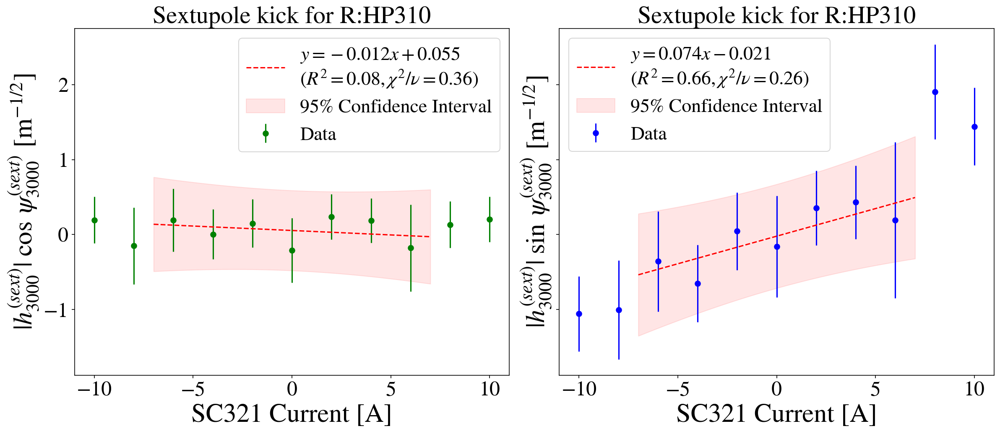

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


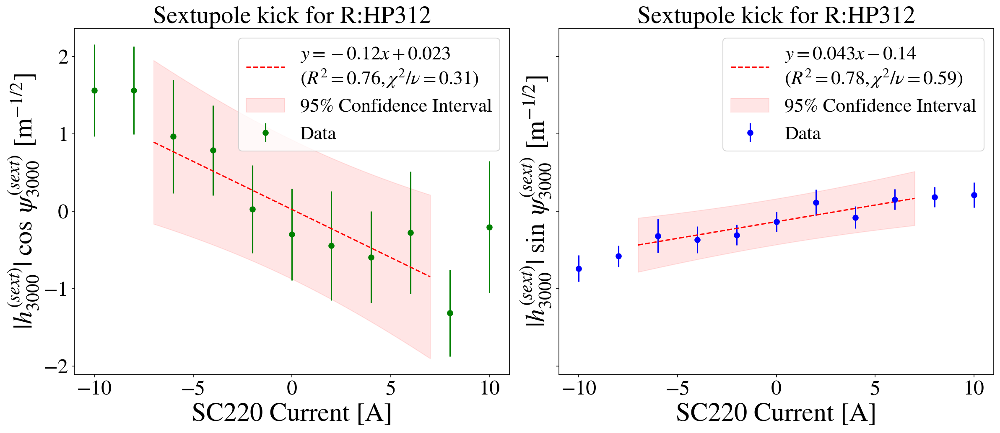

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


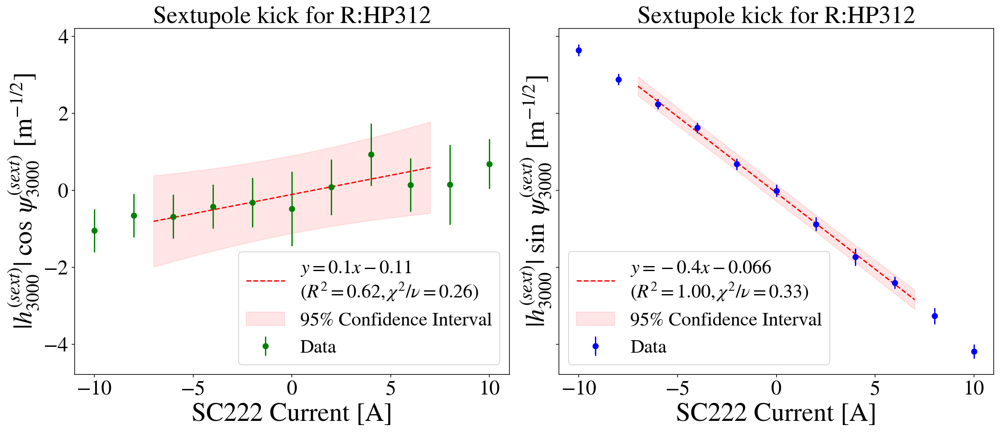

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.8676671451744247 0.21691678629360617 4
2.3719322591952885
2.411706261589651 0.6029265653974127 4


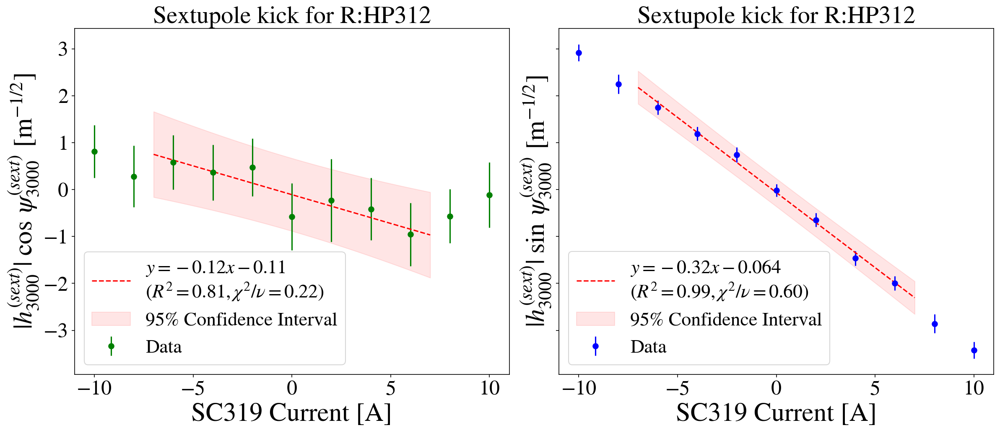

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


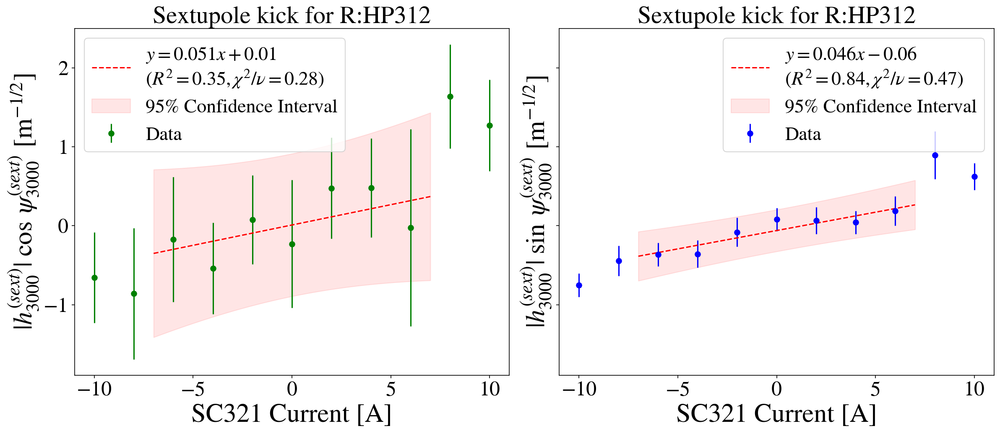

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.0038806737651296 0.5009701684412824 4
2.3719322591952885
1.095700565353452 0.273925141338363 4


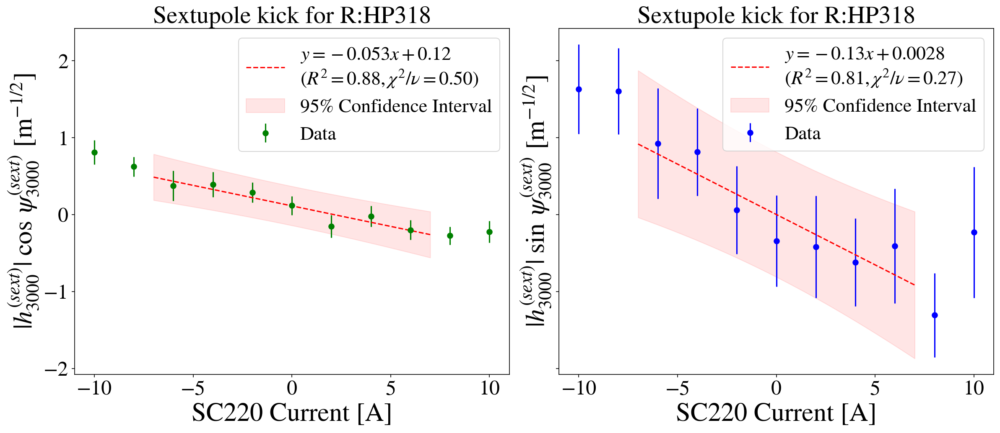

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


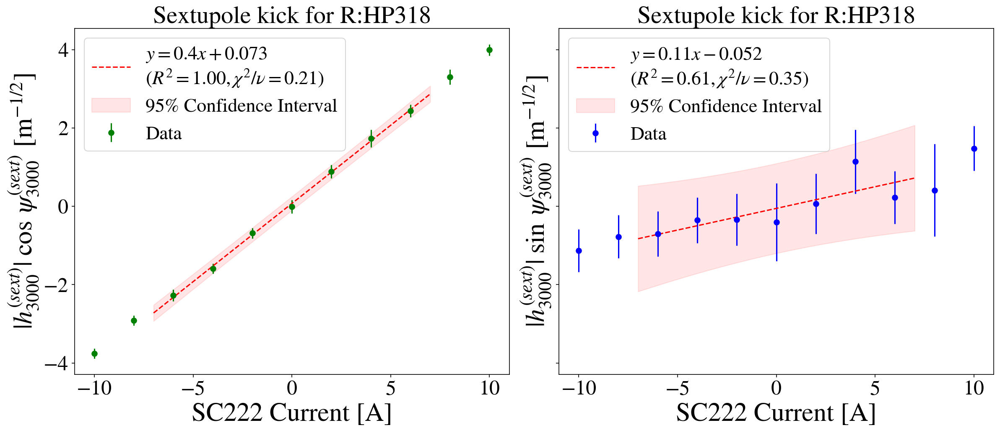

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.4388908928253126 0.6097227232063281 4
2.3719322591952885
0.9766641009463805 0.2441660252365951 4


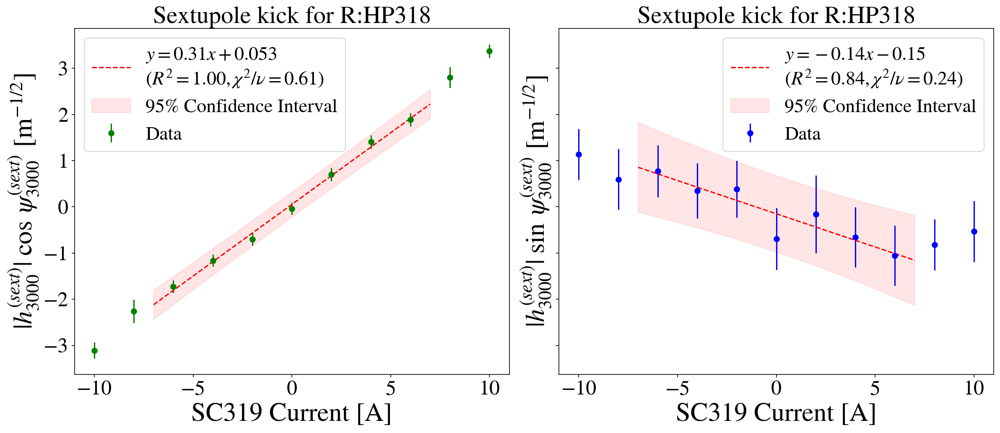

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


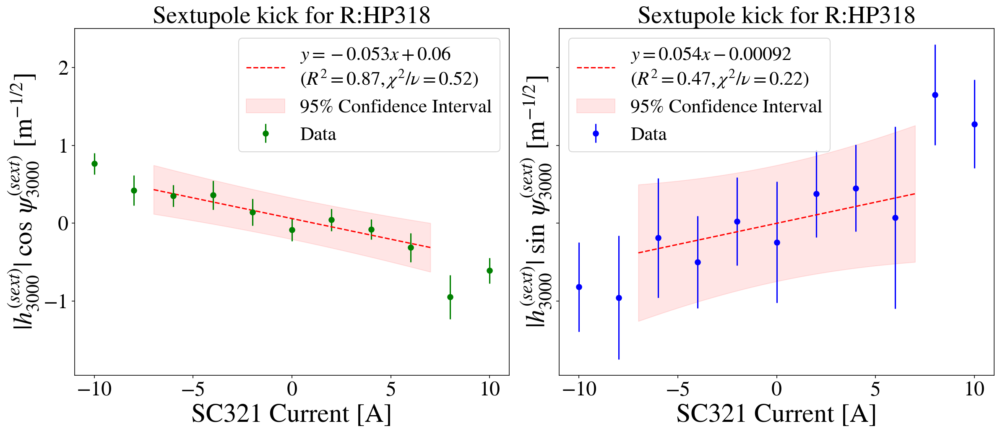

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


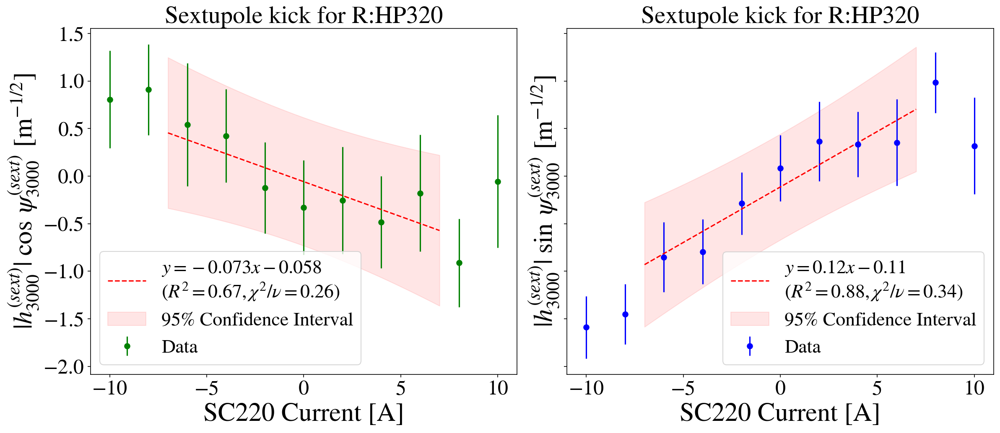

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.7174936217055342 0.17937340542638355 4
2.3719322591952885
1.733163687682985 0.43329092192074625 4


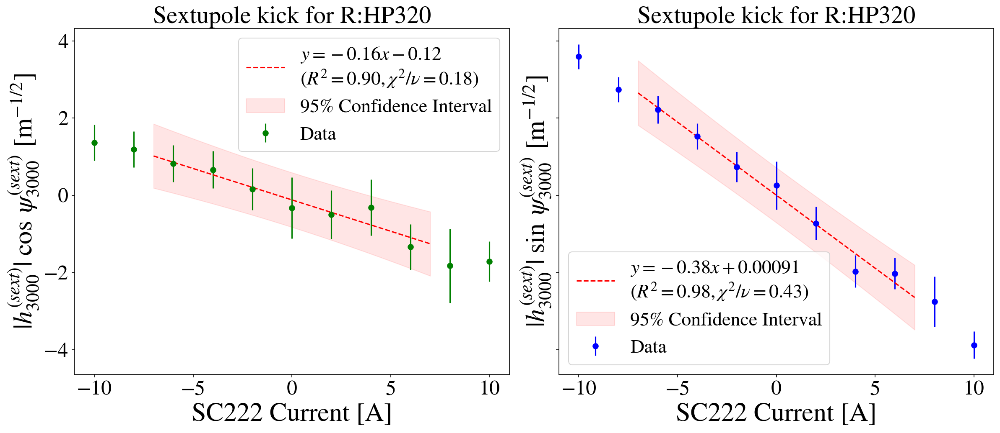

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.9272862013481018 0.23182155033702545 4
2.3719322591952885
1.054386271216219 0.26359656780405477 4


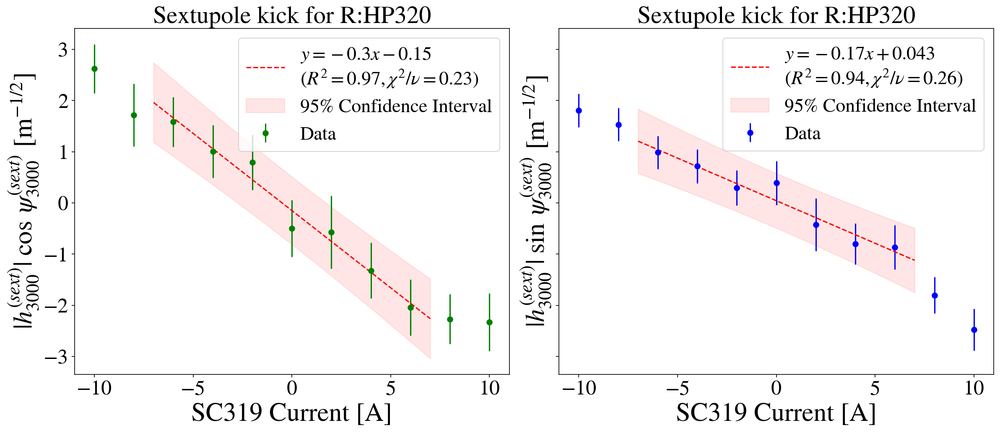

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


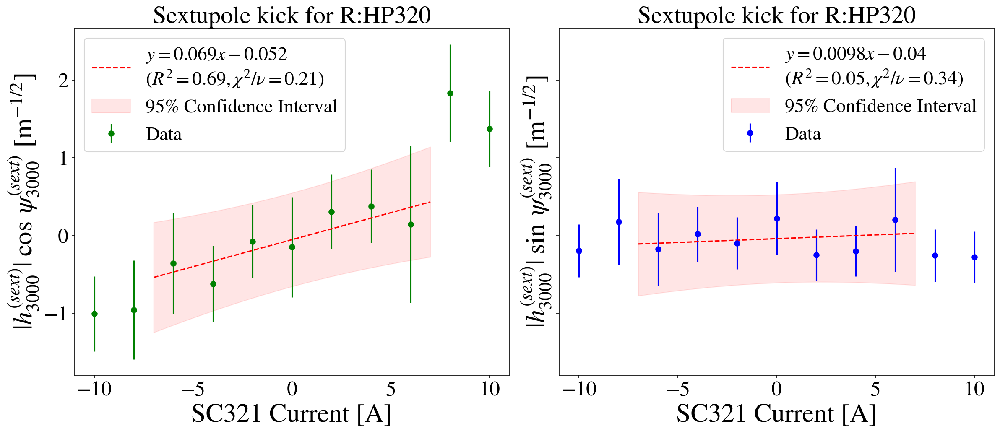

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


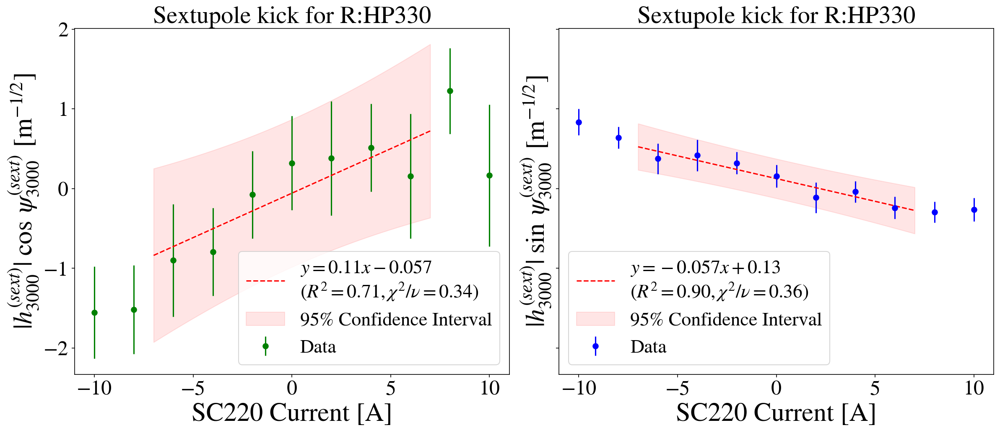

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


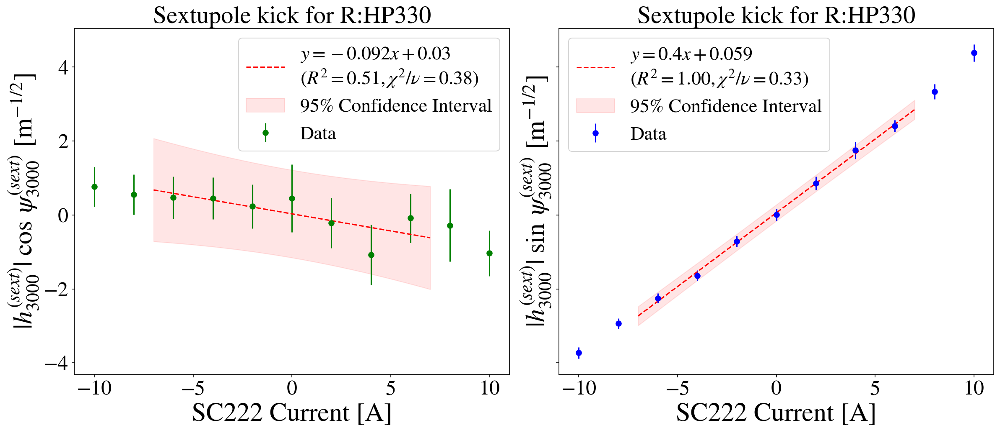

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.590324983618043 0.14758124590451074 4
2.3719322591952885
1.3483996125456774 0.33709990313641935 4


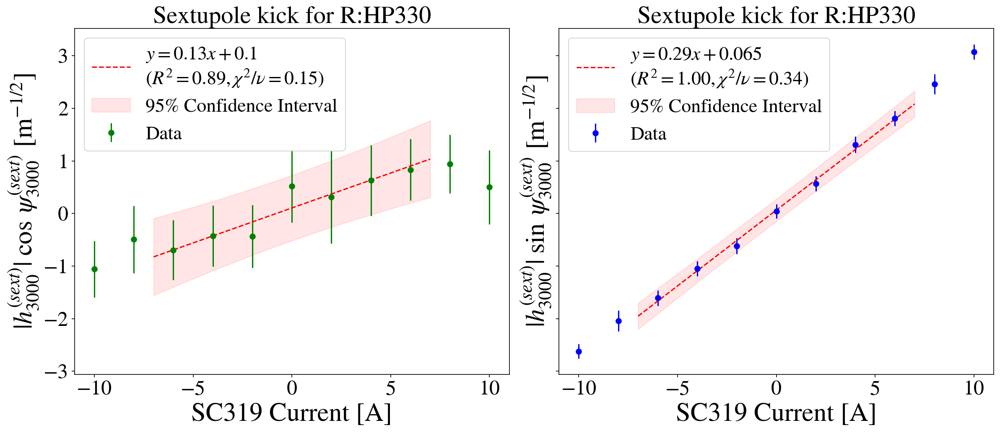

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


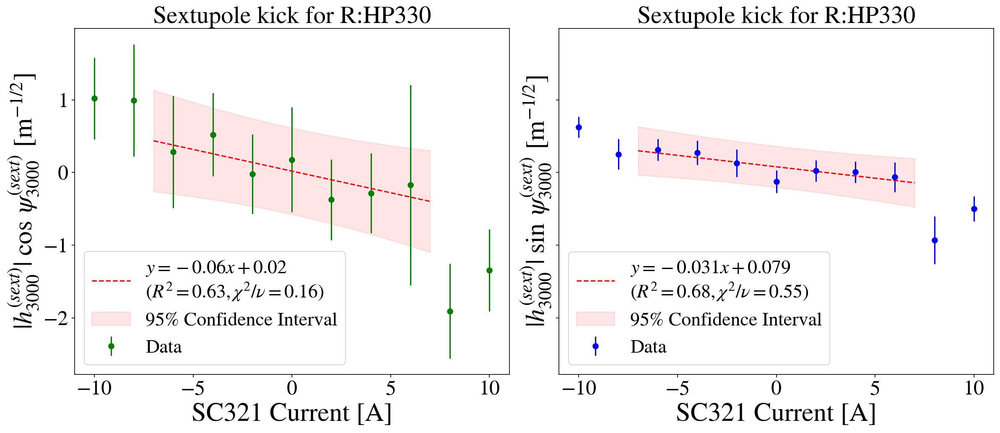

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.0634216638581169 0.2658554159645292 4
2.3719322591952885
1.1211669577347882 0.28029173943369706 4


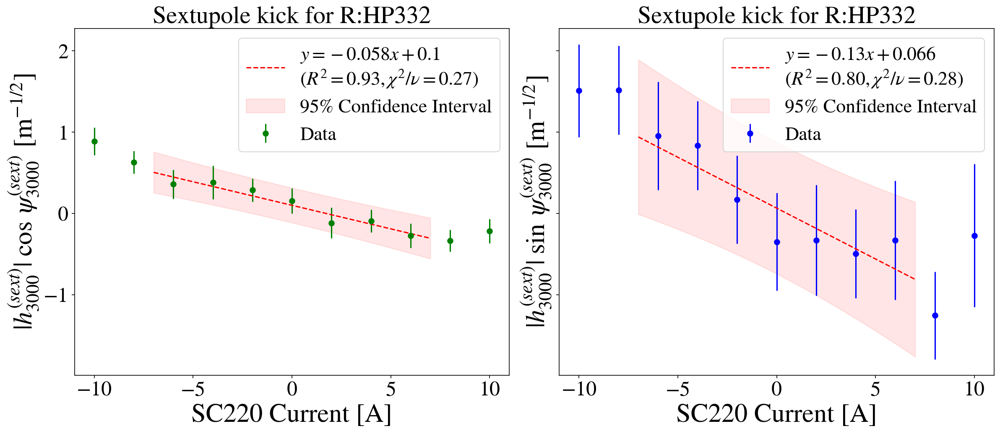

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


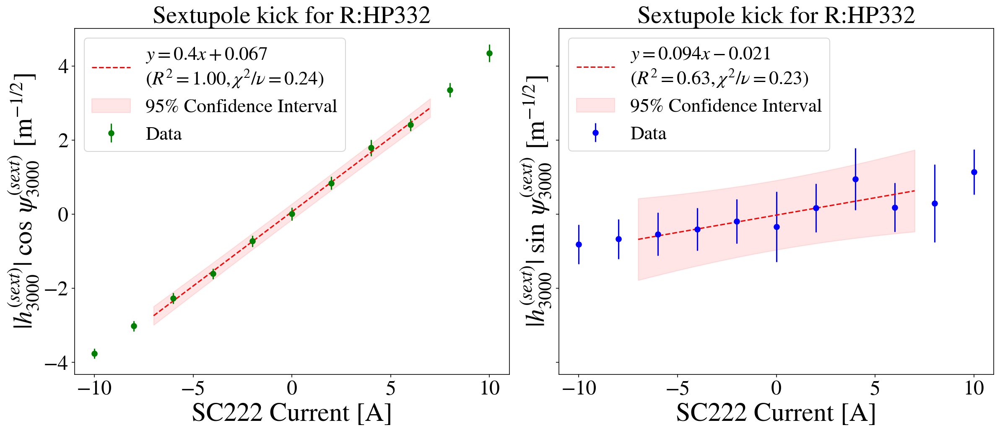

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.8934013960292172 0.2233503490073043 4
2.3719322591952885
0.750074774995591 0.18751869374889776 4


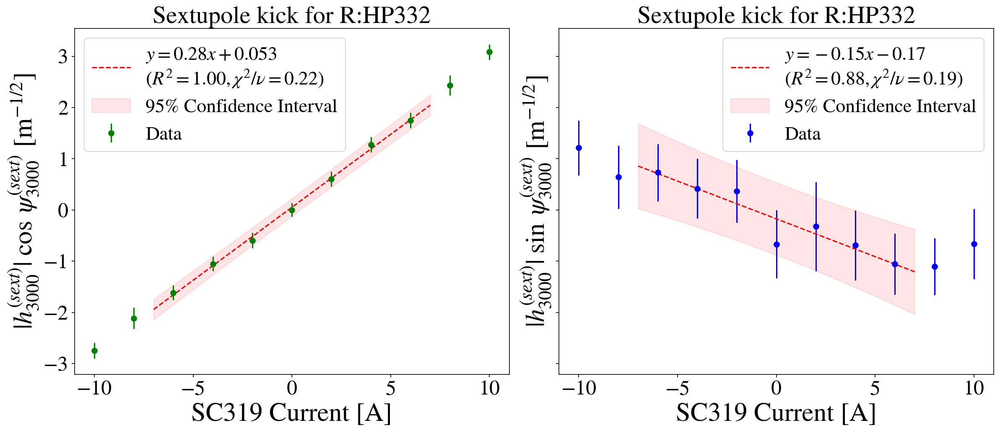

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


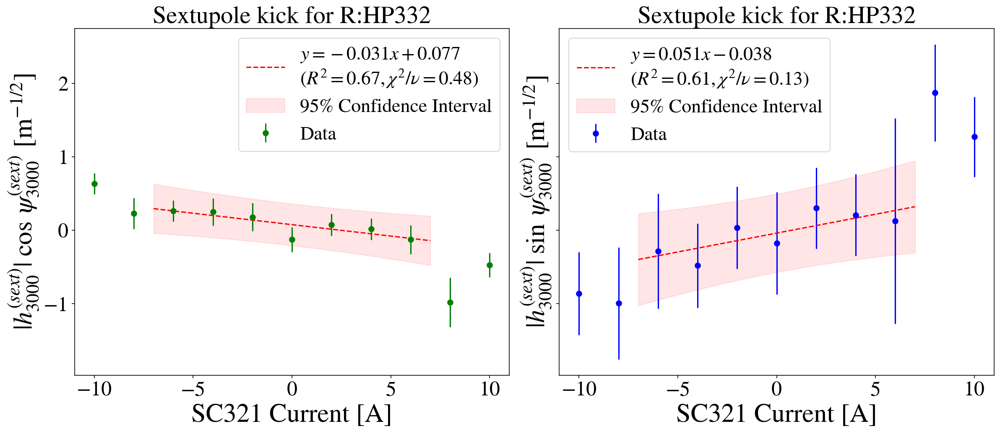

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


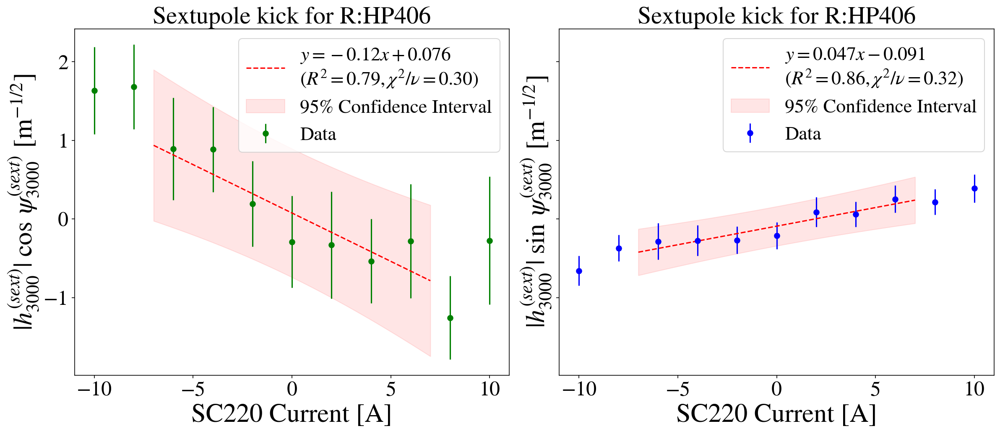

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


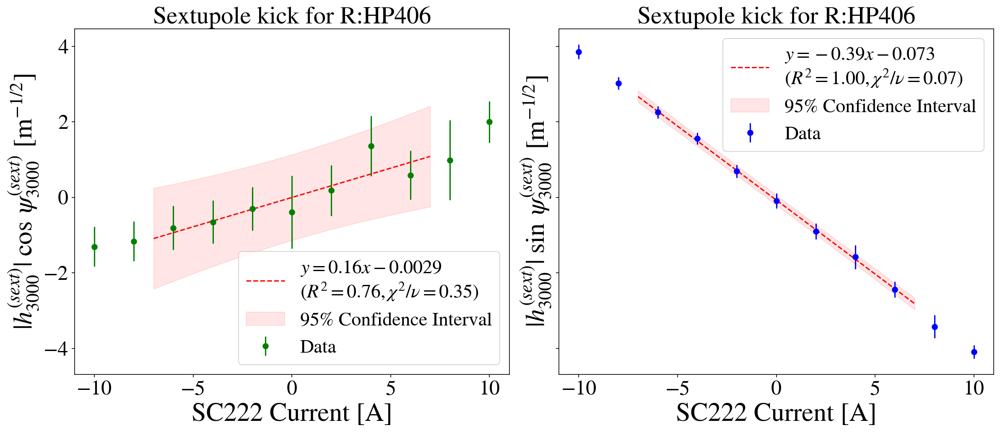

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.7781675906634165 0.1945418976658541 4
2.3719322591952885
0.8369725297120182 0.20924313242800455 4


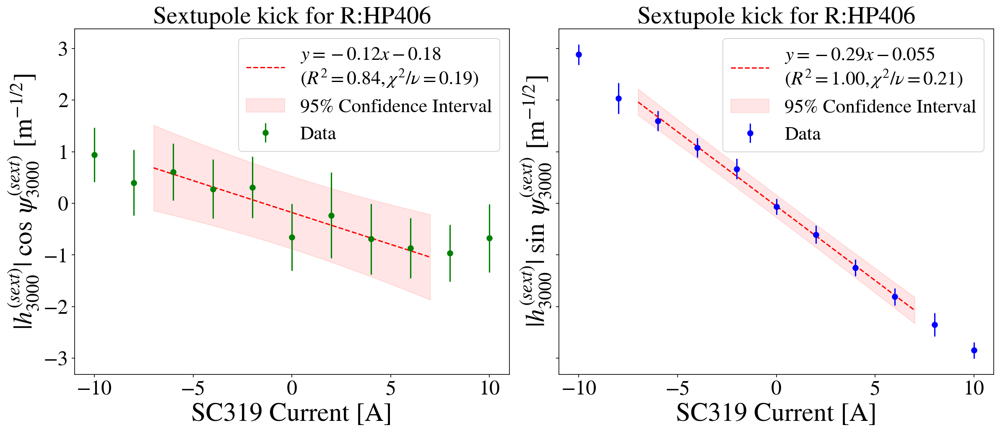

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


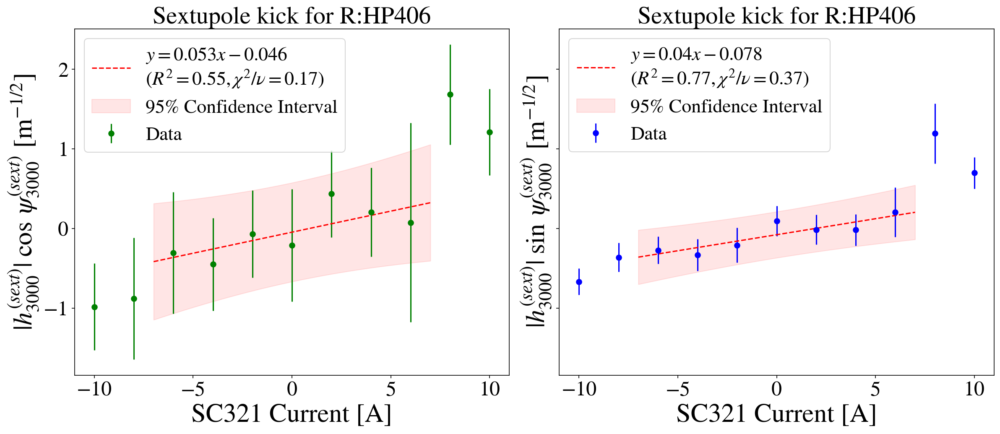

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


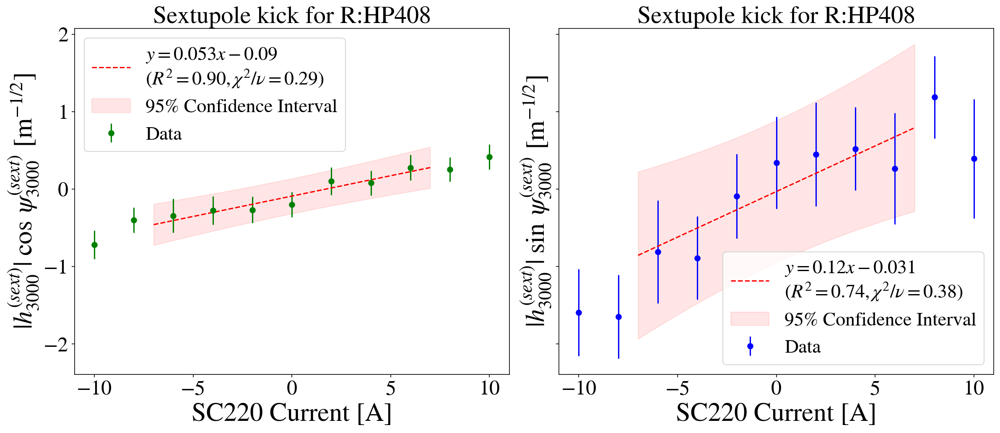

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


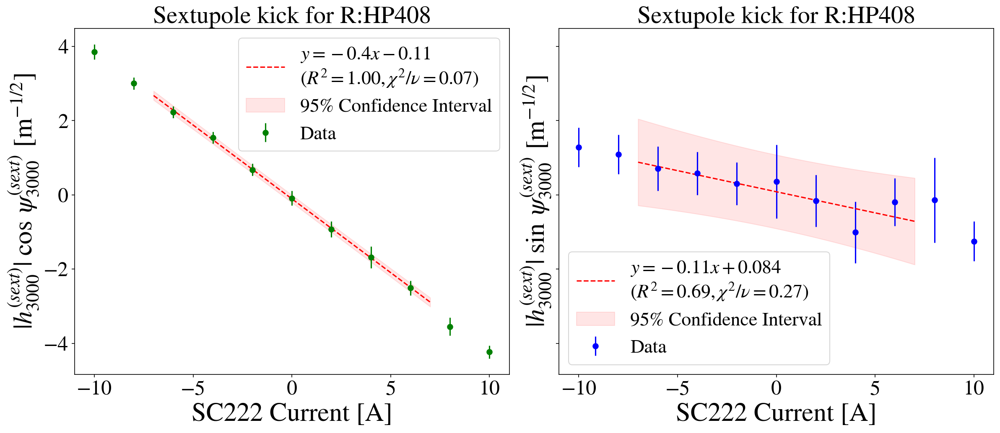

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.2828146945780967 0.3207036736445242 4
2.3719322591952885
0.7111034909938548 0.1777758727484637 4


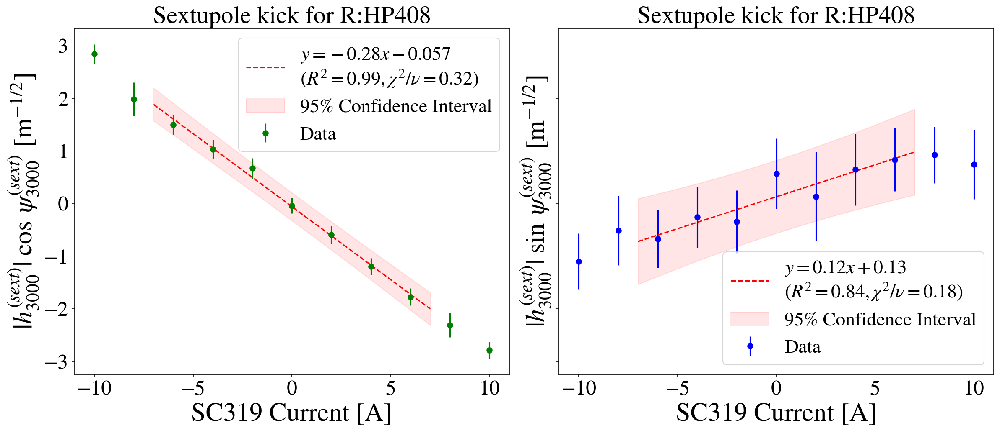

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


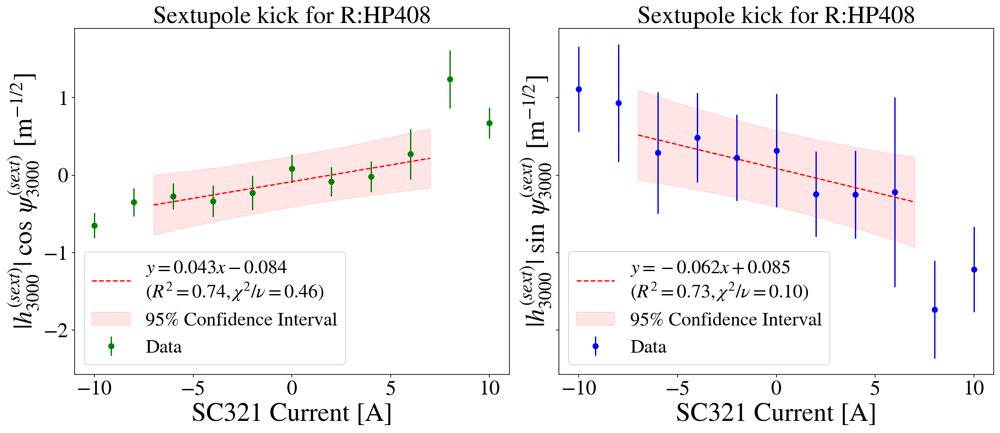

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


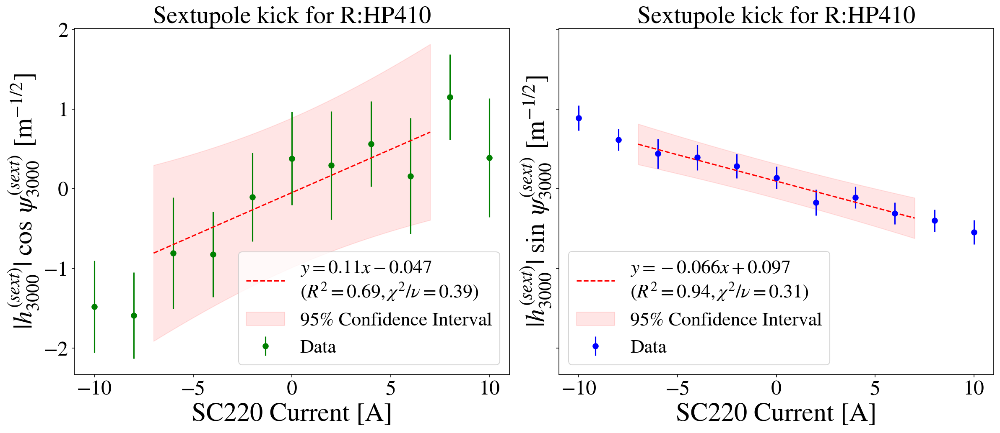

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


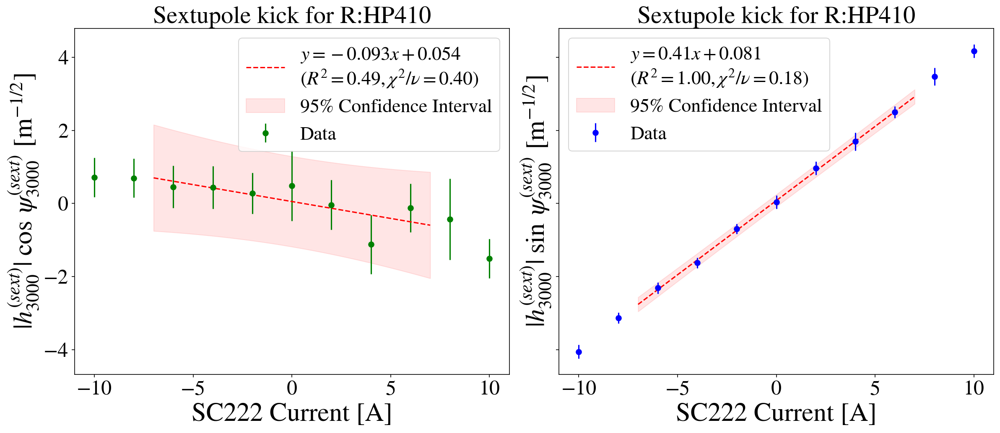

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.6269418511594105 0.15673546278985262 4
2.3719322591952885
2.1645361727043086 0.5411340431760772 4


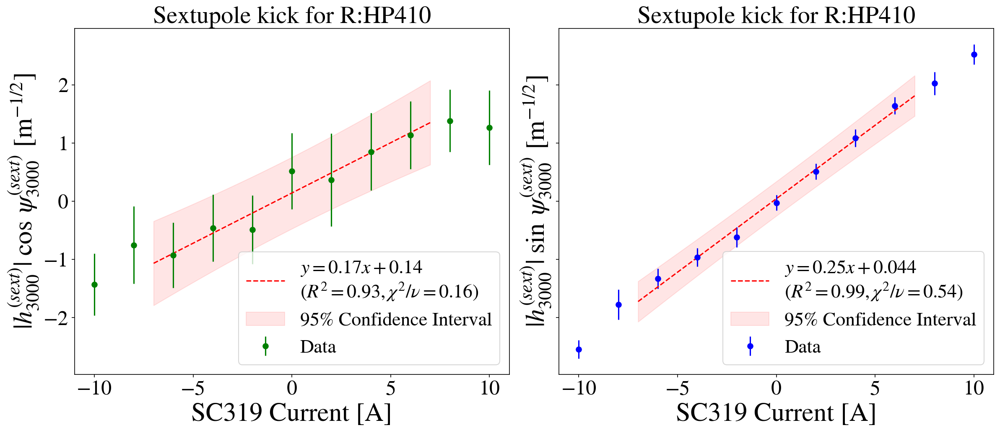

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


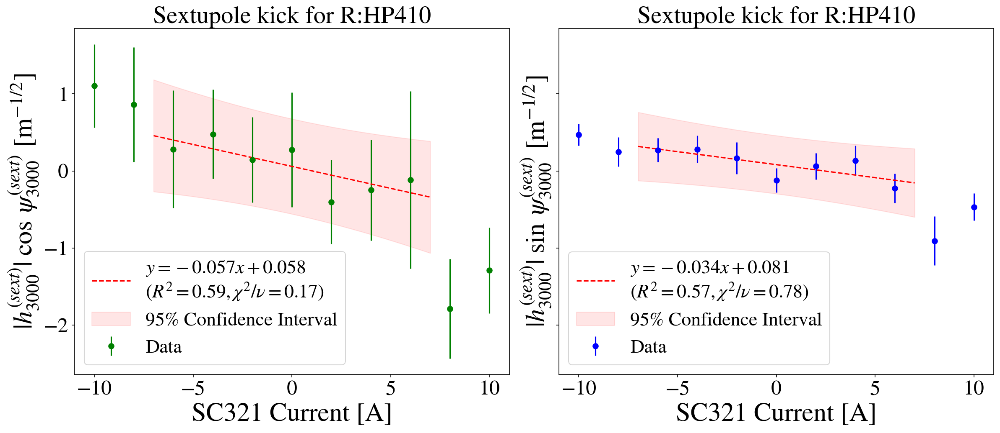

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


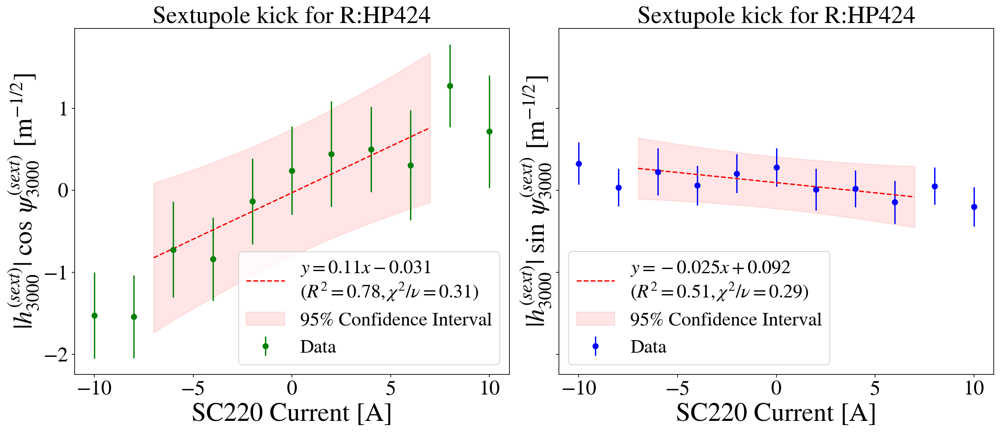

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.1756742980687784 0.2939185745171946 4
2.3719322591952885
0.21992417496256025 0.05498104374064006 4


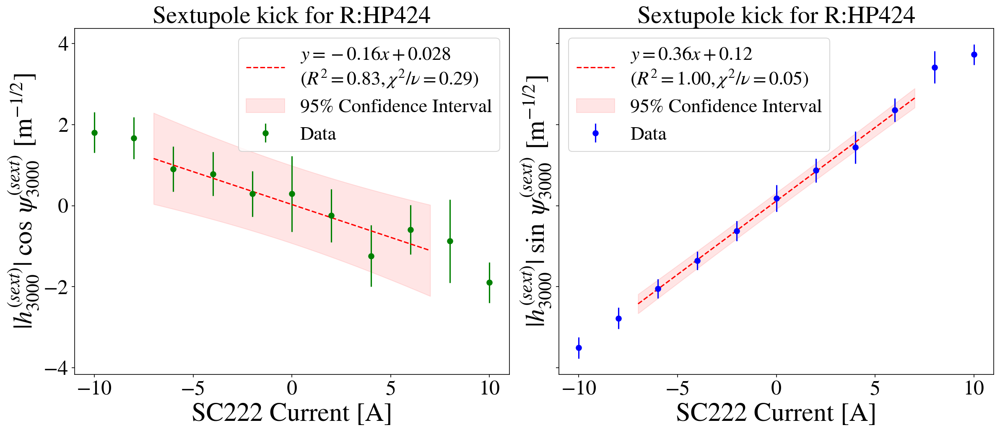

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


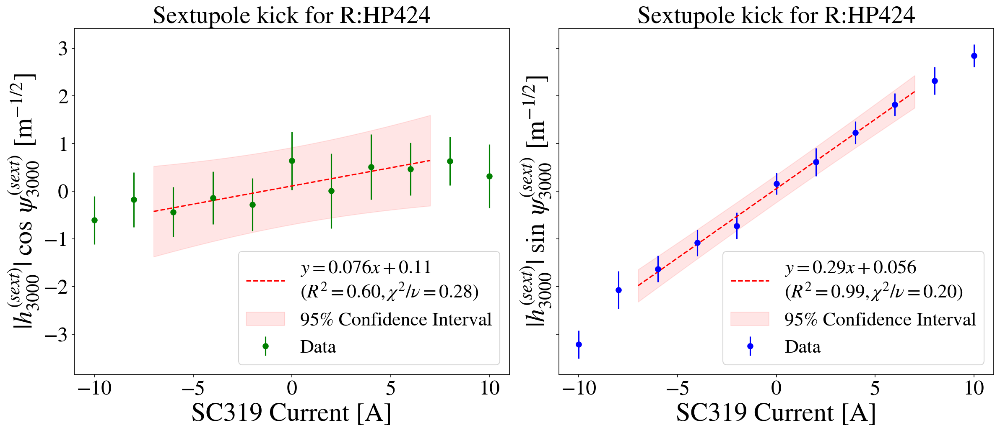

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


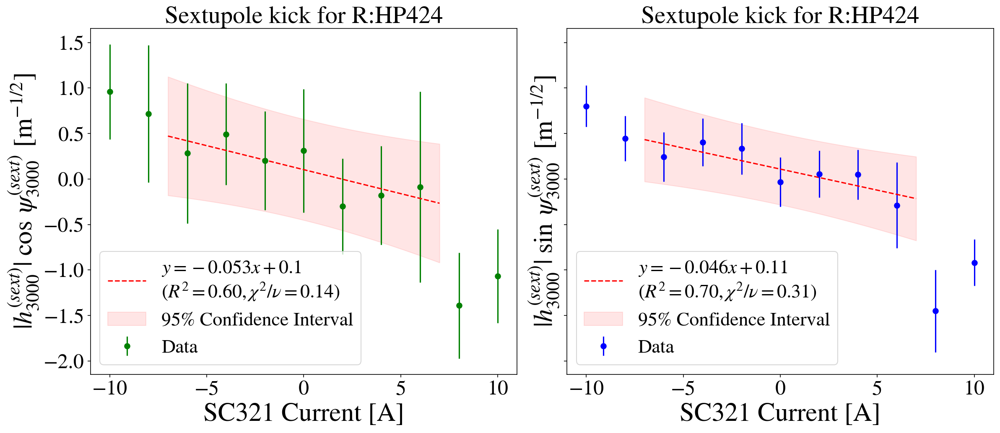

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


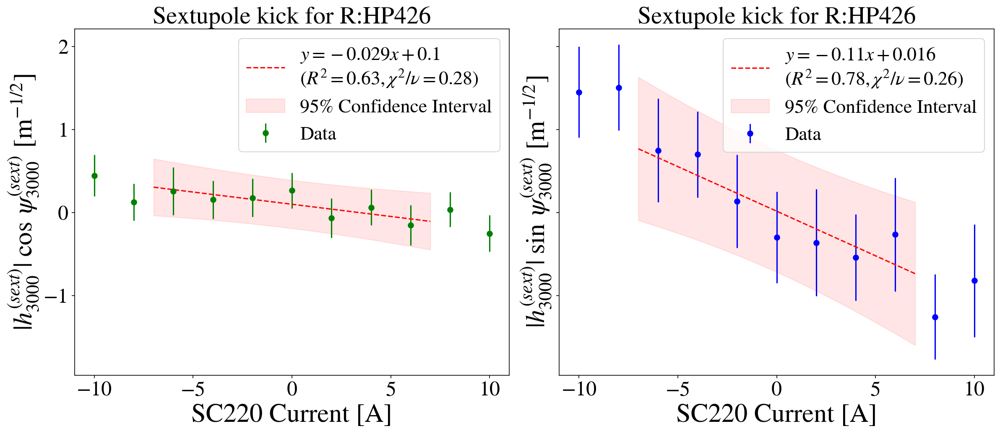

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


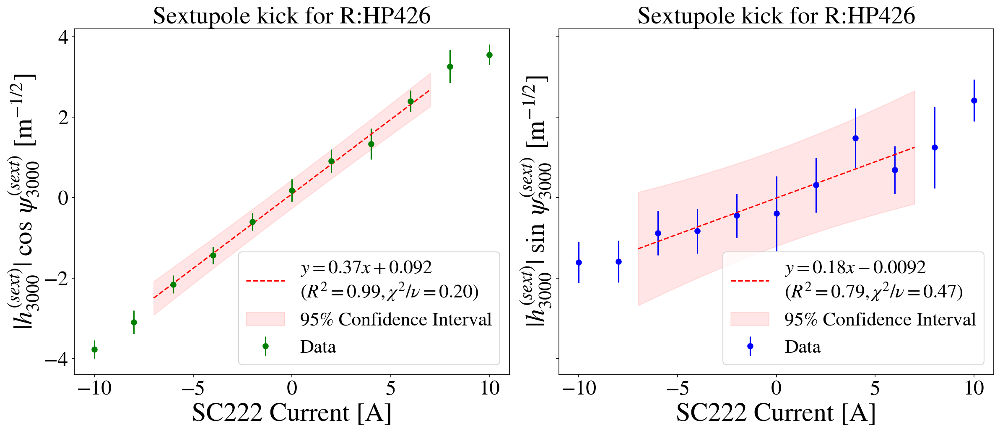

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


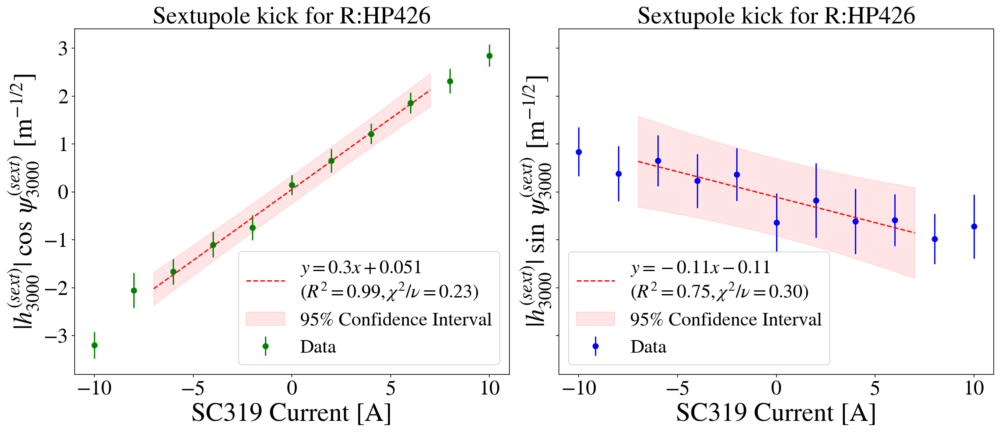

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


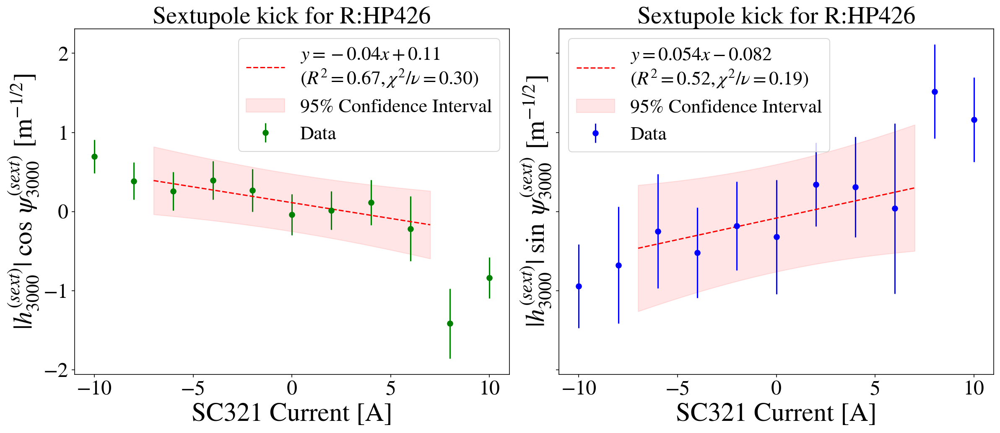

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


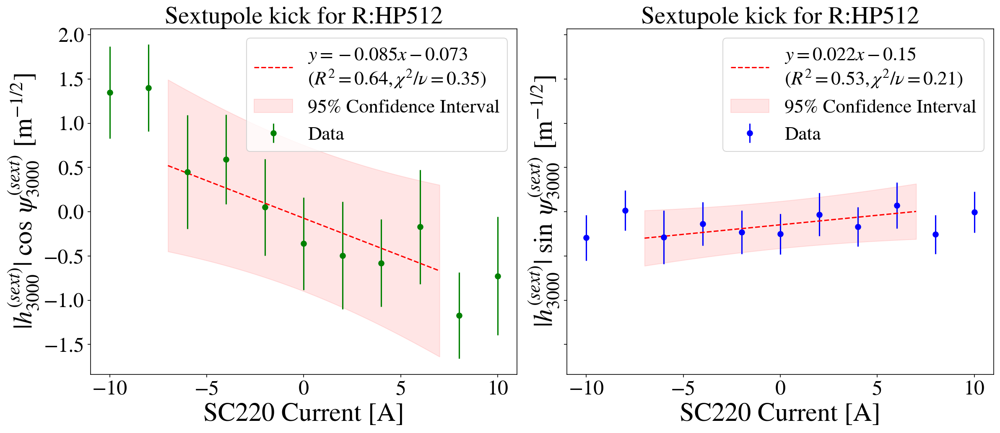

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


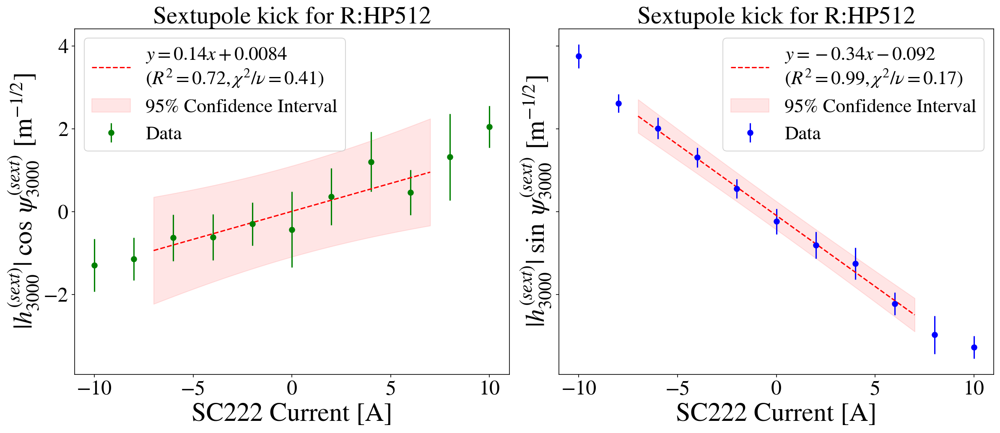

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


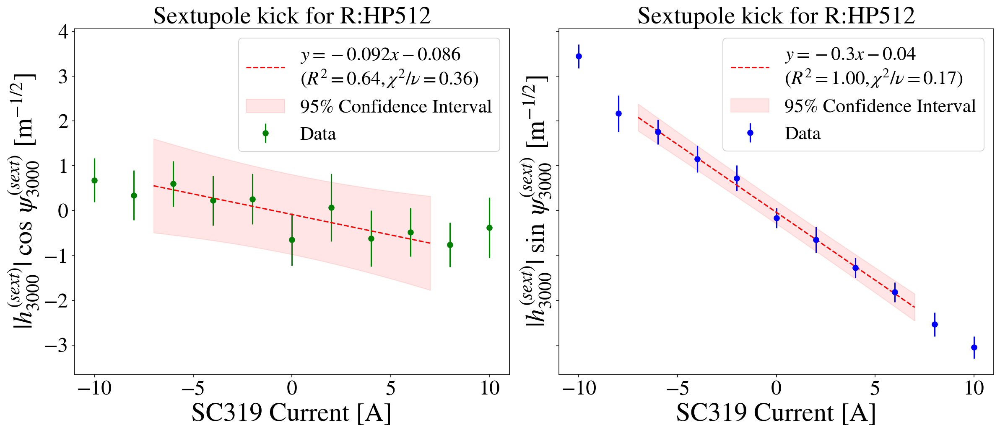

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


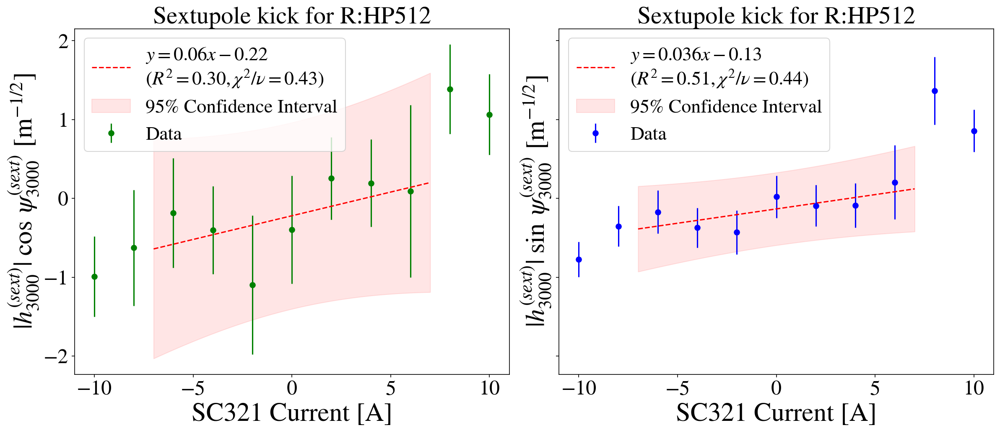

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


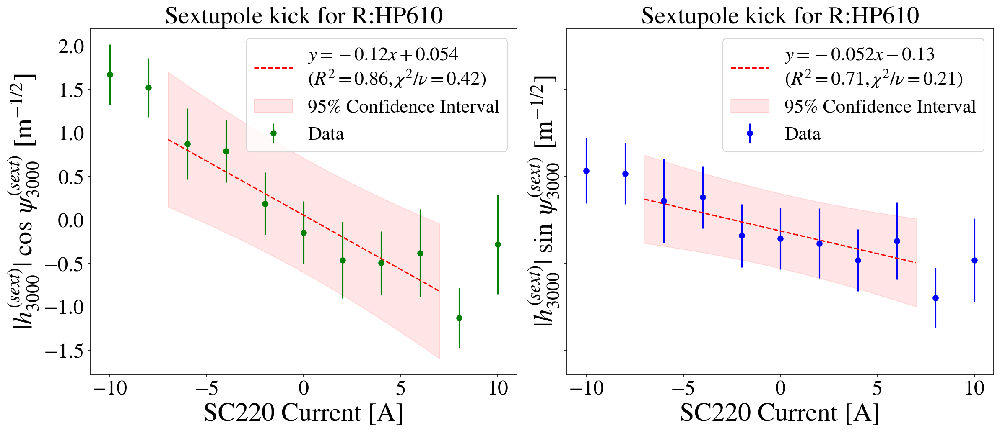

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.4465248122940704 0.3616312030735176 4
2.3719322591952885
0.8115908673121964 0.2028977168280491 4


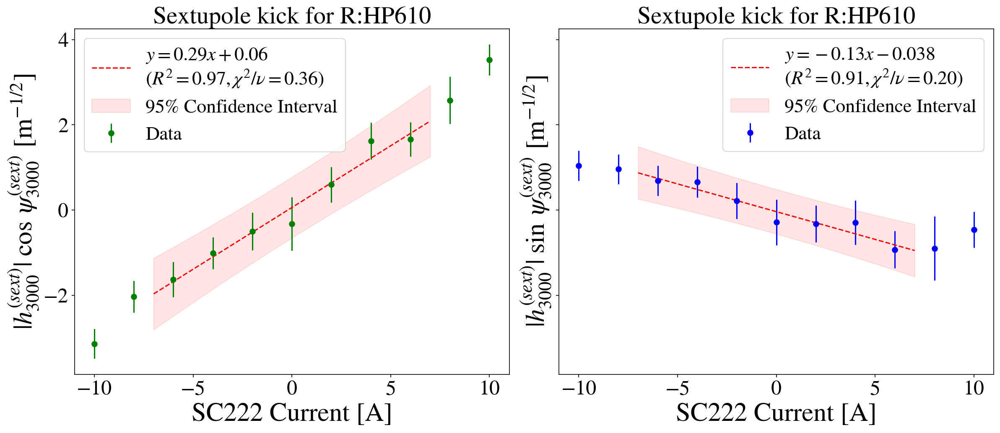

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


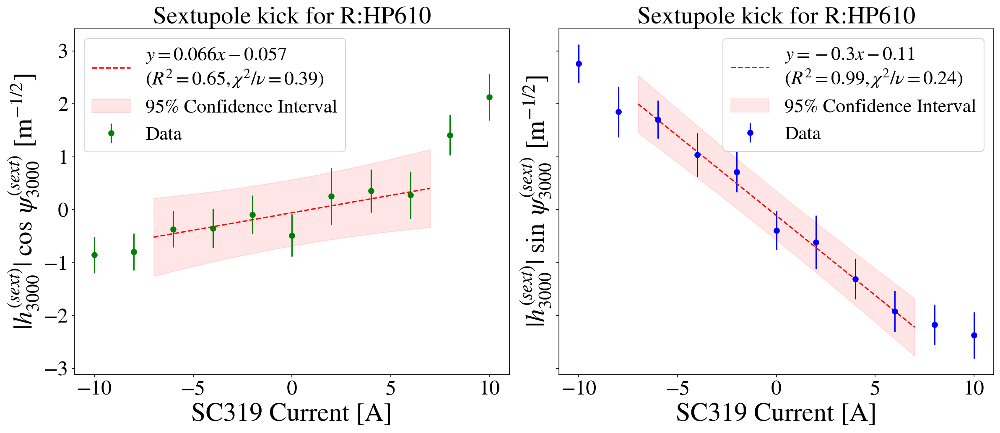

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


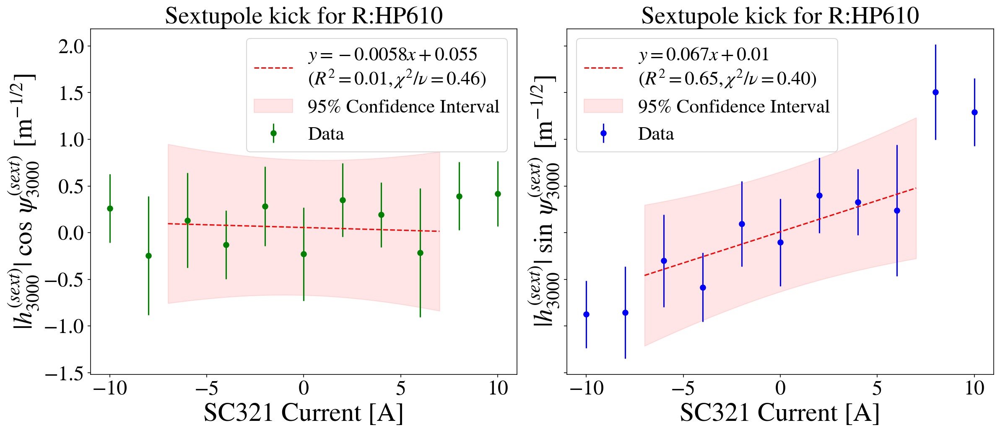

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.029354684449724 0.257338671112431 4
2.3719322591952885
1.9989341715599211 0.4997335428899803 4


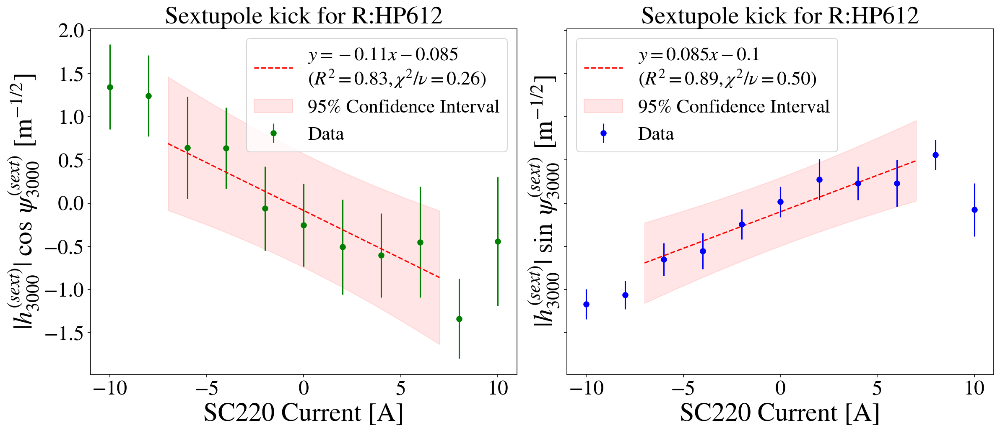

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


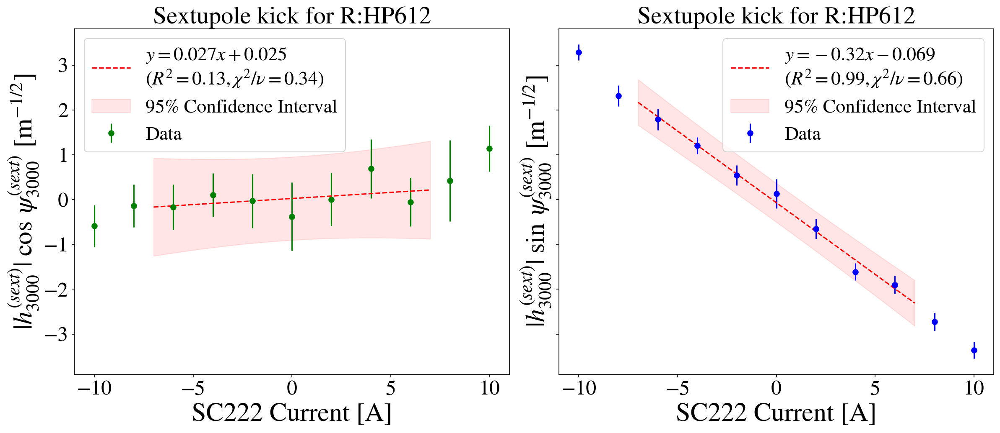

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.474258514989398 0.3685646287473495 4
2.3719322591952885
2.161673619563582 0.5404184048908955 4


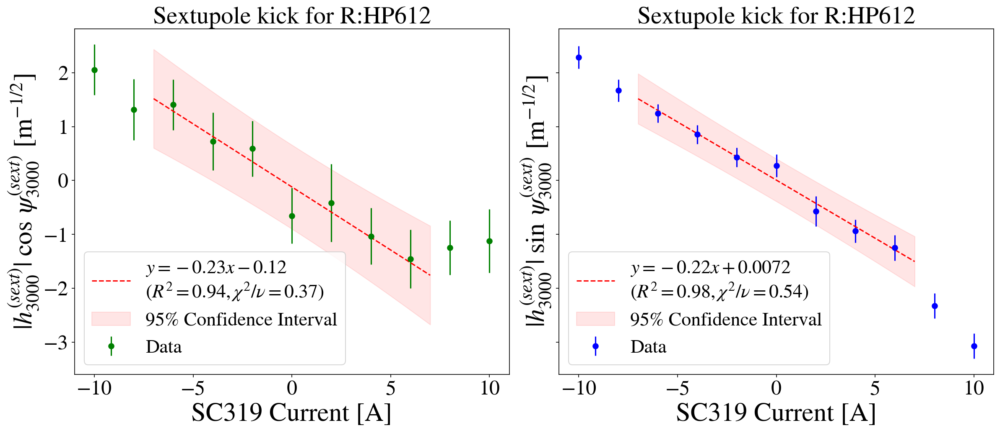

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


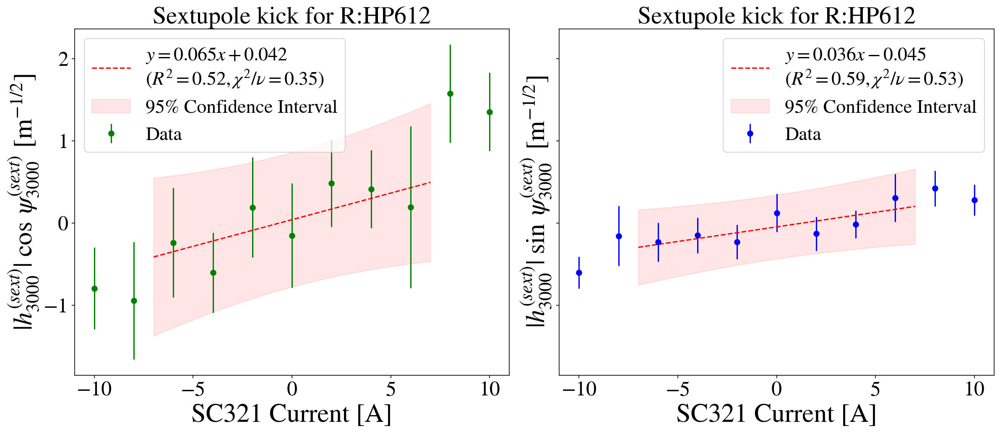

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.6593109328966267 0.6648277332241567 4
2.3719322591952885
1.175476350410575 0.29386908760264374 4


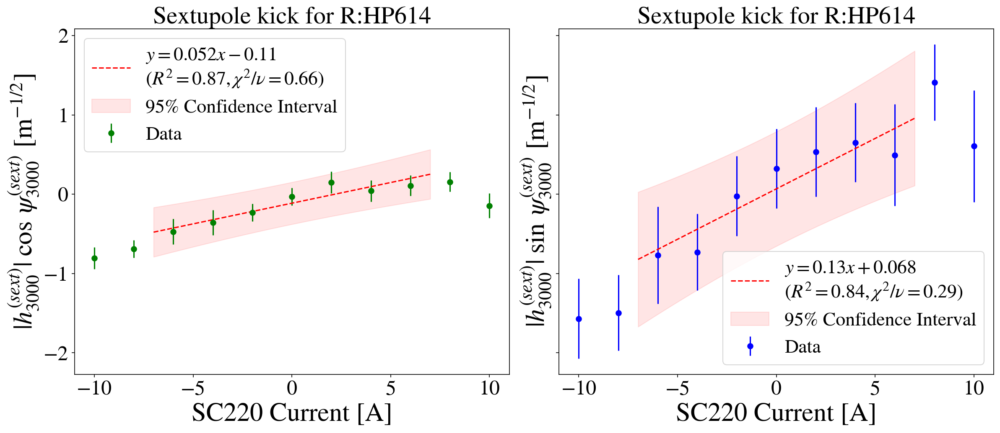

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


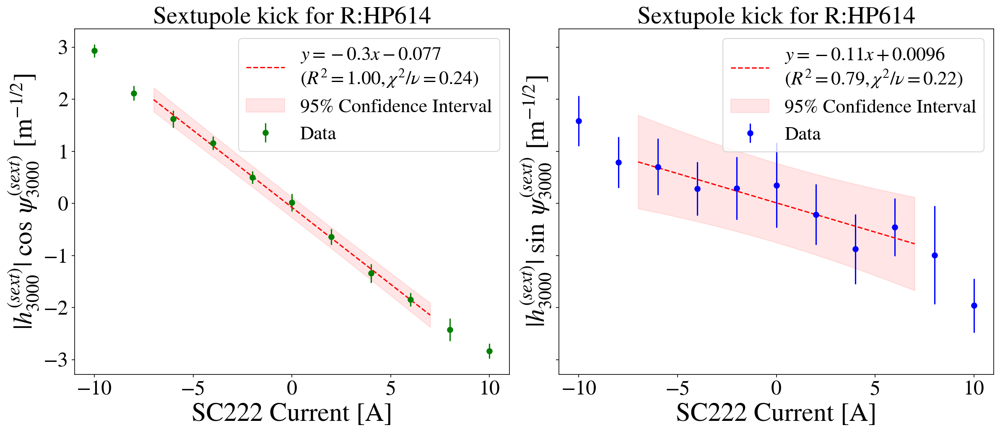

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.7445985157071893 0.6861496289267973 4
2.3719322591952885
1.461492824044427 0.36537320601110673 4


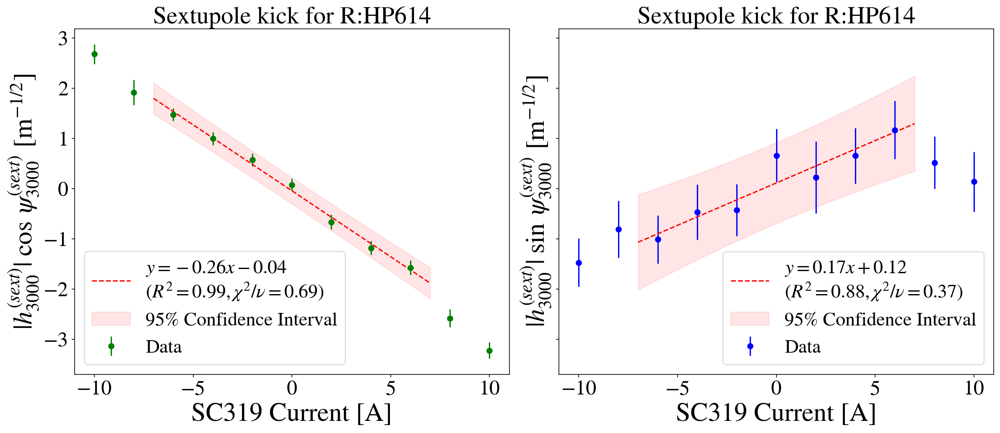

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


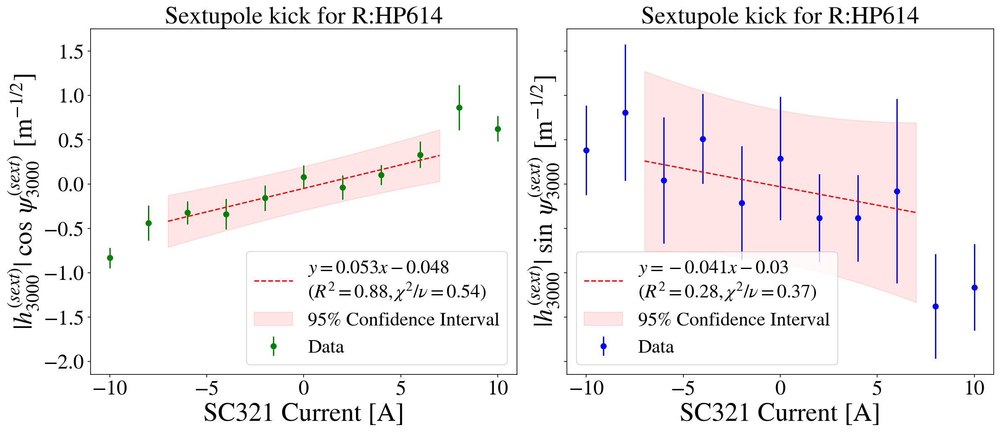

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


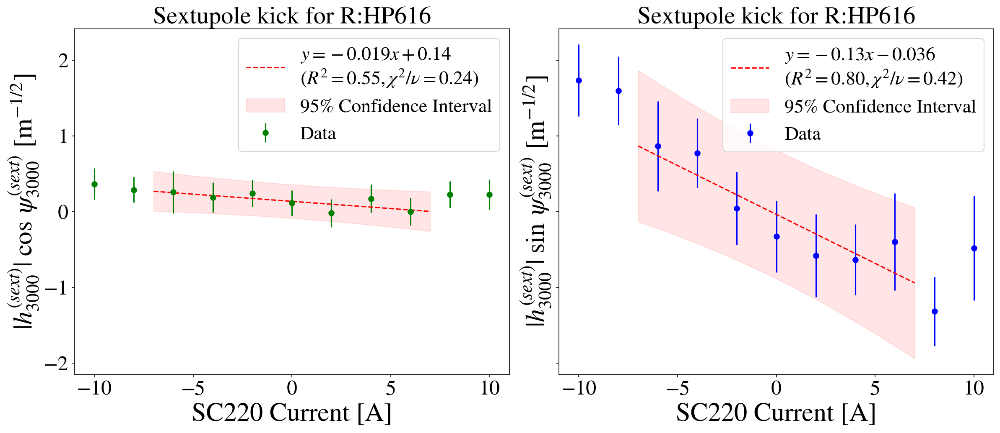

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.1962891604325347 0.2990722901081337 4
2.3719322591952885
1.6060260319144097 0.40150650797860243 4


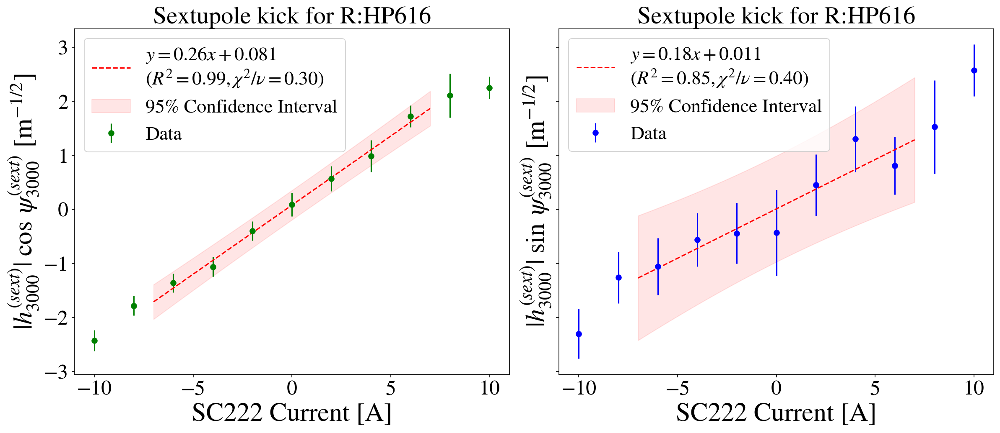

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


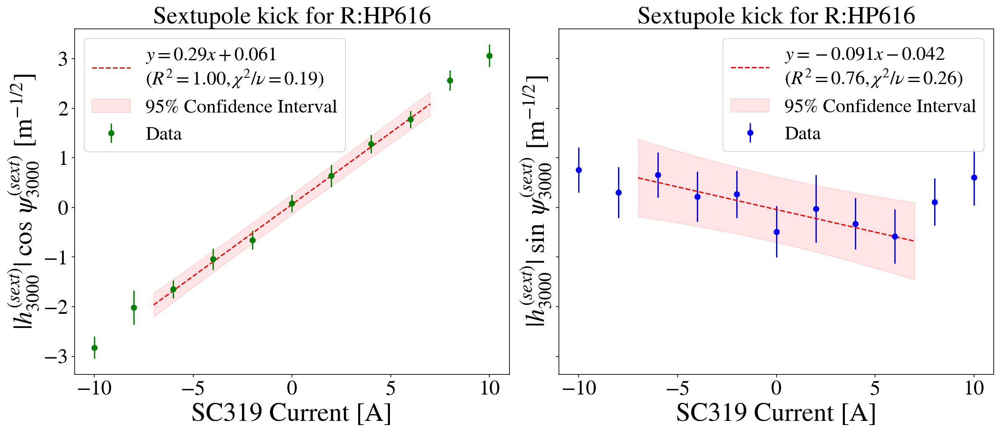

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


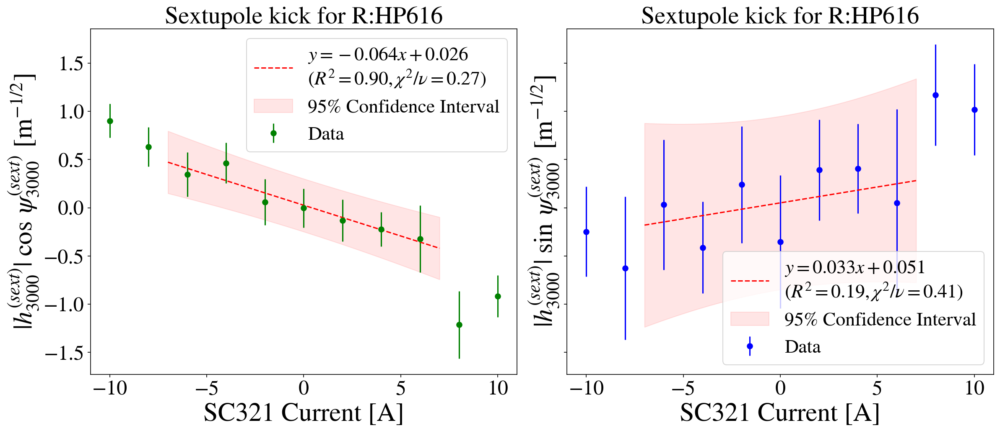

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


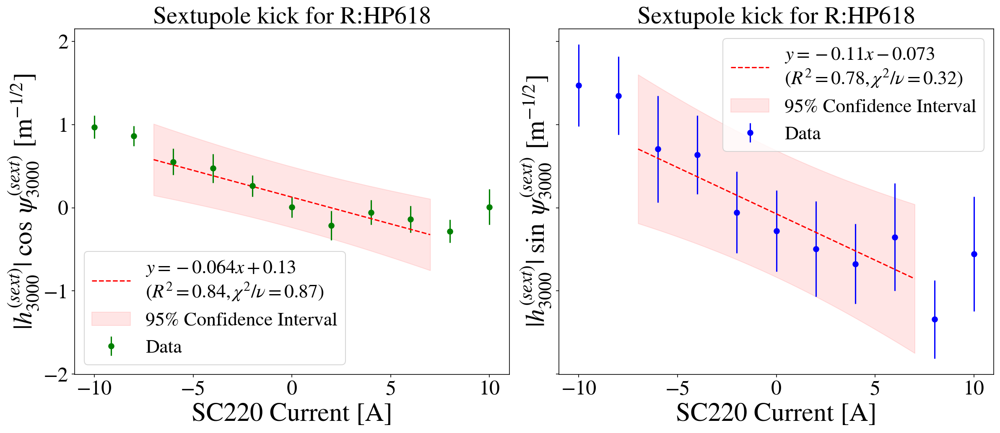

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


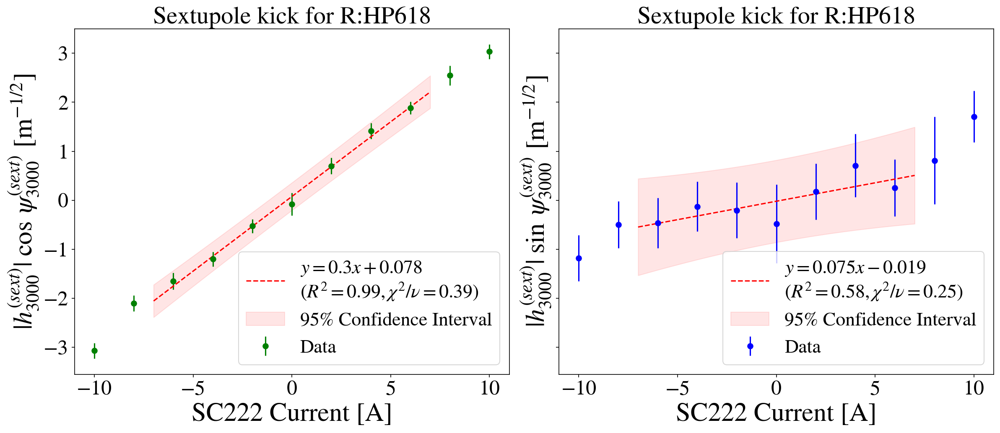

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.4159915476709704 0.6039978869177426 4
2.3719322591952885
0.8607208162537902 0.21518020406344754 4


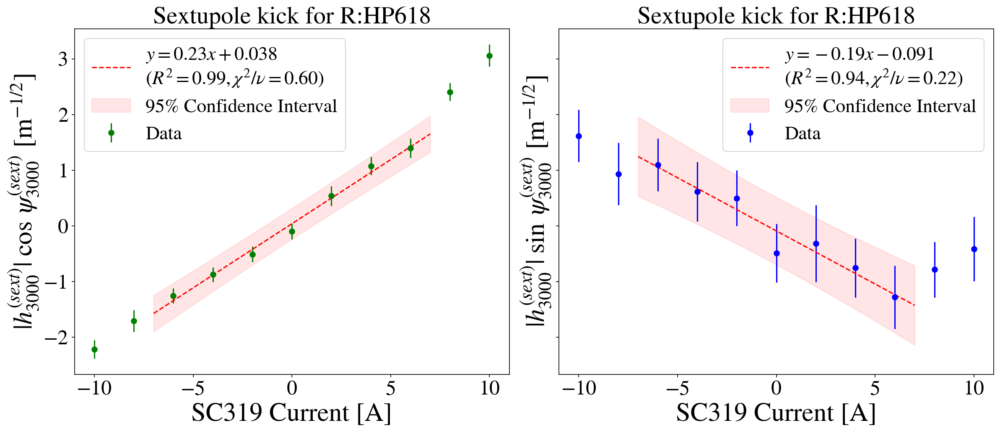

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


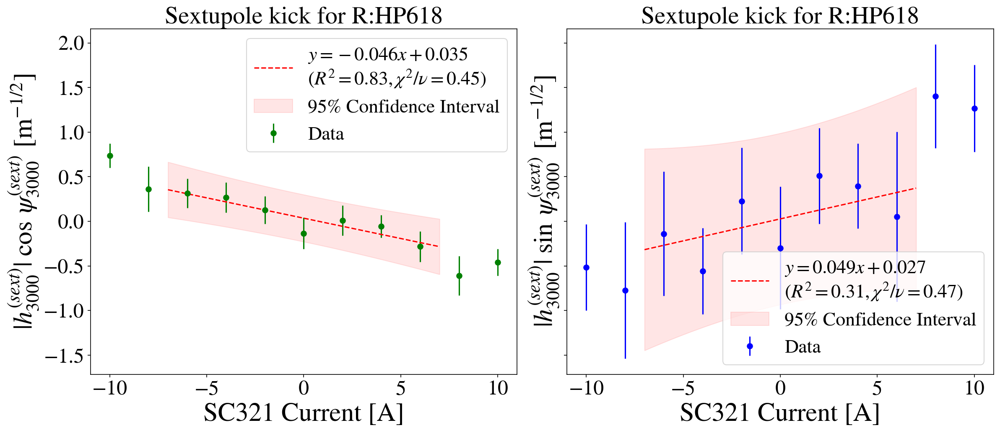

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


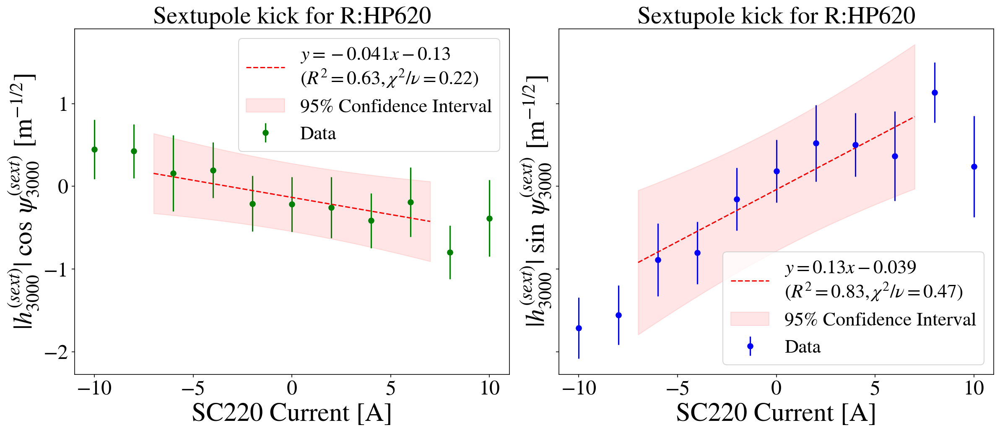

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.2355827847460663 0.3088956961865166 4
2.3719322591952885
1.9360649966153103 0.48401624915382757 4


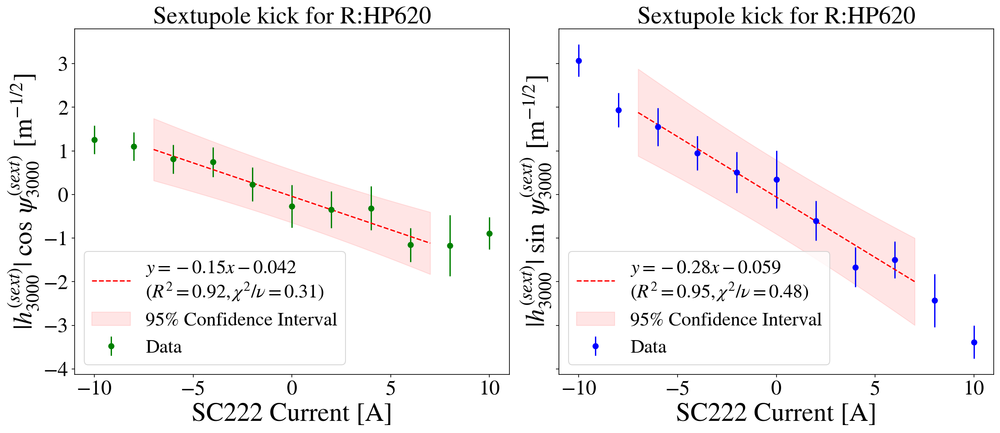

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


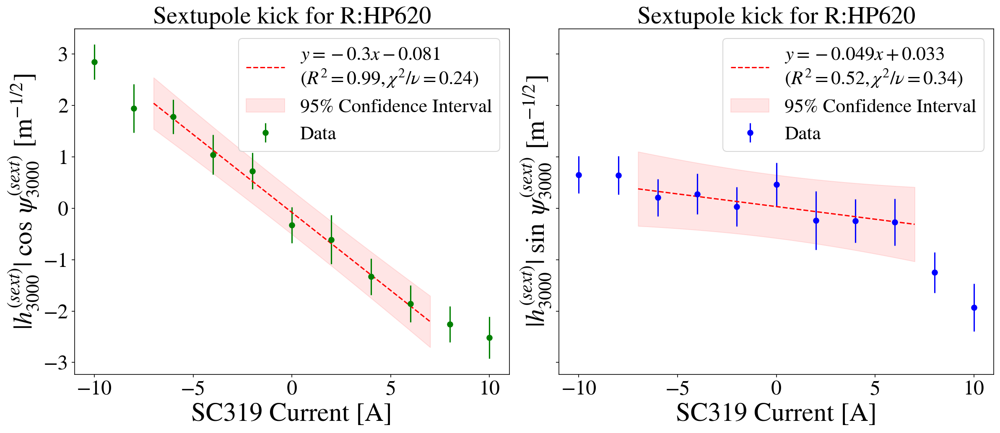

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


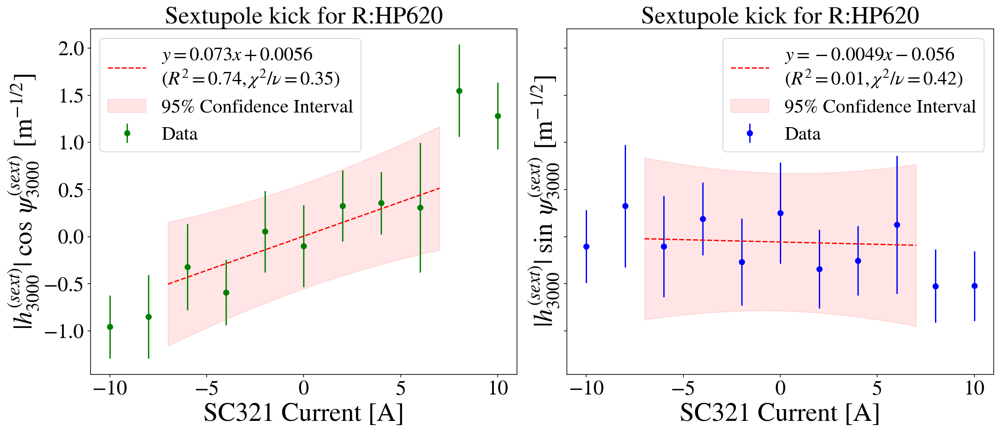

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


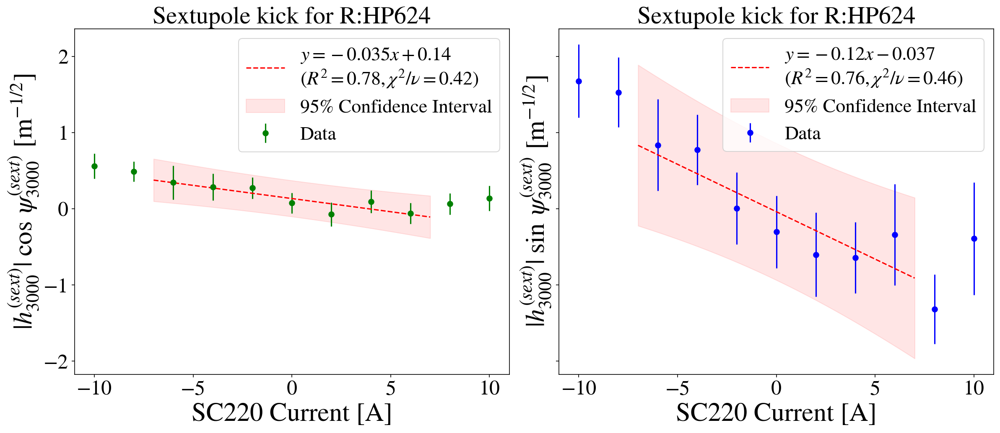

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.1095816293411918 0.27739540733529794 4
2.3719322591952885
1.4970009729465295 0.37425024323663236 4


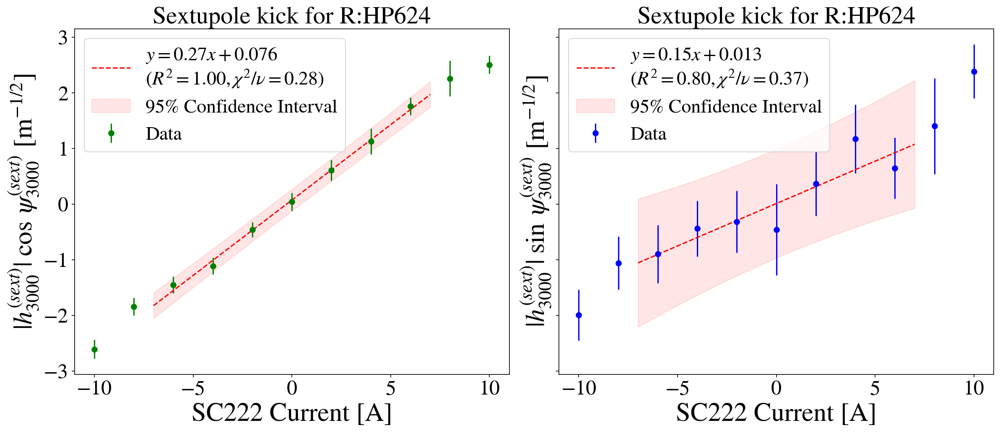

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.4028405318768633 0.3507101329692158 4
2.3719322591952885
0.884051334808463 0.22101283370211575 4


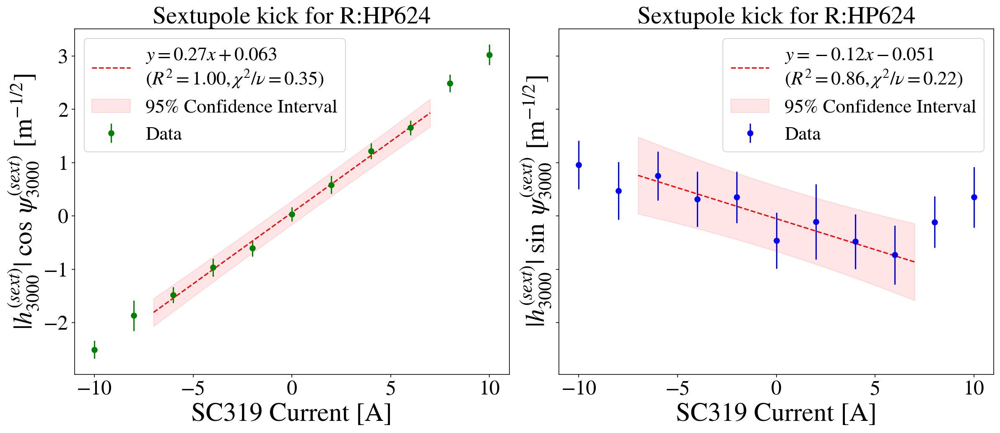

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


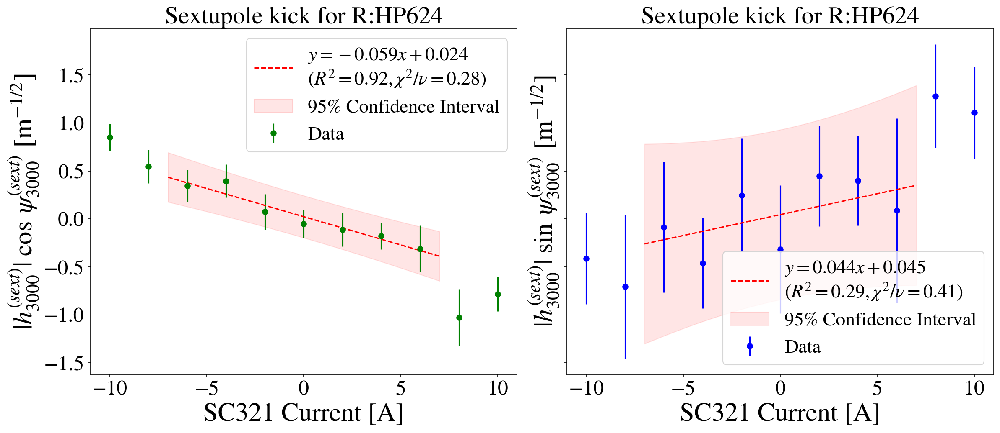

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


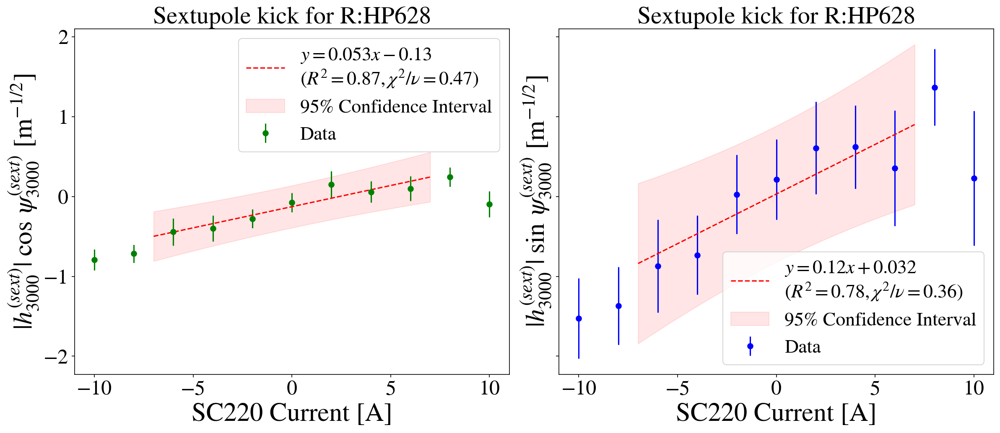

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


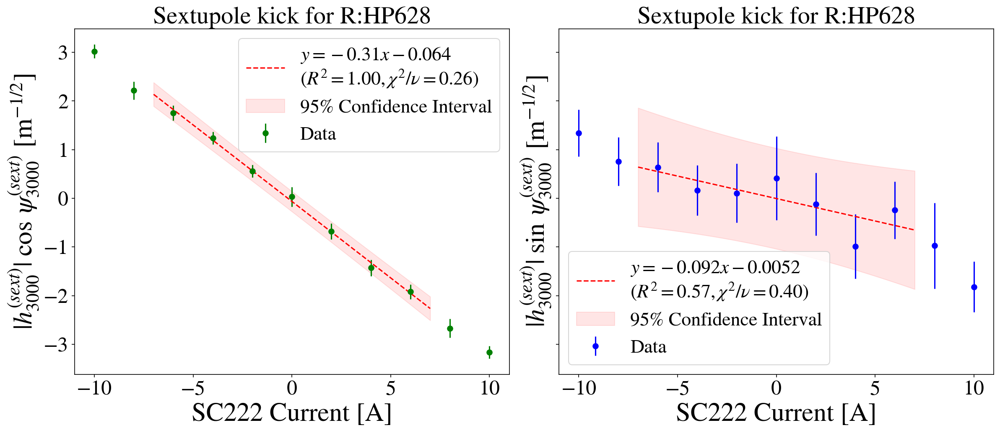

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.1732109628467655 0.5433027407116914 4
2.3719322591952885
1.4669088160565402 0.36672720401413506 4


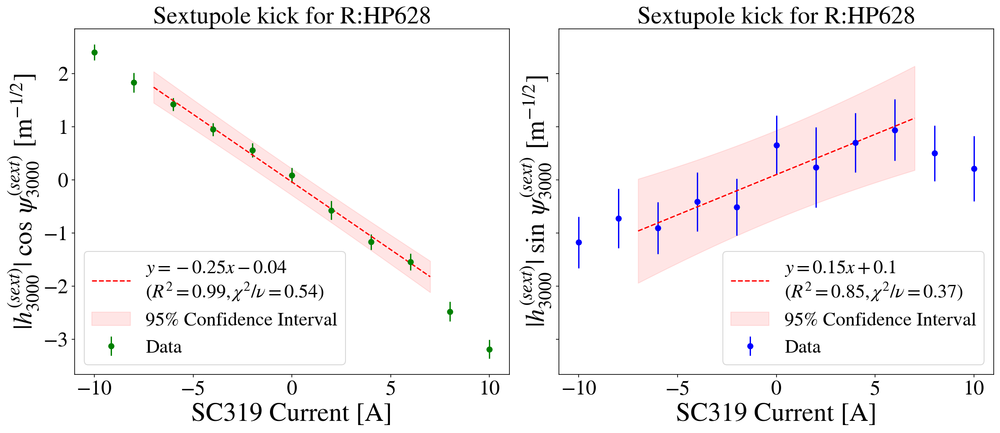

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


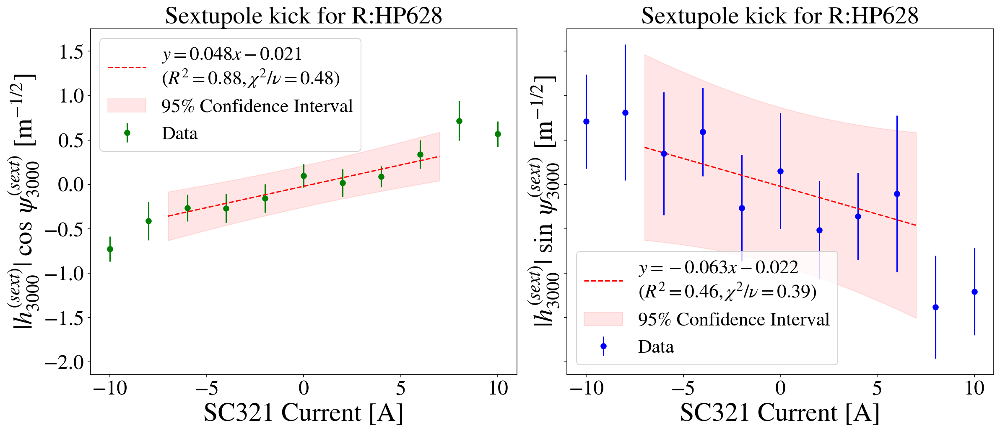

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
0.9063992230053985 0.22659980575134964 4
2.3719322591952885
1.5992993769757713 0.3998248442439428 4


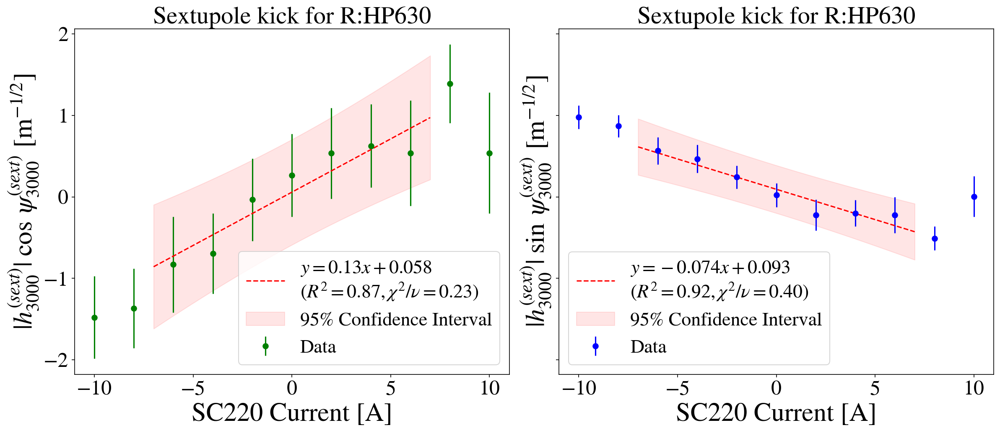

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


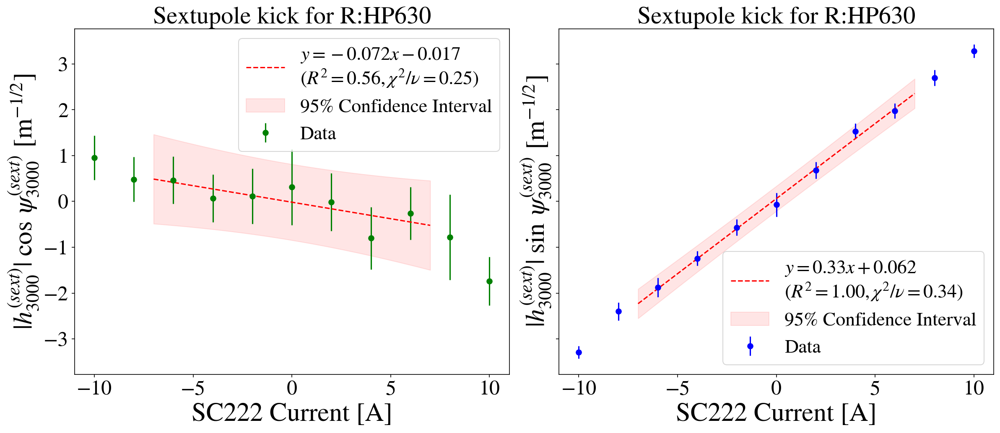

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.6597431218730214 0.41493578046825536 4
2.3719322591952885
3.107870359088671 0.7769675897721677 4


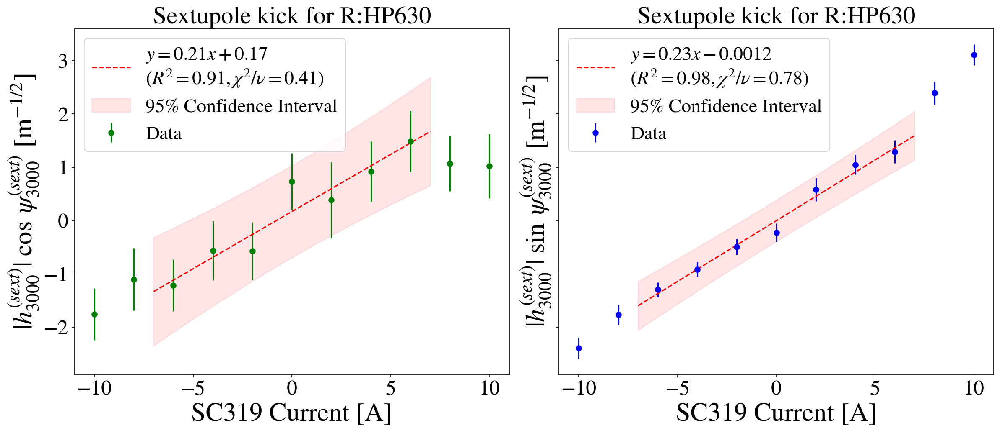

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


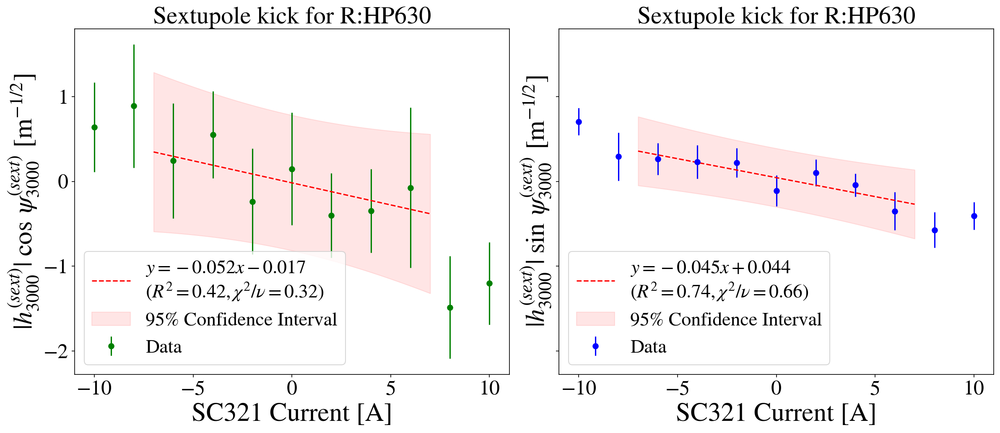

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


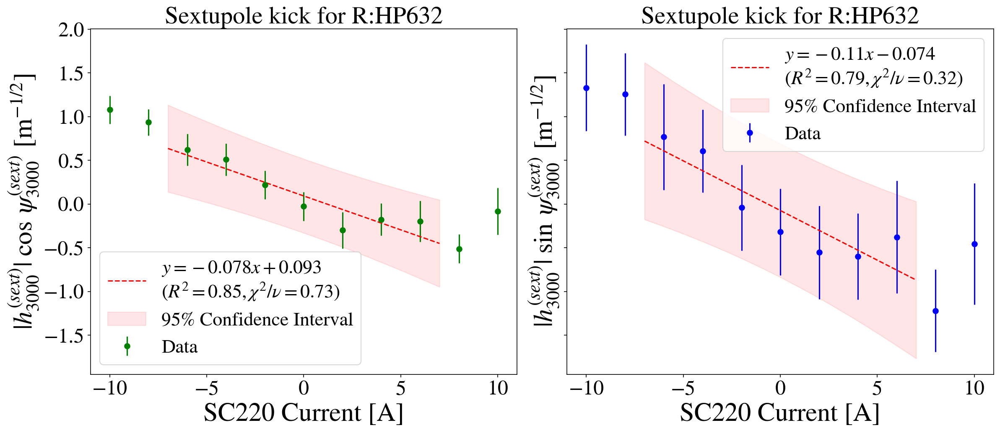

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


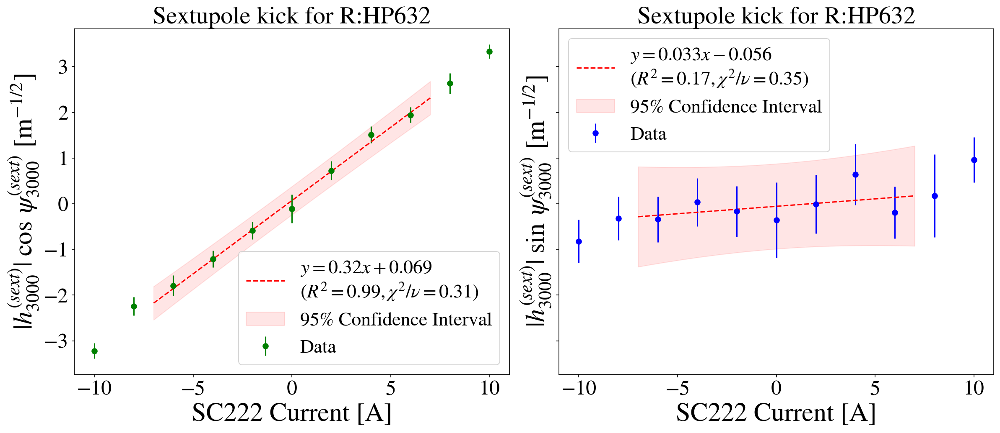

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
2.6468742791311586 0.6617185697827896 4
2.3719322591952885
1.2059498140066196 0.3014874535016549 4


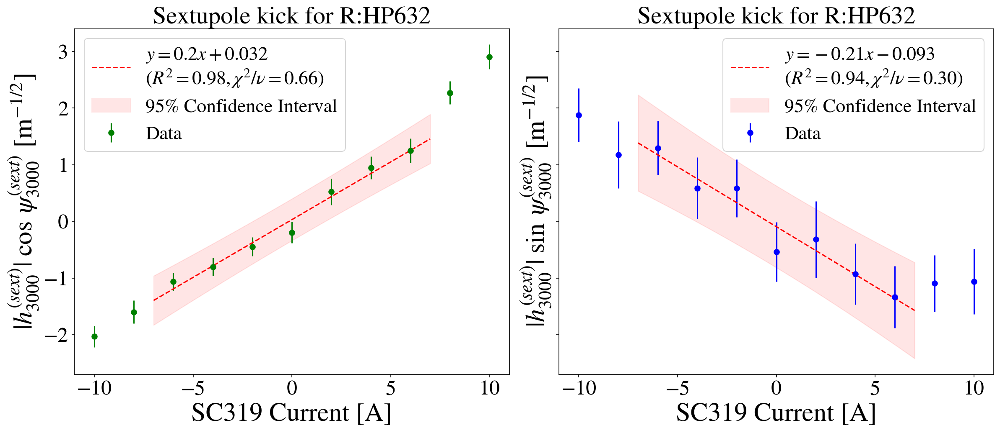

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


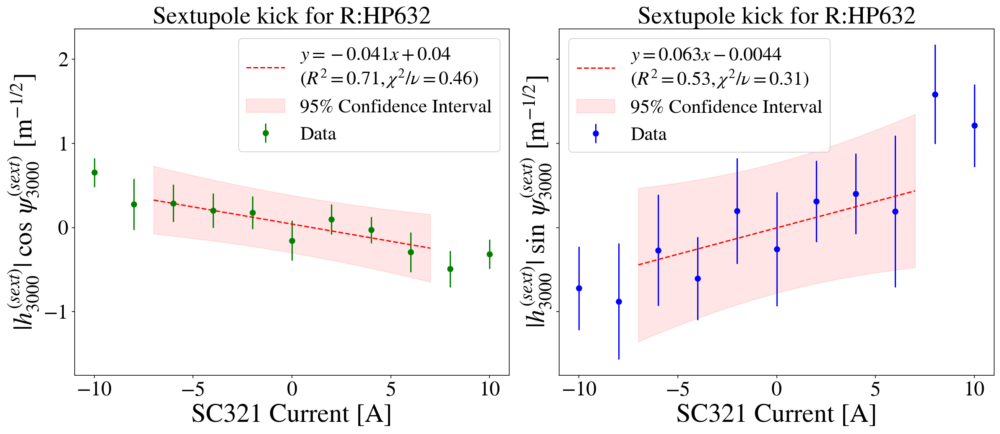

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


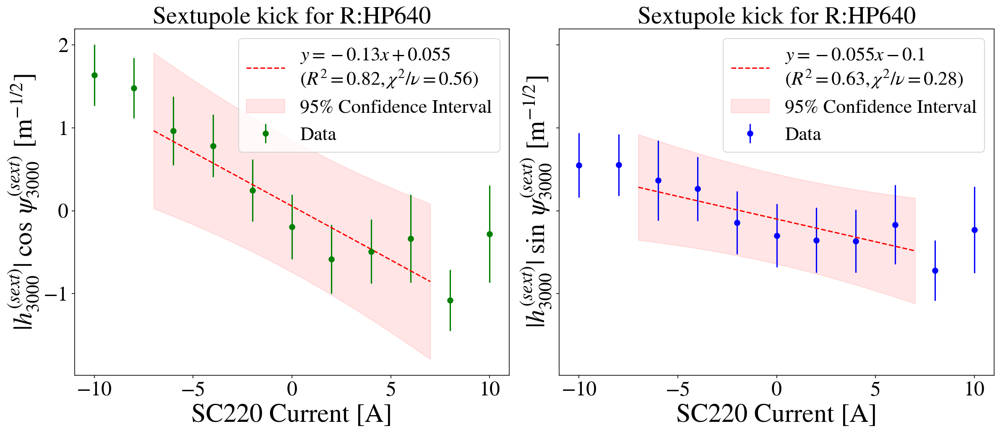

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


2.3719322591952885
1.0584386616351429 0.2646096654087857 4
2.3719322591952885
0.8541865903125134 0.21354664757812836 4


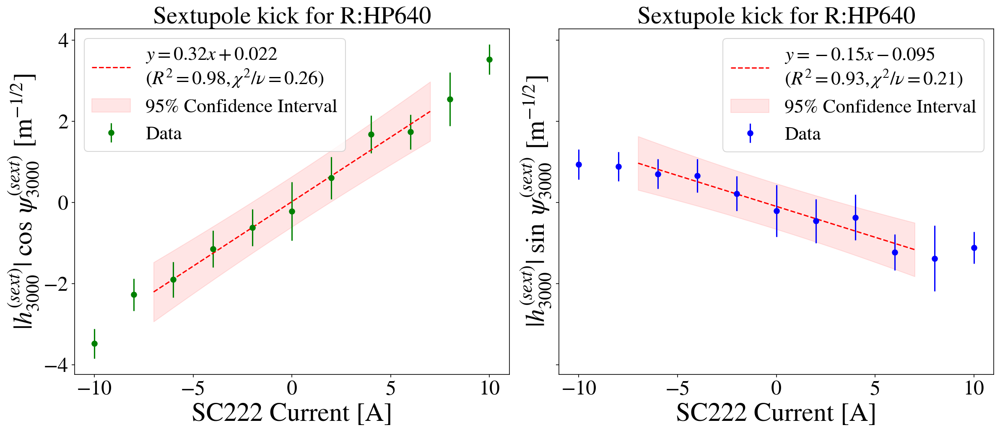

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


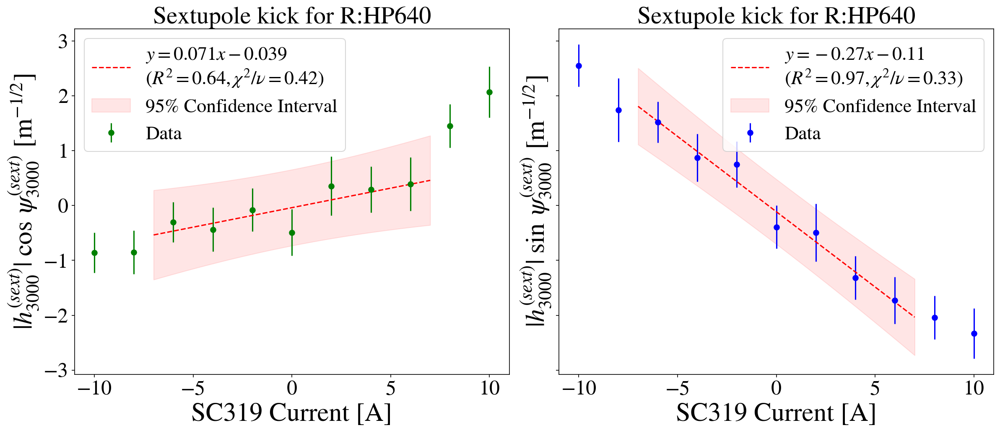

/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:48: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
/var/folders/3d/pnyvn_yx0v76lxfnqkf1vt1r0000j7/T/ipykernel_9836/1111499693.py:98: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))


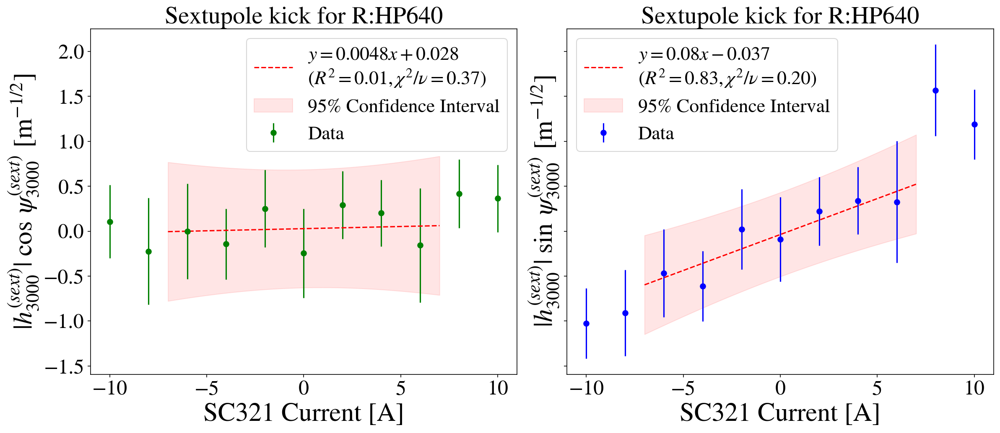

In [9]:
for bpmi in worthy:
    
    for sc in folders:
        
        dfplot = hsext[(hsext['sext'] == sc) & (hsext['bpm'] == bpmi)]
        currents = np.unique(dfplot['sext-current'])
        currentsfull = np.unique(dfplot['sext-current'])
        
        currlimlow = -7
        currlimhigh = 7
        currents = currentsfull[[i<currlimhigh for i in currentsfull]]
        currents = currents[[i>currlimlow for i in currents]]
        
        maski = [(i<currlimhigh)*(i>currlimlow) for i in currentsfull]
        
        # Start of plots
        # -----------------------------------------------------------------------------
        # -----------------------------------------------------------------------------
        
        fig,(ax1,ax2) = plt.subplots(1,2, figsize=(16,7), sharey = True)
        fig.set_dpi(150)
        
        # Plot for real part of sextupole kick
        ax1.errorbar(currentsfull, 1000*dfplot['real'], yerr = 1000*np.divide(dfplot['real-std'],np.sqrt(dfplot['vectors'])), 
                     fmt = 'o', color = 'green', label = 'Data')
        
        # Calculate R2 of regression
        xdata1 = np.array(currents).reshape(-1,1)
        ydata1 = dfplot[maski]['real']
        
        reg1 = LinearRegression().fit(xdata1,ydata1)
        xplot1 = np.linspace(min(currents)-1,max(currents)+1).reshape(-1,1) 
        r2score1 = reg1.score(xdata1, ydata1)
        
        # Calculate Chi2 of linear regression
        chi2_1, redchi2_1, nu1 = chisquare_var(yobs = ydata1, yfit = reg1.predict(xdata1), 
                                        syvar = np.divide(dfplot['real-std'],np.sqrt(dfplot['vectors'])), 
                                        fitted_params = 2)
        
        alpha = 0.05
        
        redchi2alpha1 = chi2.ppf(1-alpha,nu1)/nu1
        #print(chi2.ppf(1-alpha,nu1)/nu1)
        #print(chi2_1, redchi2_1, nu1)
        
        # Plot data and linear regression
        ax1.plot(xplot1, 1000*reg1.predict(xplot1), color = 'red', linestyle = 'dashed', 
                 label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))
        
        # OLS Regression 1
        xdata1 = sm.add_constant(xdata1)
        model1 = sm.OLS(ydata1, xdata1)
        results1 = model1.fit()
        ypredict1 = results1.get_prediction(sm.add_constant(xplot1))
        yplot1 = ypredict1.predicted_mean
        yplotlow1 = ypredict1.summary_frame()["obs_ci_lower"]
        yplothigh1 = ypredict1.summary_frame()["obs_ci_upper"]
        
        
        #ax1.plot(xplot1, 1000*yplot1, color = 'red', linestyle = 'dashed')
        ax1.fill_between(xplot1.reshape(1,-1)[0], 1000*yplotlow1, 1000*yplothigh1, color = 'red', alpha = 0.1, 
                         label = '95% Confidence Interval')
        #ax1.plot(xplot1, yplotlow1, color = 'red', linestyle = 'dashed')
        #ax1.plot(xplot1, yplothigh1, color = 'red', linestyle = 'dashed')
        
        
        #model.predict
        
        ax1.tick_params(axis='x', labelsize = 24)
        ax1.tick_params(axis='y', labelsize = 24)
        ax1.set_title('Sextupole kick for %s'%bpmi, fontsize = 28)
        ax1.set_ylabel(r'$|h^{(sext)}_{3000}| \; \cos \; \psi^{(sext)}_{3000} $ [m$^{-1/2}$]', fontsize = 30)
        ax1.set_xlabel(sc.upper()+ ' Current [A]', fontsize = 30)
        ax1.legend(fontsize = 22)
        
        # -----------------------------------------------------------------------------
        
        # Plot for imaginary part of sextupole kick
        ax2.errorbar(currentsfull, 1000*dfplot['imag'], yerr =  1000*np.divide(dfplot['imag-std'],np.sqrt(dfplot['vectors'])), 
                     fmt = 'o', color = 'blue', label = 'Data')
        
        xdata2 = np.array(currents).reshape(-1,1)
        ydata2 = dfplot[maski]['imag']
        reg2 = LinearRegression().fit(xdata2,ydata2)
        xplot2 = np.linspace(min(currents)-1,max(currents)+1).reshape(-1,1)
        r2score2 = reg2.score(xdata2, ydata2)
        
        # Calculate Chi2 of linear regression
        chi2_2, redchi2_2, nu2 = chisquare_var(yobs = ydata2, yfit = reg2.predict(xdata2), 
                                        syvar = np.divide(dfplot['imag-std'],np.sqrt(dfplot['vectors'])), 
                                        fitted_params = 2)
        
        redchi2alpha2 = chi2.ppf(1-alpha,nu2)/nu2
        #print(chi2.ppf(1-alpha,nu2)/nu2)
        #print(chi2_2, redchi2_2, nu2)
        
        ax2.plot(xplot2, 1000*reg2.predict(xplot2), color = 'red', linestyle = 'dashed', 
                 label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))
        
        # OLS Regression 2
        xdata2 = sm.add_constant(xdata2)
        model2 = sm.OLS(ydata2, xdata2)
        results2 = model2.fit()
        ypredict2 = results2.get_prediction(sm.add_constant(xplot2))
        yplot2 = ypredict2.predicted_mean
        yplotlow2 = ypredict2.summary_frame()["obs_ci_lower"]
        yplothigh2 = ypredict2.summary_frame()["obs_ci_upper"]
        
        #ax2.plot(xplot2, 1000*yplot2, color = 'red', linestyle = 'dashed')
        ax2.fill_between(xplot2.reshape(1,-1)[0], 1000*yplotlow2, 1000*yplothigh2, color = 'red', alpha = 0.1, 
                         label = '95% Confidence Interval')
        
        
        ax2.tick_params(axis='x', labelsize = 24)
        ax2.tick_params(axis='y', labelsize = 24)
        ax2.set_title('Sextupole kick for %s'%bpmi, fontsize = 28)
        ax2.set_ylabel(r'$|h^{(sext)}_{3000}| \; \sin \; \psi^{(sext)}_{3000} $ [m$^{-1/2}$]', fontsize = 30)
        ax2.set_xlabel(sc.upper()+ ' Current [A]', fontsize = 30)
        ax2.legend(fontsize = 22)
        
        # try:
        #     os.makedirs(sc+'/hsext-vs-I')
        # except:
        #     #print('Directory already exists')
        #     pass
        
        fig.patch.set_facecolor('white')
        plt.tight_layout()
        
        if (redchi2_1<redchi2alpha1) and (redchi2_2<redchi2alpha2):
            if (r2score1>0.8) and (r2score2>0.8):
                    print(chi2.ppf(1-alpha,nu1)/nu1)
                    print(chi2_1, redchi2_1, nu1)
                    
                    print(chi2.ppf(1-alpha,nu2)/nu2)
                    print(chi2_2, redchi2_2, nu2)
                    
                    #i = i+1
                    #plt.show()
        
        plt.show()
        #if bpmi=='R:HP622':
            #plt.show()
            #plt.savefig(sc+'/hsext-vs-I/hsext-vs-I-%s-%s'%(sc,bpmi[-5:]))
            
        #plt.savefig(sc+'/hsext-vs-I/hsext-vs-I-%s-%s'%(sc,bpmi[-5:]))
        plt.close()
        
        #break
    #break

[ 4.08967722 -4.08967722 -5.08812043  5.08812043]
[0.31447988 0.31447988 0.37427584 0.37427584]
[ 4.03941951 -4.03941951 -5.05276016  5.05276016]
[0.24177779 0.24177779 0.36953512 0.36953512]
[ 4.13702429 -4.13702429 -5.00795043  5.00795043]
[0.2948872  0.2948872  0.39095886 0.39095886]
[ 3.98136442 -3.98136442 -5.32227182  5.32227182]
[0.22935443 0.22935443 0.42663077 0.42663077]
[ 3.98354884 -3.98354884 -5.09118456  5.09118456]
[0.23440843 0.23440843 0.34762716 0.34762716]
[ 4.06391925 -4.06391925 -4.87193358  4.87193358]
[0.35642006 0.35642006 0.45556225 0.45556225]
[ 4.08517531 -4.08517531 -5.03903179  5.03903179]
[0.27125631 0.27125631 0.36668188 0.36668188]
[ 3.91764033 -3.91764033 -5.25429756  5.25429756]
[0.23729205 0.23729205 0.4443559  0.4443559 ]
[ 4.09836605 -4.09836605 -4.83930514  4.83930514]
[0.30373358 0.30373358 0.45363373 0.45363373]
[ 4.18253414 -4.18253414 -4.90121665  4.90121665]
[0.26355476 0.26355476 0.39352942 0.39352942]
[ 4.0462385  -4.0462385  -4.78191692  4.

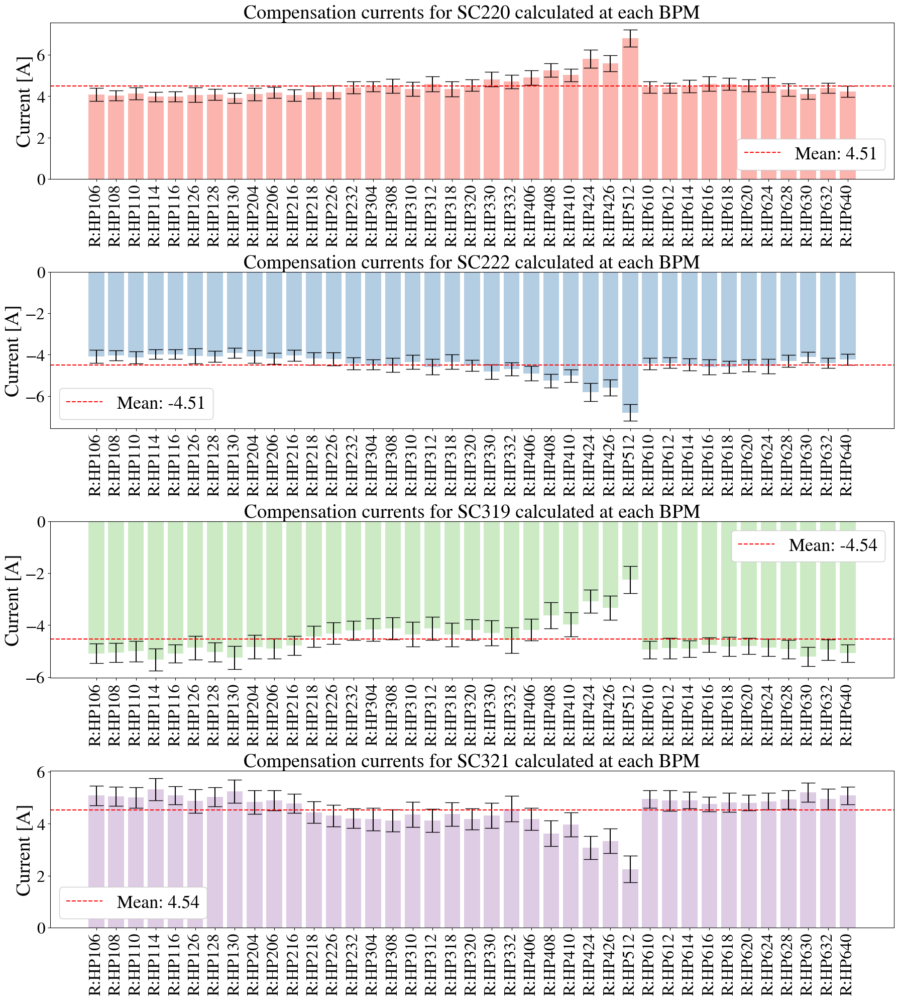

In [46]:
icompall = []
sigmaicompall = []
icompgood = []
bpmgood = []
bestr2 = 7.5

fig,(ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(18,20))

upper_limit = 7
lower_limit =-7

fint = True

for bpmi in worthy:

    # Create bare machine results and matrix to be solved for 
    dfbare0 = h3000bare[(h3000bare['sext-current'] == 0) & (h3000bare['bpm'] == bpmi)]
    #dfbare0 = hsext[(hsext['sext-current'] == 0) & (hsext['bpm'] == bpmi)]
    hampbare = np.mean(dfbare0['amplitude'])
    hampstd = np.array(dfbare0['amplitude-std'])[0]
    hphasebare = circmean(dfbare0['phase'])
    hphasestd = np.array(dfbare0['phase-std'])[0]
    
    hvec = np.array([-hampbare*np.cos(hphasebare), -hampbare*np.sin(hphasebare), 0, 0])
    
    # Error propagation for bare vector
    sxh21 = np.square(np.multiply(np.cos(hphasebare),hampstd))
    sxh22 = np.square(np.multiply(hampbare, np.multiply(np.sin(hphasebare), hphasestd)))
    
    syh21 = np.square(np.multiply(np.sin(hphasebare),hampstd))
    syh22 = np.square(np.multiply(hampbare, np.multiply(np.cos(hphasebare), hphasestd)))
    
    nn = np.array(dfbare0['vectors'])[0]
    
    sigmahvec = np.array([np.sqrt(sxh21+sxh22)/np.sqrt(nn),
                          np.sqrt(syh21+syh22)/np.sqrt(nn),
                          0,
                          0])
    
    mmatrix = np.zeros((4,4))
    mmatrix[2,0] = 1
    mmatrix[2,1] = 1
    mmatrix[3,2] = 1
    mmatrix[3,3] = 1
    
    deltam = np.zeros((4,4))
    
    for sc in folders:
        
        # Calculate linear regressions for real and imaginary part
        dfplot = hsext[(hsext['sext'] == sc) & (hsext['bpm'] == bpmi)]        
        
        #-----------------------------------------------------------
        dffit1 = dfplot[(dfplot['sext-current']<upper_limit) & (dfplot['sext-current']>lower_limit)]
        
        xdata1 = np.array(dffit1['sext-current']).reshape(-1,1)
        
        ydata1 = np.multiply(dffit1['amplitude'],np.cos(dffit1['phase']))
        sydata1 = np.divide(dffit1['real-std'],np.sqrt(dffit1['vectors']))
        
        reg1 = LinearRegression(fit_intercept = fint).fit(xdata1,ydata1)
    
        # OLS Regression 1
        xdata1 = sm.add_constant(xdata1)
        model1 = sm.OLS(ydata1, xdata1)
        results1 = model1.fit()
        
        deltamij1 = np.abs(results1.conf_int(alpha=0.05)[0]['x1'] - results1.conf_int(alpha=0.05)[1]['x1'])/(2*1.96) 
    
        #--------------------------------------------------------
        dffit2 = dfplot[(dfplot['sext-current']<upper_limit) & (dfplot['sext-current']>lower_limit)]
        
        xdata2 = np.array(dffit2['sext-current']).reshape(-1,1)
        
        ydata2 = np.multiply(dffit2['amplitude'],np.sin(dffit2['phase']))
        sydata2 = np.divide(dffit2['imag-std'],np.sqrt(dffit2['vectors']))
        
        reg2 = LinearRegression(fit_intercept = fint).fit(xdata2,ydata2)

        # OLS Regression 2
        xdata2 = sm.add_constant(xdata2)
        model2 = sm.OLS(ydata2, xdata2)
        results2 = model2.fit()
        
        deltamij2 = np.abs(results2.conf_int(alpha=0.05)[0]['x1'] - results2.conf_int(alpha=0.05)[1]['x1'])/(2*1.96)
        
        #-----------------------------------------------------------
        hvec = hvec #- np.array([1.*reg1.intercept_,1.*reg2.intercept_,0,0])
        
        if sc=='sc220':
            mmatrix[0,0] = reg1.coef_[0]
            mmatrix[1,0] = reg2.coef_[0]
            
            deltam[0,0] = deltamij1
            deltam[1,0] = deltamij2
            
        elif sc=='sc222':
            mmatrix[0,1] = reg1.coef_[0]
            mmatrix[1,1] = reg2.coef_[0]
            
            deltam[0,1] = deltamij1
            deltam[1,1] = deltamij2
           
        elif sc=='sc319':
            mmatrix[0,2] = reg1.coef_[0]
            mmatrix[1,2] = reg2.coef_[0]
            
            deltam[0,2] = deltamij1
            deltam[1,2] = deltamij2
              
        elif sc=='sc321':
            mmatrix[0,3] = reg1.coef_[0]
            mmatrix[1,3] = reg2.coef_[0]
            
            deltam[0,3] = deltamij1
            deltam[1,3] = deltamij2
            
    mmatrixinv = np.linalg.inv(mmatrix)
    sigmamatrixinv = np.sqrt(np.square(mmatrixinv @ deltam @ mmatrixinv))
    #print(sigmamatrixinv)
    
    icompi = mmatrixinv.dot(hvec)
    icompall.append(icompi)
    print(icompi)
    
    term1 = np.array([np.square(mmatrixinv)[i,:].dot(np.square(sigmahvec)) for i in np.arange(len(hvec))])
    term2 = np.array([np.square(hvec).dot(np.square(sigmamatrixinv)[i,:]) for i in np.arange(len(hvec))])
    sigmaicompi = np.sqrt(term1+term2)
    sigmaicompall.append(sigmaicompi)
    print(sigmaicompi)
    
    
    ax1.bar(bpmi, icompi[0], yerr=sigmaicompi[0], color=plt.cm.Pastel1(0), align="center", capsize=10)
    ax2.bar(bpmi, icompi[1], yerr=sigmaicompi[1], color=plt.cm.Pastel1(1), align="center", capsize=10)
    ax3.bar(bpmi, icompi[2], yerr=sigmaicompi[2], color=plt.cm.Pastel1(2), align="center", capsize=10)
    ax4.bar(bpmi, icompi[3], yerr=sigmaicompi[3], color=plt.cm.Pastel1(3), align="center", capsize=10)
    
    
icompall = np.array(icompall)  

ax1.axhline(np.mean(icompall[:,0]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,0]))
ax2.axhline(np.mean(icompall[:,1]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,1]))
ax3.axhline(np.mean(icompall[:,2]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,2]))
ax4.axhline(np.mean(icompall[:,3]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,3]))

ax1.legend(fontsize = 26, loc = 4, framealpha = 1)
ax1.tick_params(axis='x', labelrotation=90, labelsize = 24)
ax1.tick_params(axis='y', labelsize = 24)
ax1.set_facecolor('white')
ax1.set_title('Compensation currents for SC220 calculated at each BPM', fontsize = 28)
ax1.set_ylabel('Current [A]',fontsize=28)
#ax1.set_ylim(0,)
#ax1.set_xlim(-1,len(bpmstoanalyze))

ax2.legend(fontsize = 26, framealpha = 1)
ax2.set_title('Compensation currents for SC222 calculated at each BPM', fontsize = 28) 
ax2.set_ylabel('Current [A]',fontsize=28)
ax2.tick_params(axis='x', labelrotation=90, labelsize = 24)
ax2.tick_params(axis='y', labelsize = 24)
#ax2.set_xlim(-1,len(bpmstoanalyze))

ax3.legend(fontsize = 26, framealpha = 1)
ax3.set_title('Compensation currents for SC319 calculated at each BPM', fontsize = 28) 
ax3.set_ylabel('Current [A]',fontsize=28)
ax3.tick_params(axis='x', labelrotation=90, labelsize = 24)
ax3.tick_params(axis='y', labelsize = 24)
#ax3.set_xlim(-1,len(bpmstoanalyze))

ax4.legend(fontsize = 26, framealpha = 1)
ax4.set_title('Compensation currents for SC321 calculated at each BPM', fontsize = 28) 
ax4.set_ylabel('Current [A]',fontsize=28)
ax4.tick_params(axis='x', labelrotation=90, labelsize = 24)
ax4.tick_params(axis='y', labelsize = 24)
#ax4.set_xlim(-1,len(bpmstoanalyze))

fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()
plt.close()

In [47]:
# Our 2-dimensional distribution will be over variables X and Y
N = 100
X = np.linspace(3, 6, N)
Y = np.linspace(3, 6, N)
X, Y = np.meshgrid(X, Y)

# Pack X and Y into a single 3-dimensional array
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X
pos[:, :, 1] = Y

#def bigaussian(x, mu,sigma):
    

def multivariate_gaussian(pos, mu, Sigma):
    """Return the multivariate Gaussian distribution on array pos.

    pos is an array constructed by packing the meshed arrays of variables
    x_1, x_2, x_3, ..., x_k into its _last_ dimension.

    """

    n = mu.shape[0]
    Sigma_det = np.linalg.det(Sigma)
    Sigma_inv = np.linalg.inv(Sigma)
    N = np.sqrt((2*np.pi)**n * Sigma_det)
    # This einsum call calculates (x-mu)T.Sigma-1.(x-mu) in a vectorized
    # way across all the input variables.
    fac = np.einsum('...k,kl,...l->...', pos-mu, Sigma_inv, pos-mu)

    return np.exp(-fac / 2) / N

# The distribution on the variables X, Y packed into pos.
#Z = multivariate_gaussian(pos, mu, Sigma)
Z = 0
for i in np.arange(0,len(icompall)):
    # Mean vector and covariance matrix
    mu = np.array([icompall[i][0], icompall[i][-1]])
    Sigma = np.array([[ (sigmaicompall[i][0])**2 , 0], [0,  (sigmaicompall[i][-1])**2]])
    #print(Sigma)
    Z = Z + multivariate_gaussian(pos, mu, Sigma)

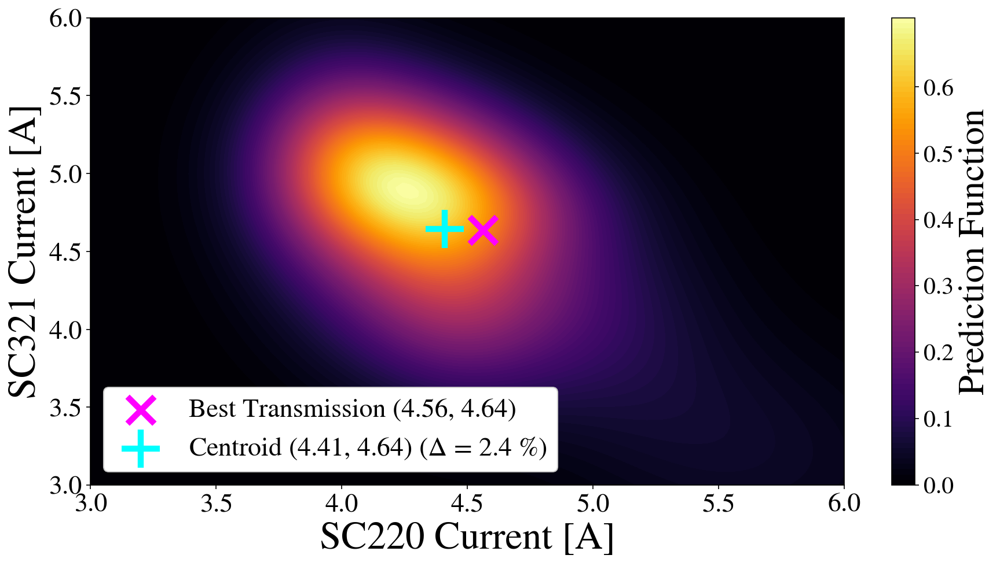

In [48]:
from matplotlib import ticker, cm

fig, ax = plt.subplots(1,1, figsize = (14,7))
fig.set_dpi(150)

cf = ax.contourf(X,Y,Z/len(icompall), levels = 100, cmap = 'inferno')

centx = np.average(X, weights = Z)
centy = np.average(Y, weights = Z)

exp = [4.562,4.637]
ax.scatter(exp[0],exp[1], marker = 'x', c = 'fuchsia', s = 500, linewidths = 5, 
           label = 'Best Transmission (%.2f, %.2f)'%(exp[0],exp[1]))

delta = np.sqrt((centx-exp[0])**2+(centy-exp[1])**2)/(np.sqrt(exp[0]**2+exp[1]**2))
ax.scatter(centx,centy, marker = '+', c = 'cyan', s = 1000, linewidths = 5, 
           label = r'Centroid (%.2f, %.2f) ($\Delta$ = %.1f %%)'%(centx,centy,delta*100))

ax.legend(loc = 'lower left', fontsize = 22, framealpha = 1)

ax.tick_params(axis='x', labelsize = 22)
ax.tick_params(axis='y', labelsize = 22)
#ax.set_title(r'%s'%element, fontsize = 24)
ax.set_xlabel(r'SC220 Current [A]', fontsize = 32)
ax.set_ylabel(r'SC321 Current [A]', fontsize = 32)
ax.set_facecolor('black')
cbar=plt.colorbar(cf)
cbar.ax.set_ylabel('Prediction Function', fontsize = 30)
cbar.ax.tick_params(axis='y',labelsize = 20)
cbar.ax.set_yticks(np.arange(0,0.7,0.1))
#cbar.set_label(r' Compensation Current Count', fontsize = 22)
plt.show()
plt.close()

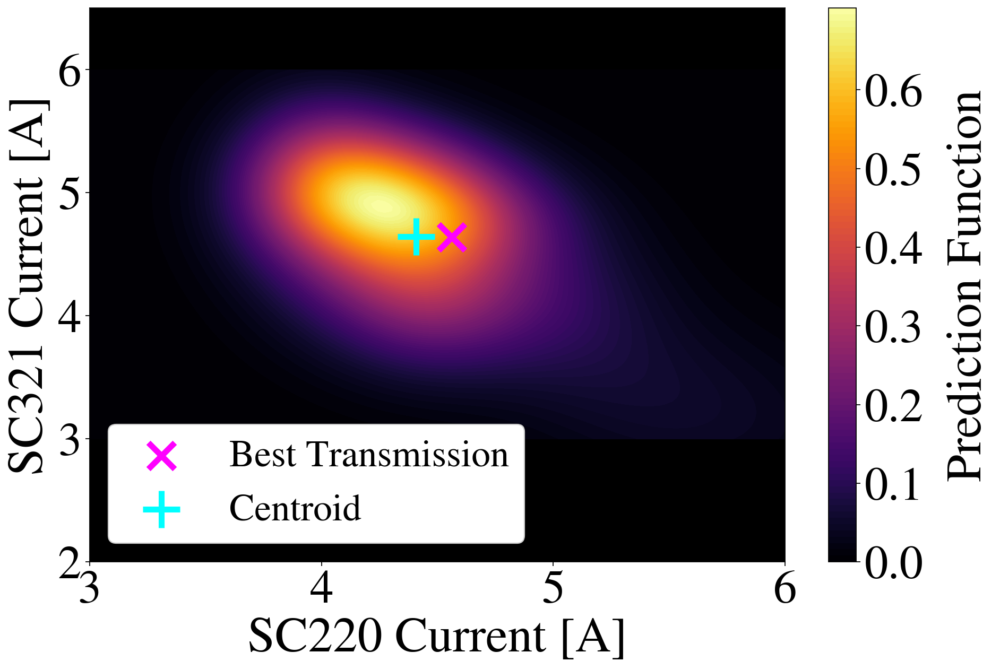

In [59]:
from matplotlib import ticker, cm

fig, ax = plt.subplots(1,1, figsize = (12,8))
fig.set_dpi(160)

cf = ax.contourf(X,Y,Z/len(icompall), levels = 100, cmap = 'inferno')

centx = np.average(X, weights = Z)
centy = np.average(Y, weights = Z)

exp = [4.562,4.637]
ax.scatter(exp[0],exp[1], marker = 'x', c = 'fuchsia', s = 500, linewidths = 5, 
           label = 'Best Transmission')

delta = np.sqrt((centx-exp[0])**2+(centy-exp[1])**2)/(np.sqrt(exp[0]**2+exp[1]**2))
ax.scatter(centx,centy, marker = '+', c = 'cyan', s = 1000, linewidths = 5, 
           label = r'Centroid')

ax.legend(loc = 'lower left', fontsize = 32, framealpha = 1)

ax.set_ylim(2,6.5)
# ax.set_ylim(2,6)

ax.tick_params(axis='x', labelsize = 40)
ax.tick_params(axis='y', labelsize = 40)
#ax.set_title(r'%s'%element, fontsize = 24)
ax.set_xlabel(r'SC220 Current [A]', fontsize = 42)
ax.set_ylabel(r'SC321 Current [A]', fontsize = 42)
ax.set_facecolor('black')
cbar=plt.colorbar(cf)
cbar.ax.set_ylabel('Prediction Function', fontsize = 42,labelpad=20)
cbar.ax.tick_params(axis='y',labelsize = 40)
cbar.ax.set_yticks(np.arange(0,0.7,0.1))
#cbar.set_label(r' Compensation Current Count', fontsize = 22)
plt.tight_layout()
plt.savefig('comp_interval.pdf')
plt.show()
plt.close()

In [18]:
'sc319'.upper()

'SC319'

In [7]:
bpmstoanalyze

array(['R:HP100', 'R:HP102', 'R:HP104', 'R:HP106', 'R:HP108', 'R:HP110',
       'R:HP112', 'R:HP114', 'R:HP116', 'R:HP118', 'R:HP120', 'R:HP122',
       'R:HP124', 'R:HP126', 'R:HP128', 'R:HP130', 'R:HP202', 'R:HP204',
       'R:HP206', 'R:HP208', 'R:HP210', 'R:HP212', 'R:HP214', 'R:HP216',
       'R:HP218', 'R:HP220', 'R:HP222', 'R:HP224', 'R:HP226', 'R:HP228',
       'R:HP230', 'R:HP232', 'R:HP302', 'R:HP304', 'R:HP306', 'R:HP308',
       'R:HP310', 'R:HP312', 'R:HP314', 'R:HP316', 'R:HP318', 'R:HP320',
       'R:HP322', 'R:HP324', 'R:HP326', 'R:HP328', 'R:HP330', 'R:HP332',
       'R:HP334', 'R:HP336', 'R:HP338', 'R:HP340', 'R:HP400', 'R:HP402',
       'R:HP404', 'R:HP406', 'R:HP408', 'R:HP410', 'R:HP412', 'R:HP414',
       'R:HP416', 'R:HP418', 'R:HP420', 'R:HP422', 'R:HP424', 'R:HP426',
       'R:HP428', 'R:HP430', 'R:HP502', 'R:HP504', 'R:HP506', 'R:HP508',
       'R:HP510', 'R:HP512', 'R:HP514', 'R:HP516', 'R:HP518', 'R:HP520',
       'R:HP522', 'R:HP524', 'R:HP526', 'R:HP528', 

2.3719322591952885
1.5112956669400404 0.3778239167350101 4
2.3719322591952885
1.3220002417659789 0.3305000604414947 4


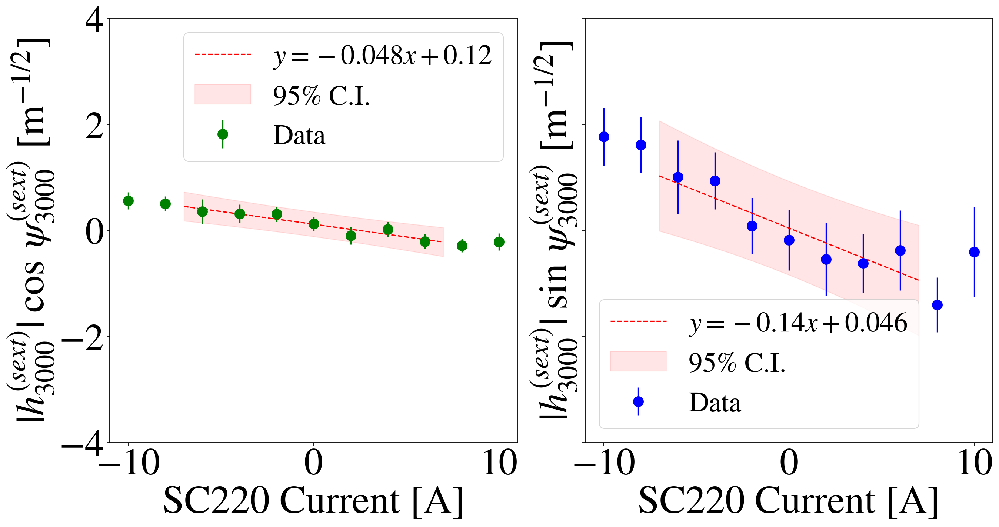

2.3719322591952885
1.3321900127691972 0.3330475031922993 4
2.3719322591952885
1.0881834098368774 0.27204585245921936 4


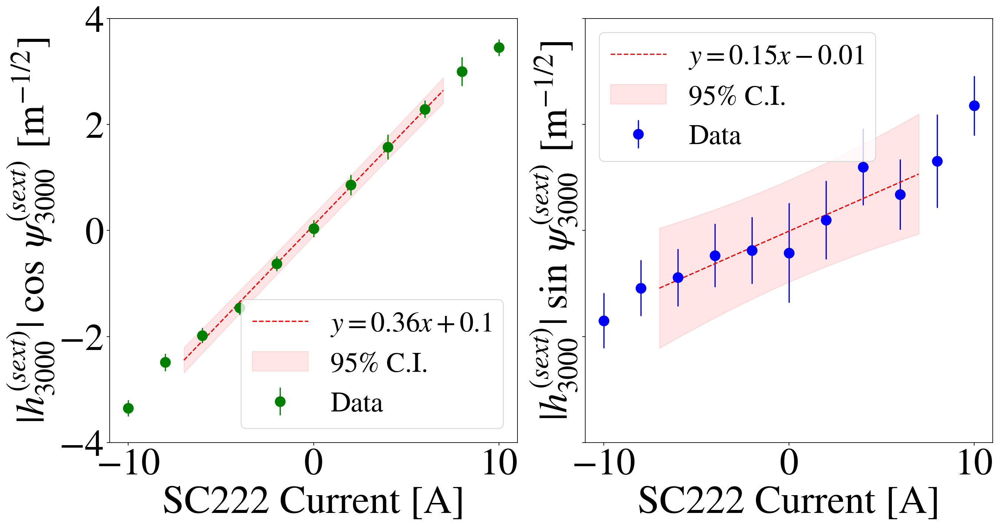

2.3719322591952885
3.600623071249091 0.9001557678122728 4
2.3719322591952885
0.6910720553685408 0.1727680138421352 4


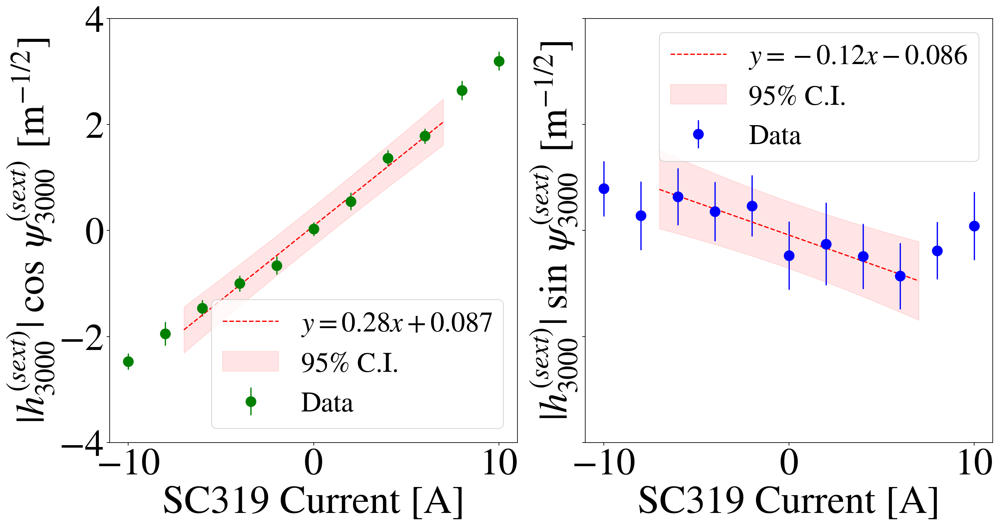

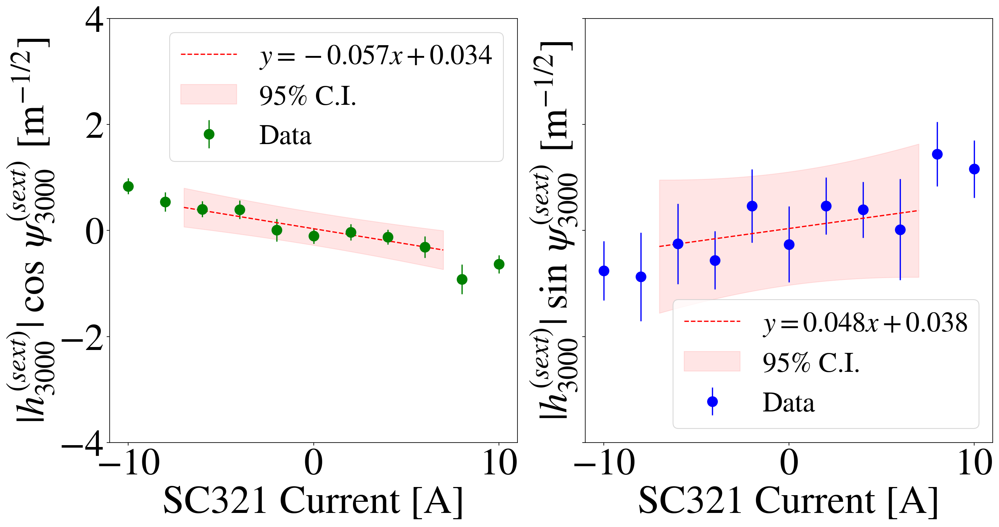

In [42]:
for bpmi in ['R:HP126']:
    
    for sc in folders:
        
        dfplot = hsext[(hsext['sext'] == sc) & (hsext['bpm'] == bpmi)]
        currents = np.unique(dfplot['sext-current'])
        currentsfull = np.unique(dfplot['sext-current'])
        
        currlimlow = -7
        currlimhigh = 7
        currents = currentsfull[[i<currlimhigh for i in currentsfull]]
        currents = currents[[i>currlimlow for i in currents]]
        
        maski = [(i<currlimhigh)*(i>currlimlow) for i in currentsfull]
        
        # Start of plots
        # -----------------------------------------------------------------------------
        # -----------------------------------------------------------------------------
        
        fig,(ax1,ax2) = plt.subplots(1,2, figsize=(17,9), sharey = True)
        fig.set_dpi(160)
        
        # Plot for real part of sextupole kick
        ax1.errorbar(currentsfull, 1000*dfplot['real'], yerr = 1000*np.divide(dfplot['real-std'],np.sqrt(dfplot['vectors'])), 
                     fmt = 'o', color = 'green', label = 'Data',markersize = 12)
        
        # Calculate R2 of regression
        xdata1 = np.array(currents).reshape(-1,1)
        ydata1 = dfplot[maski]['real']
        
        reg1 = LinearRegression().fit(xdata1,ydata1)
        xplot1 = np.linspace(min(currents)-1,max(currents)+1).reshape(-1,1) 
        r2score1 = reg1.score(xdata1, ydata1)
        
        # Calculate Chi2 of linear regression
        chi2_1, redchi2_1, nu1 = chisquare_var(yobs = ydata1, yfit = reg1.predict(xdata1), 
                                        syvar = np.divide(dfplot['real-std'],np.sqrt(dfplot['vectors'])), 
                                        fitted_params = 2)
        
        alpha = 0.05
        
        redchi2alpha1 = chi2.ppf(1-alpha,nu1)/nu1
        #print(chi2.ppf(1-alpha,nu1)/nu1)
        #print(chi2_1, redchi2_1, nu1)
        
        # Plot data and linear regression
        # ax1.plot(xplot1, 1000*reg1.predict(xplot1), color = 'red', linestyle = 'dashed', 
        #          label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg1.coef_,1000*reg1.intercept_, r2score1, redchi2_1))

        ax1.plot(xplot1, 1000*reg1.predict(xplot1), color = 'red', linestyle = 'dashed', 
                 label = (f'$y = %.2g x %+.2g $')%(1000*reg1.coef_[0],1000*reg1.intercept_))
        
        
        # OLS Regression 1
        xdata1 = sm.add_constant(xdata1)
        model1 = sm.OLS(ydata1, xdata1)
        results1 = model1.fit()
        ypredict1 = results1.get_prediction(sm.add_constant(xplot1))
        yplot1 = ypredict1.predicted_mean
        yplotlow1 = ypredict1.summary_frame()["obs_ci_lower"]
        yplothigh1 = ypredict1.summary_frame()["obs_ci_upper"]
        
        
        #ax1.plot(xplot1, 1000*yplot1, color = 'red', linestyle = 'dashed')
        ax1.fill_between(xplot1.reshape(1,-1)[0], 1000*yplotlow1, 1000*yplothigh1, color = 'red', alpha = 0.1, 
                         label = '95% C.I.')
        #ax1.plot(xplot1, yplotlow1, color = 'red', linestyle = 'dashed')
        #ax1.plot(xplot1, yplothigh1, color = 'red', linestyle = 'dashed')
        
        
        #model.predict
        ax1.set_ylim(-4,4)
        
        ax1.tick_params(axis='x', labelsize = 46)
        ax1.tick_params(axis='y', labelsize = 46)
        # ax1.set_title('Sextupole kick for %s'%bpmi, fontsize = 42)
        ax1.set_ylabel(r'$|h^{(sext)}_{3000}| \; \cos \; \psi^{(sext)}_{3000} $ [m$^{-1/2}$]', fontsize = 48)
        ax1.set_xlabel(sc.upper()+ ' Current [A]', fontsize = 48)
        ax1.legend(fontsize = 34)
        
        # -----------------------------------------------------------------------------
        
        # Plot for imaginary part of sextupole kick
        ax2.errorbar(currentsfull, 1000*dfplot['imag'], yerr =  1000*np.divide(dfplot['imag-std'],np.sqrt(dfplot['vectors'])), 
                     fmt = 'o', color = 'blue', label = 'Data',markersize = 12)
        
        xdata2 = np.array(currents).reshape(-1,1)
        ydata2 = dfplot[maski]['imag']
        reg2 = LinearRegression().fit(xdata2,ydata2)
        xplot2 = np.linspace(min(currents)-1,max(currents)+1).reshape(-1,1)
        r2score2 = reg2.score(xdata2, ydata2)
        
        # Calculate Chi2 of linear regression
        chi2_2, redchi2_2, nu2 = chisquare_var(yobs = ydata2, yfit = reg2.predict(xdata2), 
                                        syvar = np.divide(dfplot['imag-std'],np.sqrt(dfplot['vectors'])), 
                                        fitted_params = 2)
        
        redchi2alpha2 = chi2.ppf(1-alpha,nu2)/nu2
        #print(chi2.ppf(1-alpha,nu2)/nu2)
        #print(chi2_2, redchi2_2, nu2)
        
        # ax2.plot(xplot2, 1000*reg2.predict(xplot2), color = 'red', linestyle = 'dashed', 
        #          label = (f'$y = %.2g x %+.2g $ \n'+r'($R^2 = %.2f, \chi^2/\nu = %.2f$)')%(1000*reg2.coef_,1000*reg2.intercept_, r2score2, redchi2_2))

        ax2.plot(xplot2, 1000*reg2.predict(xplot2), color = 'red', linestyle = 'dashed', 
                 label = (f'$y = %.2g x %+.2g $')%(1000*reg2.coef_[0],1000*reg2.intercept_))
        
        
        # OLS Regression 2
        xdata2 = sm.add_constant(xdata2)
        model2 = sm.OLS(ydata2, xdata2)
        results2 = model2.fit()
        ypredict2 = results2.get_prediction(sm.add_constant(xplot2))
        yplot2 = ypredict2.predicted_mean
        yplotlow2 = ypredict2.summary_frame()["obs_ci_lower"]
        yplothigh2 = ypredict2.summary_frame()["obs_ci_upper"]
        
        #ax2.plot(xplot2, 1000*yplot2, color = 'red', linestyle = 'dashed')
        ax2.fill_between(xplot2.reshape(1,-1)[0], 1000*yplotlow2, 1000*yplothigh2, color = 'red', alpha = 0.1, 
                         label = '95% C.I.')
        
        
        ax2.tick_params(axis='x', labelsize = 46)
        ax2.tick_params(axis='y', labelsize = 46)
        # ax2.set_title('Sextupole kick for %s'%bpmi, fontsize = 42)
        ax2.set_ylabel(r'$|h^{(sext)}_{3000}| \; \sin \; \psi^{(sext)}_{3000} $ [m$^{-1/2}$]', fontsize = 48)
        ax2.set_xlabel(sc.upper()+ ' Current [A]', fontsize = 48)
        ax2.legend(fontsize = 34)
        
        # try:
        #     os.makedirs(sc+'/hsext-vs-I')
        # except:
        #     #print('Directory already exists')
        #     pass
        
        # fig.patch.set_facecolor('white')
        # plt.subplots_adjust(hspace=0.5)
        plt.tight_layout()
        
        if (redchi2_1<redchi2alpha1) and (redchi2_2<redchi2alpha2):
            if (r2score1>0.8) and (r2score2>0.8):
                    print(chi2.ppf(1-alpha,nu1)/nu1)
                    print(chi2_1, redchi2_1, nu1)
                    
                    print(chi2.ppf(1-alpha,nu2)/nu2)
                    print(chi2_2, redchi2_2, nu2)
                    
                    #i = i+1
                    #plt.show()
        plt.savefig('%s_%s.pdf'%(sc,bpmi[2:]))
        plt.show()
        #if bpmi=='R:HP622':
            #plt.show()
            #plt.savefig(sc+'/hsext-vs-I/hsext-vs-I-%s-%s'%(sc,bpmi[-5:]))
            
        #plt.savefig(sc+'/hsext-vs-I/hsext-vs-I-%s-%s'%(sc,bpmi[-5:]))
        plt.close()
        
        #break
    #break

In [32]:
reg1.intercept_

np.float64(0.00011952062737127964)

[ 4.08967722 -4.08967722 -5.08812043  5.08812043]
[0.31447988 0.31447988 0.37427584 0.37427584]
[ 4.13702429 -4.13702429 -5.00795043  5.00795043]
[0.2948872  0.2948872  0.39095886 0.39095886]
[ 3.98354884 -3.98354884 -5.09118456  5.09118456]
[0.23440843 0.23440843 0.34762716 0.34762716]
[ 4.08517531 -4.08517531 -5.03903179  5.03903179]
[0.27125631 0.27125631 0.36668188 0.36668188]
[ 4.09836605 -4.09836605 -4.83930514  4.83930514]
[0.30373358 0.30373358 0.45363373 0.45363373]
[ 4.0462385  -4.0462385  -4.78191692  4.78191692]
[0.26982497 0.26982497 0.37018912 0.37018912]
[ 4.20741185 -4.20741185 -4.312687    4.312687  ]
[0.31503717 0.31503717 0.4117131  0.4117131 ]
[ 4.46736397 -4.46736397 -4.17274603  4.17274603]
[0.24634925 0.24634925 0.43751591 0.43751591]
[ 4.34787947 -4.34787947 -4.35680348  4.35680348]
[0.34295465 0.34295465 0.47571234 0.47571234]
[ 4.34954162 -4.34954162 -4.36674584  4.36674584]
[0.35566728 0.35566728 0.45927287 0.45927287]
[ 4.82355747 -4.82355747 -4.3098275   4.

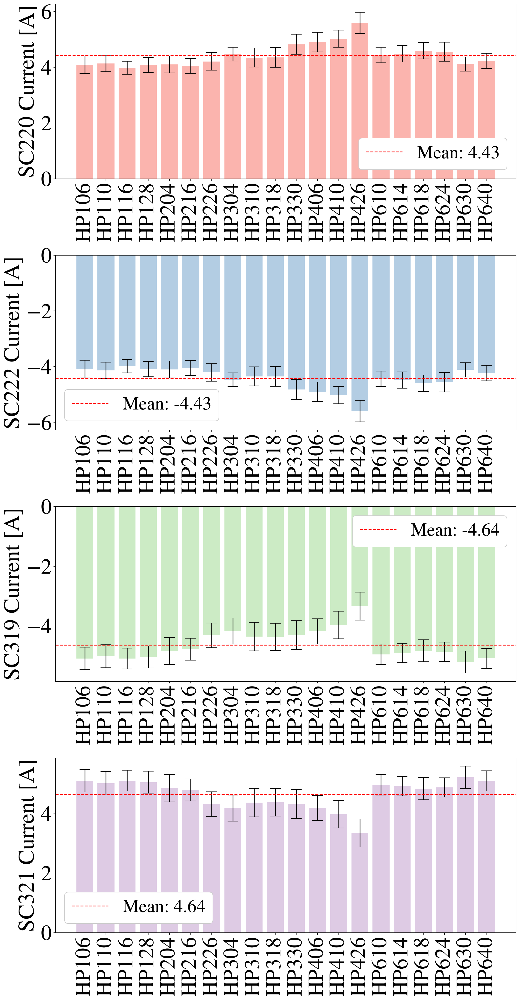

In [76]:
icompall = []
sigmaicompall = []
icompgood = []
bpmgood = []
bestr2 = 7.5

fig,(ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(14,26))

fig.set_dpi(160)

upper_limit = 7
lower_limit =-7

fint = True

for bpmi in worthy[::2]:

    # Create bare machine results and matrix to be solved for 
    dfbare0 = h3000bare[(h3000bare['sext-current'] == 0) & (h3000bare['bpm'] == bpmi)]
    #dfbare0 = hsext[(hsext['sext-current'] == 0) & (hsext['bpm'] == bpmi)]
    hampbare = np.mean(dfbare0['amplitude'])
    hampstd = np.array(dfbare0['amplitude-std'])[0]
    hphasebare = circmean(dfbare0['phase'])
    hphasestd = np.array(dfbare0['phase-std'])[0]
    
    hvec = np.array([-hampbare*np.cos(hphasebare), -hampbare*np.sin(hphasebare), 0, 0])
    
    # Error propagation for bare vector
    sxh21 = np.square(np.multiply(np.cos(hphasebare),hampstd))
    sxh22 = np.square(np.multiply(hampbare, np.multiply(np.sin(hphasebare), hphasestd)))
    
    syh21 = np.square(np.multiply(np.sin(hphasebare),hampstd))
    syh22 = np.square(np.multiply(hampbare, np.multiply(np.cos(hphasebare), hphasestd)))
    
    nn = np.array(dfbare0['vectors'])[0]
    
    sigmahvec = np.array([np.sqrt(sxh21+sxh22)/np.sqrt(nn),
                          np.sqrt(syh21+syh22)/np.sqrt(nn),
                          0,
                          0])
    
    mmatrix = np.zeros((4,4))
    mmatrix[2,0] = 1
    mmatrix[2,1] = 1
    mmatrix[3,2] = 1
    mmatrix[3,3] = 1
    
    deltam = np.zeros((4,4))
    
    for sc in folders:
        
        # Calculate linear regressions for real and imaginary part
        dfplot = hsext[(hsext['sext'] == sc) & (hsext['bpm'] == bpmi)]        
        
        #-----------------------------------------------------------
        dffit1 = dfplot[(dfplot['sext-current']<upper_limit) & (dfplot['sext-current']>lower_limit)]
        
        xdata1 = np.array(dffit1['sext-current']).reshape(-1,1)
        
        ydata1 = np.multiply(dffit1['amplitude'],np.cos(dffit1['phase']))
        sydata1 = np.divide(dffit1['real-std'],np.sqrt(dffit1['vectors']))
        
        reg1 = LinearRegression(fit_intercept = fint).fit(xdata1,ydata1)
    
        # OLS Regression 1
        xdata1 = sm.add_constant(xdata1)
        model1 = sm.OLS(ydata1, xdata1)
        results1 = model1.fit()
        
        deltamij1 = np.abs(results1.conf_int(alpha=0.05)[0]['x1'] - results1.conf_int(alpha=0.05)[1]['x1'])/(2*1.96) 
    
        #--------------------------------------------------------
        dffit2 = dfplot[(dfplot['sext-current']<upper_limit) & (dfplot['sext-current']>lower_limit)]
        
        xdata2 = np.array(dffit2['sext-current']).reshape(-1,1)
        
        ydata2 = np.multiply(dffit2['amplitude'],np.sin(dffit2['phase']))
        sydata2 = np.divide(dffit2['imag-std'],np.sqrt(dffit2['vectors']))
        
        reg2 = LinearRegression(fit_intercept = fint).fit(xdata2,ydata2)

        # OLS Regression 2
        xdata2 = sm.add_constant(xdata2)
        model2 = sm.OLS(ydata2, xdata2)
        results2 = model2.fit()
        
        deltamij2 = np.abs(results2.conf_int(alpha=0.05)[0]['x1'] - results2.conf_int(alpha=0.05)[1]['x1'])/(2*1.96)
        
        #-----------------------------------------------------------
        hvec = hvec #- np.array([1.*reg1.intercept_,1.*reg2.intercept_,0,0])
        
        if sc=='sc220':
            mmatrix[0,0] = reg1.coef_[0]
            mmatrix[1,0] = reg2.coef_[0]
            
            deltam[0,0] = deltamij1
            deltam[1,0] = deltamij2
            
        elif sc=='sc222':
            mmatrix[0,1] = reg1.coef_[0]
            mmatrix[1,1] = reg2.coef_[0]
            
            deltam[0,1] = deltamij1
            deltam[1,1] = deltamij2
           
        elif sc=='sc319':
            mmatrix[0,2] = reg1.coef_[0]
            mmatrix[1,2] = reg2.coef_[0]
            
            deltam[0,2] = deltamij1
            deltam[1,2] = deltamij2
              
        elif sc=='sc321':
            mmatrix[0,3] = reg1.coef_[0]
            mmatrix[1,3] = reg2.coef_[0]
            
            deltam[0,3] = deltamij1
            deltam[1,3] = deltamij2
            
    mmatrixinv = np.linalg.inv(mmatrix)
    sigmamatrixinv = np.sqrt(np.square(mmatrixinv @ deltam @ mmatrixinv))
    #print(sigmamatrixinv)
    
    icompi = mmatrixinv.dot(hvec)
    icompall.append(icompi)
    print(icompi)
    
    term1 = np.array([np.square(mmatrixinv)[i,:].dot(np.square(sigmahvec)) for i in np.arange(len(hvec))])
    term2 = np.array([np.square(hvec).dot(np.square(sigmamatrixinv)[i,:]) for i in np.arange(len(hvec))])
    sigmaicompi = np.sqrt(term1+term2)
    sigmaicompall.append(sigmaicompi)
    print(sigmaicompi)
    
    
    ax1.bar(bpmi[2:], icompi[0], yerr=sigmaicompi[0], color=plt.cm.Pastel1(0), align="center", capsize=10)
    ax2.bar(bpmi[2:], icompi[1], yerr=sigmaicompi[1], color=plt.cm.Pastel1(1), align="center", capsize=10)
    ax3.bar(bpmi[2:], icompi[2], yerr=sigmaicompi[2], color=plt.cm.Pastel1(2), align="center", capsize=10)
    ax4.bar(bpmi[2:], icompi[3], yerr=sigmaicompi[3], color=plt.cm.Pastel1(3), align="center", capsize=10)
    
    
icompall = np.array(icompall)  

ax1.axhline(np.mean(icompall[:,0]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,0]))
ax2.axhline(np.mean(icompall[:,1]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,1]))
ax3.axhline(np.mean(icompall[:,2]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,2]))
ax4.axhline(np.mean(icompall[:,3]), color = 'red', linestyle = 'dashed', label = 'Mean: %.2f'%np.mean(icompall[:,3]))

ax1.legend(fontsize = 34, loc = 4, framealpha = 1)
ax1.tick_params(axis='x', labelrotation=90, labelsize = 40)
ax1.tick_params(axis='y', labelsize = 40)
ax1.set_facecolor('white')
# ax1.set_title('Compensation currents for SC220 calculated at each other BPM', fontsize = 42)
ax1.set_ylabel('SC220 Current [A]',fontsize=42)
#ax1.set_ylim(0,)
#ax1.set_xlim(-1,len(bpmstoanalyze))

ax2.legend(fontsize = 34, framealpha = 1)
# ax2.set_title('Compensation currents for SC222 calculated at each other BPM', fontsize = 42) 
ax2.set_ylabel('SC222 Current [A]',fontsize=42)
ax2.tick_params(axis='x', labelrotation=90, labelsize = 40)
ax2.tick_params(axis='y', labelsize = 40)
#ax2.set_xlim(-1,len(bpmstoanalyze))

ax3.legend(fontsize = 34, framealpha = 1)
# ax3.set_title('Compensation currents for SC319 calculated at each other BPM', fontsize = 42) 
ax3.set_ylabel('SC319 Current [A]',fontsize=42)
ax3.tick_params(axis='x', labelrotation=90, labelsize = 40)
ax3.tick_params(axis='y', labelsize = 40)
#ax3.set_xlim(-1,len(bpmstoanalyze))

ax4.legend(fontsize = 34, framealpha = 1)
# ax4.set_title('Compensation currents for SC321 calculated at each other BPM', fontsize = 42) 
ax4.set_ylabel('SC321 Current [A]',fontsize=42)
ax4.tick_params(axis='x', labelrotation=90, labelsize = 40)
ax4.tick_params(axis='y', labelsize = 40)
#ax4.set_xlim(-1,len(bpmstoanalyze))

# fig.patch.set_facecolor('white')
plt.tight_layout()

plt.savefig('comp_currents.pdf')
plt.show()
plt.close()